# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [2]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Extracting mnist: 100%|██████████| 60.0K/60.0K [00:10<00:00, 5.59KFile/s]

Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

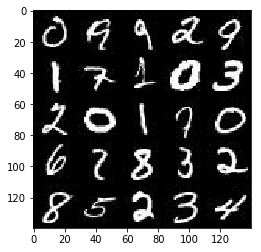

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

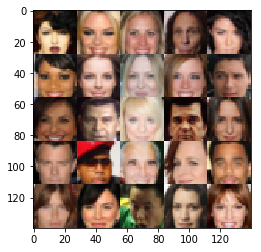

In [4]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [5]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.0.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [6]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    # Here we create placeholders for real input images (inputs_real), tenzor of z data (inputs_z) and learning rate(lr)
    inputs_real = tf.placeholder(tf.float32, 
                                 shape=[None,image_width, image_height,image_channels], 
                                 name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    lr = tf.placeholder(tf.float32)
    
    return inputs_real, inputs_z, lr


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the generator, tensor logits of the generator).

In [34]:
#declare global var alpha with default value (then we can modify it during hyperparameters tuning)
#we need it to use leak relu
alpha =0.1

def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param image: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 28x28x1/3
        x1 = tf.layers.conv2d(images, 56, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 14x14x32
        
        x2 = tf.layers.conv2d(relu1, 112, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 7x7x128
        

        # Flatten it
        flat = tf.reshape(relu2, (-1, 7*7*128))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
    
    return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [35]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    
    with tf.variable_scope('generator', reuse=not is_train):
        # First fully connected layer
        x1 = tf.layers.dense(z, 7*7*256)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 7, 7, 256))
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = tf.maximum(alpha * x1, x1)
        # 7x7x256 now
        
        x2 = tf.layers.conv2d_transpose(x1, 128, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = tf.maximum(alpha * x2, x2)
        # 14x14x128 now
        
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x2, out_channel_dim, 5, strides=2, padding='same')
        # 28x28x1/3 out_channel_dim now
        
        out = tf.tanh(logits)
    
    return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [36]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    
    g_model = generator(input_z, out_channel_dim)
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [37]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
    g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [38]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [39]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    
    #initialize global variables
    show_every=100
    sample_z = np.random.uniform(-1, 1, size=(50, z_dim))
    samples, losses = [], []
    steps = 0
    
    # Call inputs
    input_real, input_z, lr = model_inputs(data_shape[1], data_shape[2], 
                                                      data_shape[3], z_dim)

    # Call Loss
    d_loss, g_loss = model_loss(input_real, input_z, data_shape[3])

    # call Optimizers
    d_opt, g_opt = model_opt(d_loss, g_loss, lr, beta1)
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                steps += 1
                
                # rescale from (-0.5, 0.5) to (-1., 1.)
                n_batch_images = 2 * np.array(batch_images, np.float32)
                
                
                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))

                # Run optimizers
                _ = sess.run(d_opt, feed_dict={input_real: n_batch_images, 
                                               input_z: batch_z, 
                                               lr: learning_rate})
                _ = sess.run(g_opt, feed_dict={input_z: batch_z, input_real: n_batch_images, lr:learning_rate})

                #Show statistic and results
                if steps % show_every == 0:
                    show_generator_output(sess, show_n_images, input_z, data_shape[3], data_image_mode)
                    
                    train_loss_d = d_loss.eval({input_z: batch_z, input_real: n_batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_z})

                    print("Epoch {}/{}, batch {}...".format(epoch_i + 1, epochs, steps),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g)) 
                

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

**Here we try the different combinations of hyperparameters and select top that provide more realistic datasets** 

batch_size is 64, beta1 is 0.1, alpha is 0.1,learning_rate is 0.0001


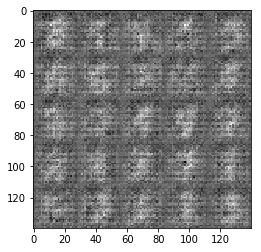

Epoch 1/2, batch 100... Discriminator Loss: 0.6912... Generator Loss: 0.9365


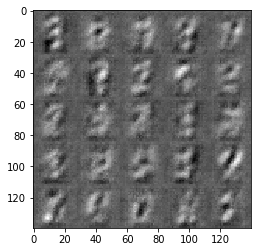

Epoch 1/2, batch 200... Discriminator Loss: 0.9490... Generator Loss: 1.3656


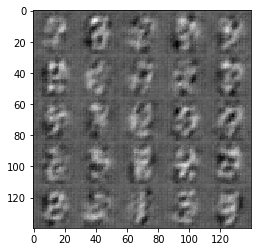

Epoch 1/2, batch 300... Discriminator Loss: 1.0826... Generator Loss: 0.6843


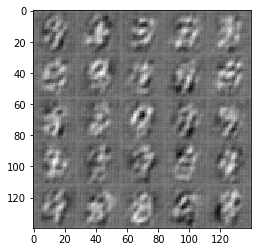

Epoch 1/2, batch 400... Discriminator Loss: 1.0139... Generator Loss: 0.9341


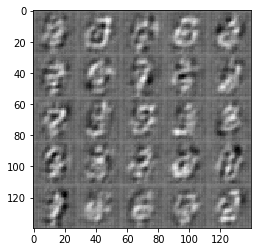

Epoch 1/2, batch 500... Discriminator Loss: 1.0680... Generator Loss: 1.4223


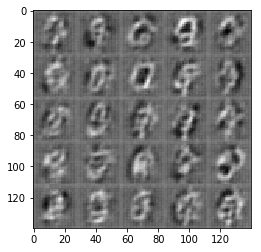

Epoch 1/2, batch 600... Discriminator Loss: 1.0443... Generator Loss: 0.7325


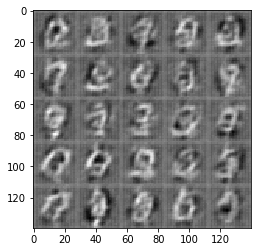

Epoch 1/2, batch 700... Discriminator Loss: 1.0021... Generator Loss: 0.7908


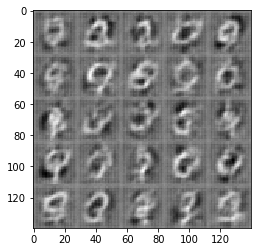

Epoch 1/2, batch 800... Discriminator Loss: 1.0476... Generator Loss: 1.1933


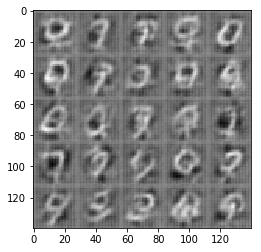

Epoch 1/2, batch 900... Discriminator Loss: 1.1615... Generator Loss: 0.5982


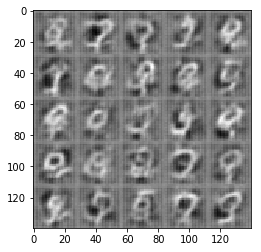

Epoch 2/2, batch 1000... Discriminator Loss: 1.3723... Generator Loss: 0.3686


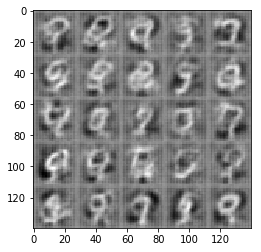

Epoch 2/2, batch 1100... Discriminator Loss: 0.9879... Generator Loss: 1.2614


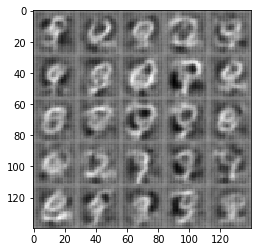

Epoch 2/2, batch 1200... Discriminator Loss: 0.9538... Generator Loss: 1.0087


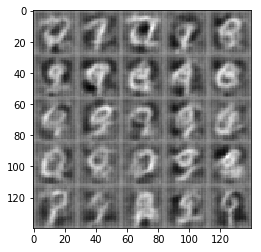

Epoch 2/2, batch 1300... Discriminator Loss: 1.0277... Generator Loss: 0.9272


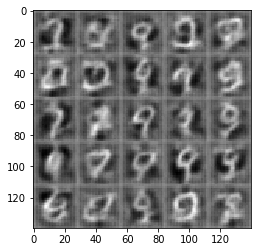

Epoch 2/2, batch 1400... Discriminator Loss: 1.0727... Generator Loss: 0.6201


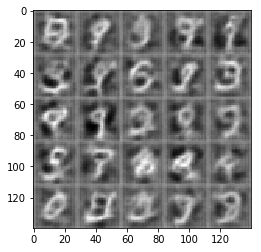

Epoch 2/2, batch 1500... Discriminator Loss: 1.0527... Generator Loss: 0.6260


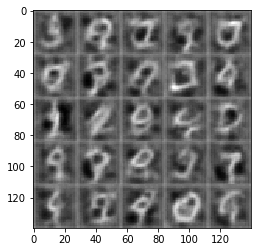

Epoch 2/2, batch 1600... Discriminator Loss: 1.0147... Generator Loss: 0.7400


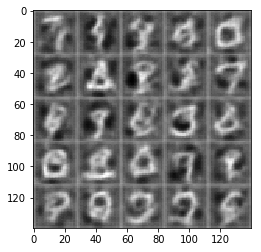

Epoch 2/2, batch 1700... Discriminator Loss: 0.9660... Generator Loss: 0.9602


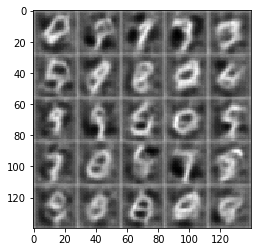

Epoch 2/2, batch 1800... Discriminator Loss: 0.9629... Generator Loss: 0.9782
batch_size is 64, beta1 is 0.1, alpha is 0.1,learning_rate is 0.0005


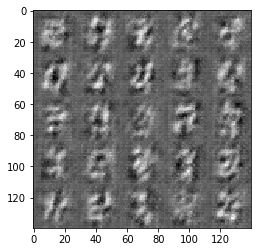

Epoch 1/2, batch 100... Discriminator Loss: 1.6706... Generator Loss: 0.7111


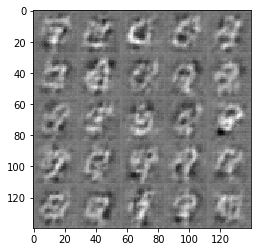

Epoch 1/2, batch 200... Discriminator Loss: 1.3867... Generator Loss: 0.8932


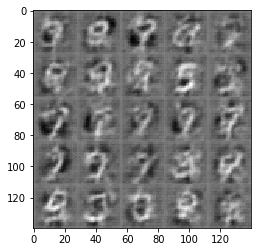

Epoch 1/2, batch 300... Discriminator Loss: 1.3016... Generator Loss: 0.7118


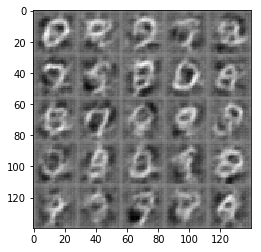

Epoch 1/2, batch 400... Discriminator Loss: 1.2815... Generator Loss: 0.9987


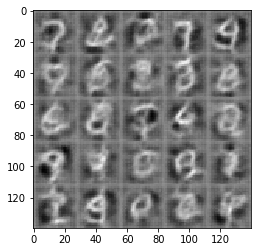

Epoch 1/2, batch 500... Discriminator Loss: 1.3110... Generator Loss: 1.0309


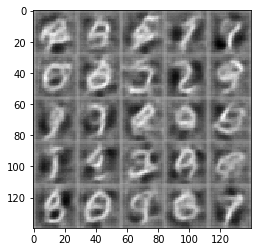

Epoch 1/2, batch 600... Discriminator Loss: 1.3747... Generator Loss: 1.0752


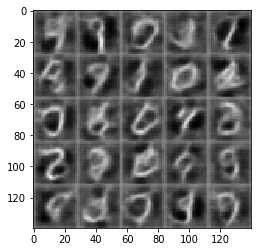

Epoch 1/2, batch 700... Discriminator Loss: 1.8111... Generator Loss: 1.6368


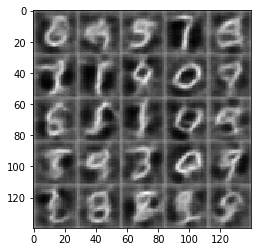

Epoch 1/2, batch 800... Discriminator Loss: 1.4122... Generator Loss: 0.3982


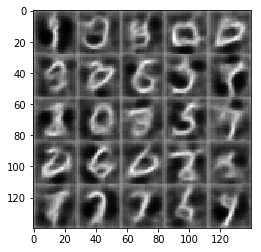

Epoch 1/2, batch 900... Discriminator Loss: 1.2351... Generator Loss: 0.8477


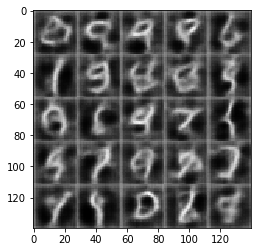

Epoch 2/2, batch 1000... Discriminator Loss: 1.2132... Generator Loss: 0.6255


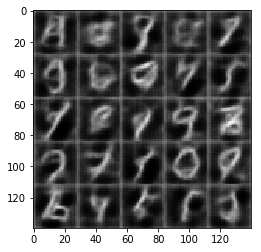

Epoch 2/2, batch 1100... Discriminator Loss: 1.1543... Generator Loss: 1.0435


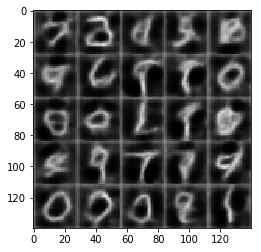

Epoch 2/2, batch 1200... Discriminator Loss: 1.3636... Generator Loss: 0.4557


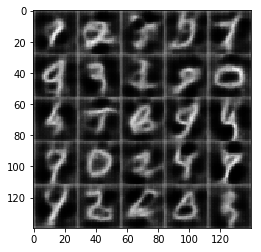

Epoch 2/2, batch 1300... Discriminator Loss: 1.2810... Generator Loss: 0.4694


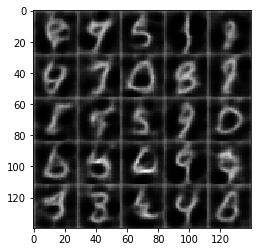

Epoch 2/2, batch 1400... Discriminator Loss: 1.2471... Generator Loss: 1.4769


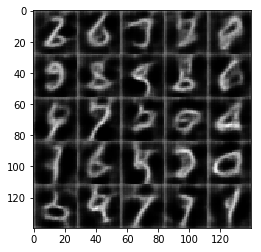

Epoch 2/2, batch 1500... Discriminator Loss: 1.0911... Generator Loss: 1.3546


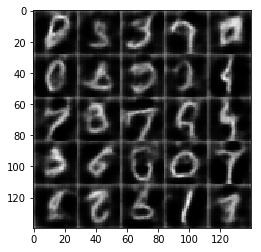

Epoch 2/2, batch 1600... Discriminator Loss: 1.8465... Generator Loss: 0.2183


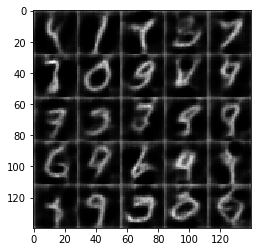

Epoch 2/2, batch 1700... Discriminator Loss: 1.0115... Generator Loss: 0.7803


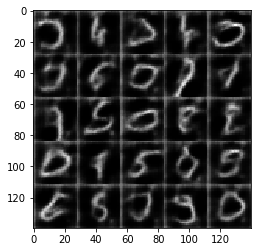

Epoch 2/2, batch 1800... Discriminator Loss: 1.3018... Generator Loss: 0.4381
batch_size is 64, beta1 is 0.1, alpha is 0.1,learning_rate is 0.001


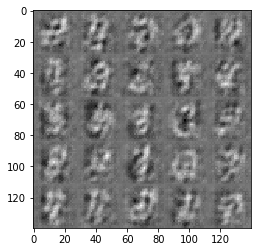

Epoch 1/2, batch 100... Discriminator Loss: 1.8494... Generator Loss: 0.7517


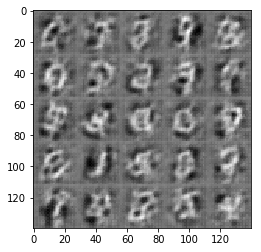

Epoch 1/2, batch 200... Discriminator Loss: 1.3822... Generator Loss: 0.8088


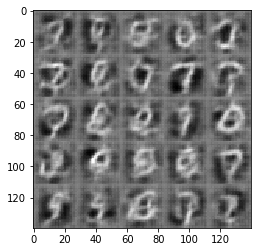

Epoch 1/2, batch 300... Discriminator Loss: 1.5943... Generator Loss: 0.3035


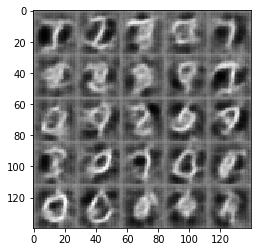

Epoch 1/2, batch 400... Discriminator Loss: 1.5832... Generator Loss: 0.3046


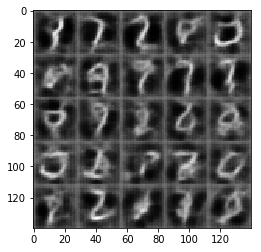

Epoch 1/2, batch 500... Discriminator Loss: 1.3069... Generator Loss: 1.0742


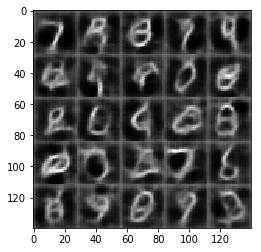

Epoch 1/2, batch 600... Discriminator Loss: 1.2544... Generator Loss: 0.8568


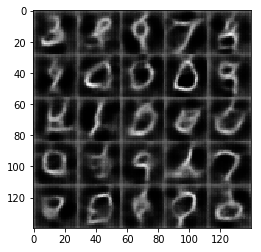

Epoch 1/2, batch 700... Discriminator Loss: 1.3314... Generator Loss: 1.0163


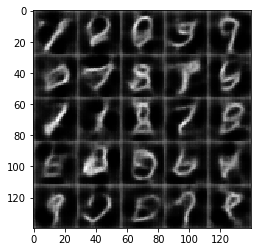

Epoch 1/2, batch 800... Discriminator Loss: 1.2752... Generator Loss: 1.0278


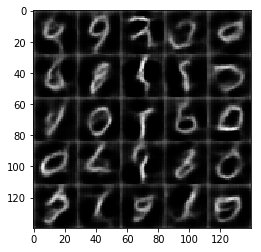

Epoch 1/2, batch 900... Discriminator Loss: 1.2765... Generator Loss: 0.6922


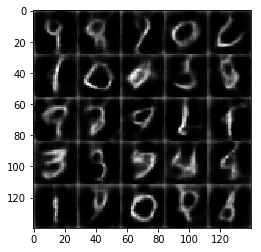

Epoch 2/2, batch 1000... Discriminator Loss: 1.3973... Generator Loss: 0.3865


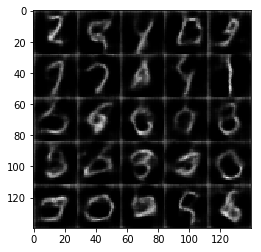

Epoch 2/2, batch 1100... Discriminator Loss: 1.1111... Generator Loss: 1.0961


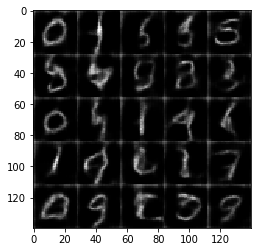

Epoch 2/2, batch 1200... Discriminator Loss: 1.1241... Generator Loss: 1.1929


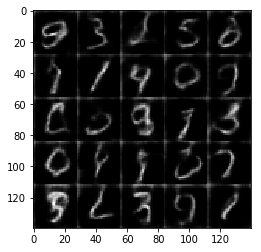

Epoch 2/2, batch 1300... Discriminator Loss: 1.1959... Generator Loss: 0.5740


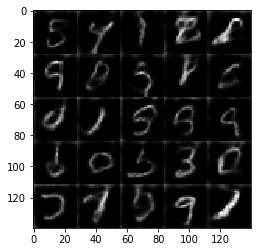

Epoch 2/2, batch 1400... Discriminator Loss: 1.1393... Generator Loss: 1.4326


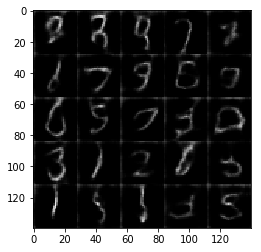

Epoch 2/2, batch 1500... Discriminator Loss: 1.0151... Generator Loss: 0.9545


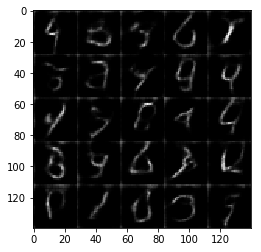

Epoch 2/2, batch 1600... Discriminator Loss: 0.9772... Generator Loss: 1.1366


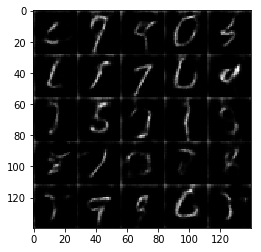

Epoch 2/2, batch 1700... Discriminator Loss: 1.3910... Generator Loss: 0.3661


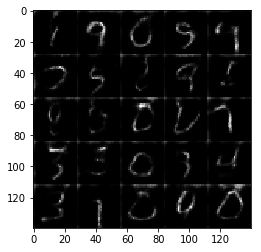

Epoch 2/2, batch 1800... Discriminator Loss: 1.3245... Generator Loss: 1.4344
batch_size is 64, beta1 is 0.1, alpha is 0.1,learning_rate is 0.0015


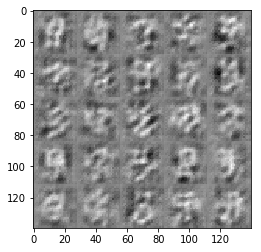

Epoch 1/2, batch 100... Discriminator Loss: 1.9073... Generator Loss: 0.2533


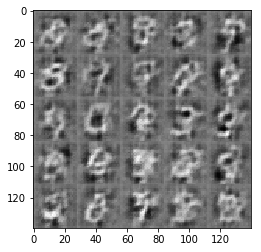

Epoch 1/2, batch 200... Discriminator Loss: 1.6750... Generator Loss: 0.2757


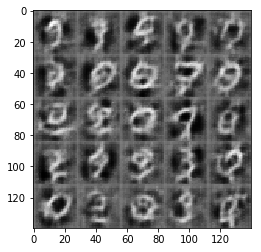

Epoch 1/2, batch 300... Discriminator Loss: 1.7666... Generator Loss: 0.2416


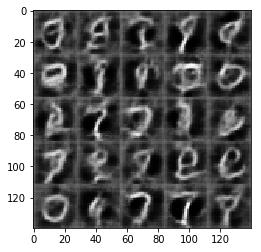

Epoch 1/2, batch 400... Discriminator Loss: 1.3987... Generator Loss: 0.4054


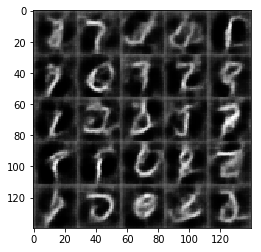

Epoch 1/2, batch 500... Discriminator Loss: 1.6984... Generator Loss: 0.2651


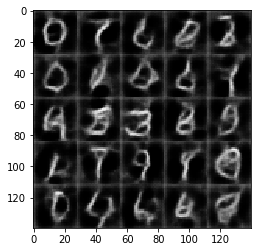

Epoch 1/2, batch 600... Discriminator Loss: 1.4909... Generator Loss: 0.3769


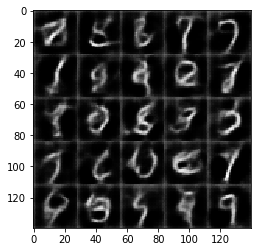

Epoch 1/2, batch 700... Discriminator Loss: 1.1703... Generator Loss: 0.9494


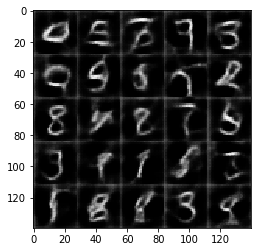

Epoch 1/2, batch 800... Discriminator Loss: 1.2987... Generator Loss: 0.7939


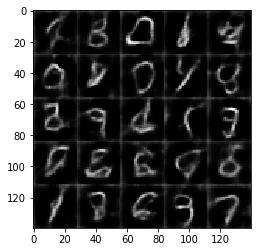

Epoch 1/2, batch 900... Discriminator Loss: 1.5962... Generator Loss: 0.3128


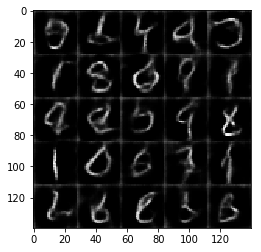

Epoch 2/2, batch 1000... Discriminator Loss: 1.4348... Generator Loss: 0.3830


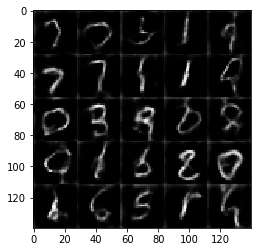

Epoch 2/2, batch 1100... Discriminator Loss: 1.1435... Generator Loss: 0.6102


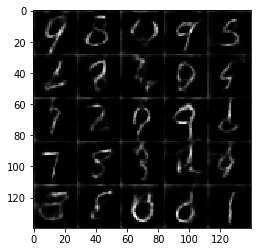

Epoch 2/2, batch 1200... Discriminator Loss: 1.4654... Generator Loss: 0.3443


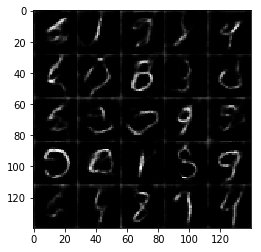

Epoch 2/2, batch 1300... Discriminator Loss: 1.1587... Generator Loss: 0.7492


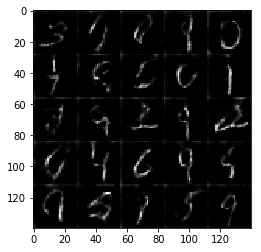

Epoch 2/2, batch 1400... Discriminator Loss: 1.1486... Generator Loss: 0.6297


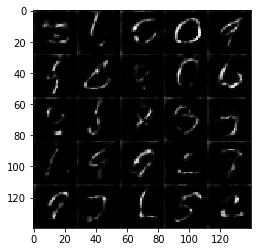

Epoch 2/2, batch 1500... Discriminator Loss: 1.4532... Generator Loss: 0.3350


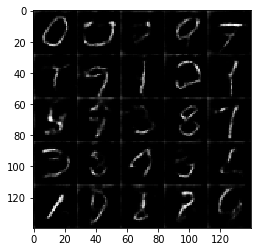

Epoch 2/2, batch 1600... Discriminator Loss: 1.2989... Generator Loss: 1.0713


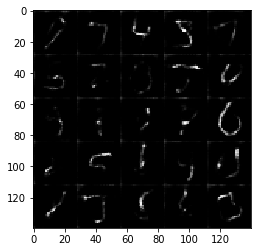

Epoch 2/2, batch 1700... Discriminator Loss: 1.3752... Generator Loss: 0.4619


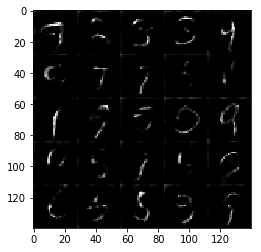

Epoch 2/2, batch 1800... Discriminator Loss: 1.0195... Generator Loss: 1.0618
batch_size is 64, beta1 is 0.1, alpha is 0.1,learning_rate is 0.002


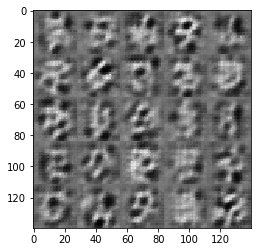

Epoch 1/2, batch 100... Discriminator Loss: 1.6781... Generator Loss: 0.3597


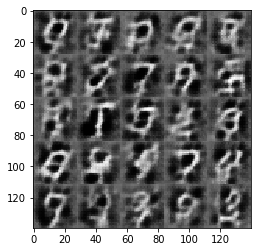

Epoch 1/2, batch 200... Discriminator Loss: 1.6603... Generator Loss: 0.2823


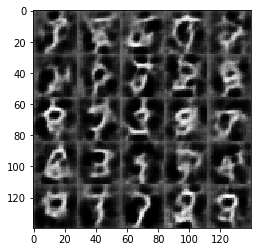

Epoch 1/2, batch 300... Discriminator Loss: 1.9266... Generator Loss: 0.2099


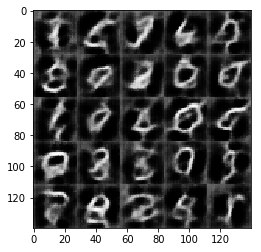

Epoch 1/2, batch 400... Discriminator Loss: 1.5490... Generator Loss: 0.3306


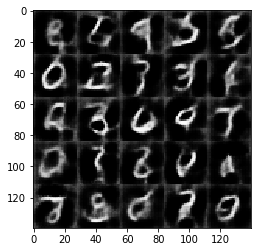

Epoch 1/2, batch 500... Discriminator Loss: 1.4000... Generator Loss: 0.4990


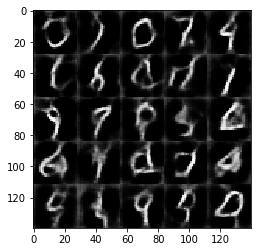

Epoch 1/2, batch 600... Discriminator Loss: 1.3136... Generator Loss: 0.5244


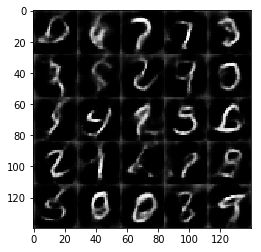

Epoch 1/2, batch 700... Discriminator Loss: 1.4314... Generator Loss: 1.1797


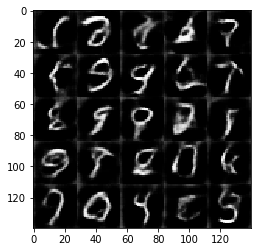

Epoch 1/2, batch 800... Discriminator Loss: 1.4644... Generator Loss: 1.1963


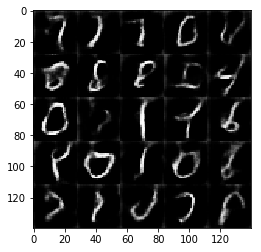

Epoch 1/2, batch 900... Discriminator Loss: 1.2772... Generator Loss: 0.8080


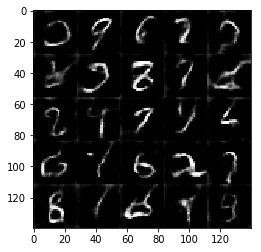

Epoch 2/2, batch 1000... Discriminator Loss: 1.5240... Generator Loss: 0.3277


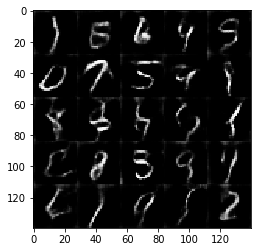

Epoch 2/2, batch 1100... Discriminator Loss: 1.2082... Generator Loss: 0.9959


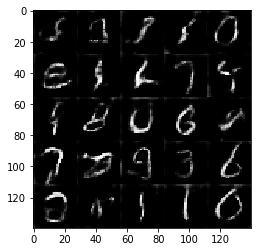

Epoch 2/2, batch 1200... Discriminator Loss: 1.1574... Generator Loss: 0.6579


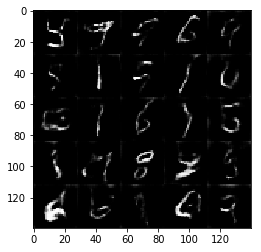

Epoch 2/2, batch 1300... Discriminator Loss: 1.7195... Generator Loss: 1.5875


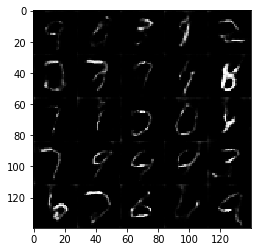

Epoch 2/2, batch 1400... Discriminator Loss: 1.1306... Generator Loss: 1.1608


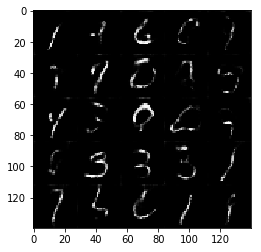

Epoch 2/2, batch 1500... Discriminator Loss: 1.0686... Generator Loss: 1.3893


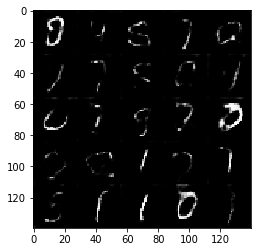

Epoch 2/2, batch 1600... Discriminator Loss: 1.2685... Generator Loss: 0.4827


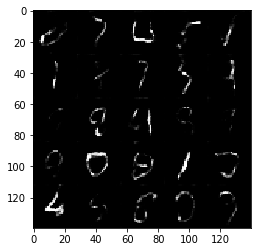

Epoch 2/2, batch 1700... Discriminator Loss: 1.0684... Generator Loss: 0.6658


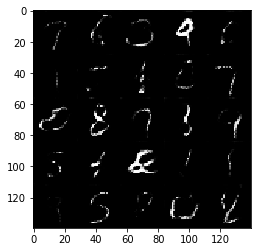

Epoch 2/2, batch 1800... Discriminator Loss: 1.0746... Generator Loss: 0.6057
batch_size is 64, beta1 is 0.1, alpha is 0.2,learning_rate is 0.0001


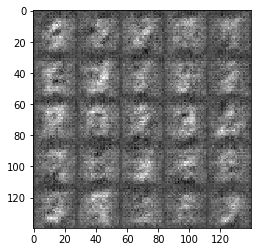

Epoch 1/2, batch 100... Discriminator Loss: 1.0145... Generator Loss: 0.9125


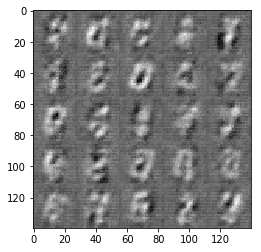

Epoch 1/2, batch 200... Discriminator Loss: 1.0176... Generator Loss: 1.1909


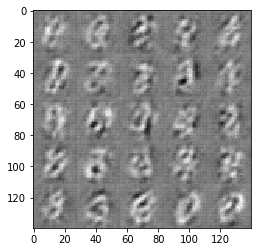

Epoch 1/2, batch 300... Discriminator Loss: 1.1209... Generator Loss: 0.7992


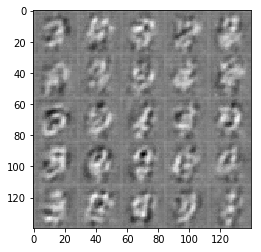

Epoch 1/2, batch 400... Discriminator Loss: 1.0205... Generator Loss: 1.0490


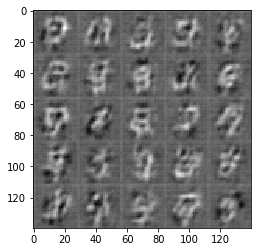

Epoch 1/2, batch 500... Discriminator Loss: 1.0639... Generator Loss: 1.1110


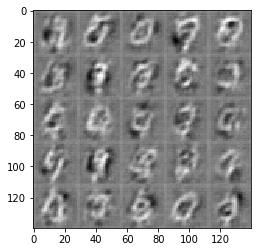

Epoch 1/2, batch 600... Discriminator Loss: 1.0918... Generator Loss: 1.1468


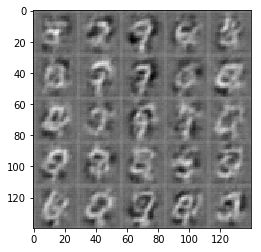

Epoch 1/2, batch 700... Discriminator Loss: 1.0355... Generator Loss: 0.8406


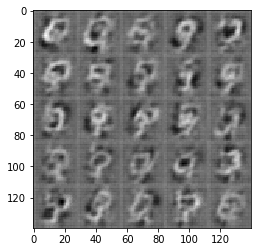

Epoch 1/2, batch 800... Discriminator Loss: 1.1546... Generator Loss: 1.1733


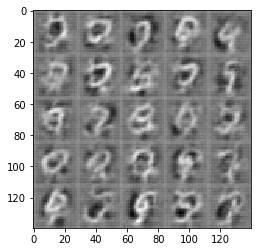

Epoch 1/2, batch 900... Discriminator Loss: 1.1908... Generator Loss: 0.5606


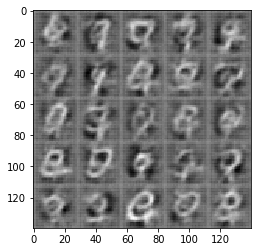

Epoch 2/2, batch 1000... Discriminator Loss: 1.1564... Generator Loss: 0.5901


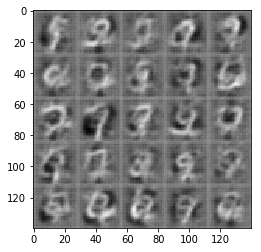

Epoch 2/2, batch 1100... Discriminator Loss: 1.0420... Generator Loss: 1.1429


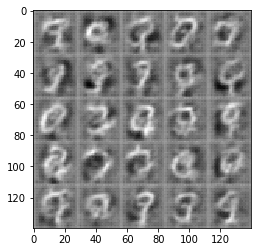

Epoch 2/2, batch 1200... Discriminator Loss: 1.0493... Generator Loss: 1.1561


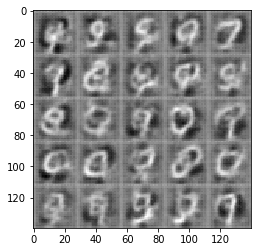

Epoch 2/2, batch 1300... Discriminator Loss: 1.0967... Generator Loss: 1.1666


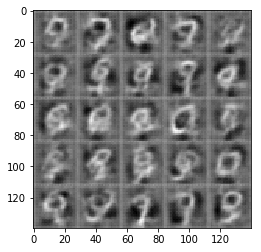

Epoch 2/2, batch 1400... Discriminator Loss: 1.0015... Generator Loss: 0.8274


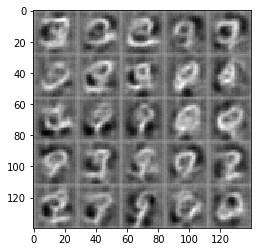

Epoch 2/2, batch 1500... Discriminator Loss: 1.1807... Generator Loss: 1.2355


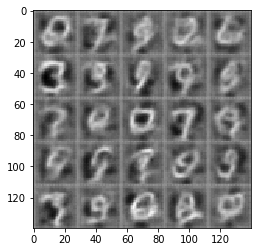

Epoch 2/2, batch 1600... Discriminator Loss: 1.0713... Generator Loss: 1.0068


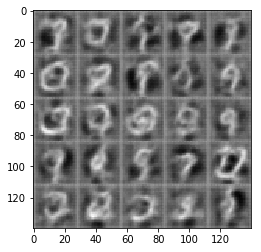

Epoch 2/2, batch 1700... Discriminator Loss: 1.0376... Generator Loss: 0.8721


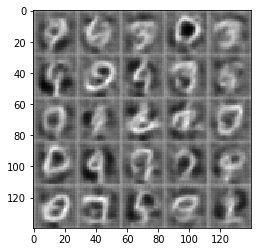

Epoch 2/2, batch 1800... Discriminator Loss: 1.0271... Generator Loss: 1.1554
batch_size is 64, beta1 is 0.1, alpha is 0.2,learning_rate is 0.0005


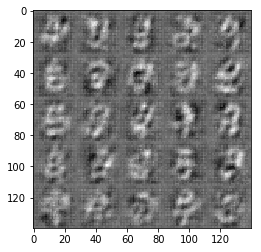

Epoch 1/2, batch 100... Discriminator Loss: 1.6189... Generator Loss: 0.3305


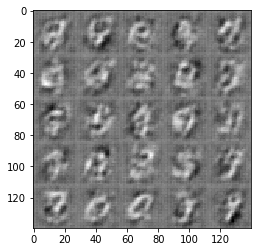

Epoch 1/2, batch 200... Discriminator Loss: 1.4317... Generator Loss: 0.4028


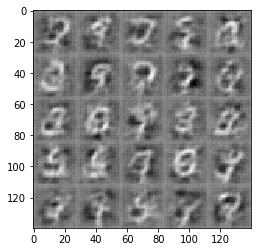

Epoch 1/2, batch 300... Discriminator Loss: 1.4531... Generator Loss: 0.3761


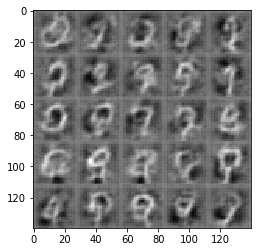

Epoch 1/2, batch 400... Discriminator Loss: 1.2228... Generator Loss: 1.0350


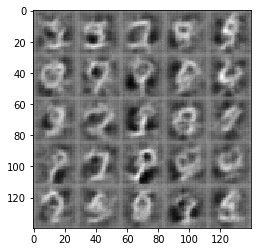

Epoch 1/2, batch 500... Discriminator Loss: 1.3244... Generator Loss: 0.8650


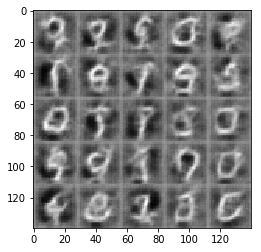

Epoch 1/2, batch 600... Discriminator Loss: 1.2826... Generator Loss: 0.5069


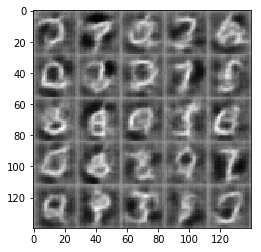

Epoch 1/2, batch 700... Discriminator Loss: 1.1798... Generator Loss: 0.6677


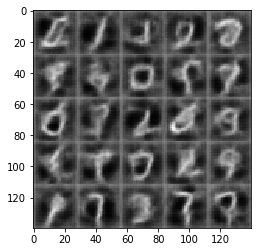

Epoch 1/2, batch 800... Discriminator Loss: 1.2885... Generator Loss: 0.9334


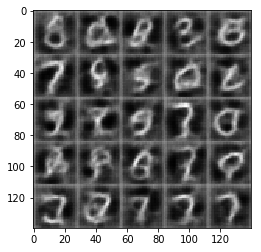

Epoch 1/2, batch 900... Discriminator Loss: 1.3098... Generator Loss: 0.7478


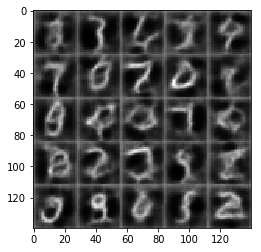

Epoch 2/2, batch 1000... Discriminator Loss: 1.3030... Generator Loss: 0.6819


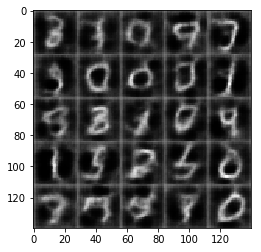

Epoch 2/2, batch 1100... Discriminator Loss: 2.1418... Generator Loss: 2.1190


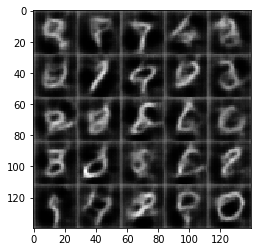

Epoch 2/2, batch 1200... Discriminator Loss: 1.1499... Generator Loss: 0.8079


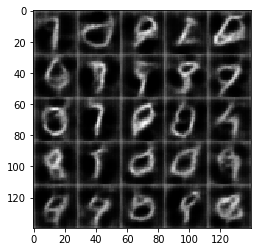

Epoch 2/2, batch 1300... Discriminator Loss: 1.3701... Generator Loss: 0.4400


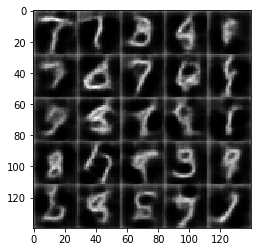

Epoch 2/2, batch 1400... Discriminator Loss: 1.1778... Generator Loss: 0.7330


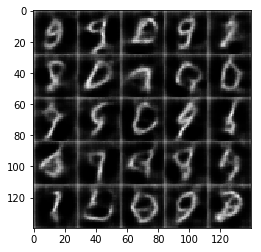

Epoch 2/2, batch 1500... Discriminator Loss: 1.5940... Generator Loss: 0.3001


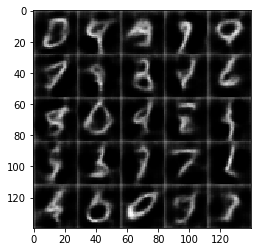

Epoch 2/2, batch 1600... Discriminator Loss: 1.3772... Generator Loss: 0.4067


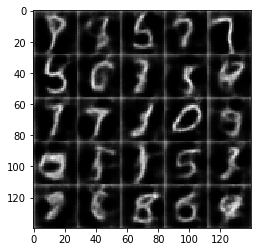

Epoch 2/2, batch 1700... Discriminator Loss: 1.2893... Generator Loss: 0.6459


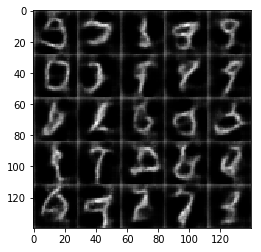

Epoch 2/2, batch 1800... Discriminator Loss: 1.2508... Generator Loss: 0.7156
batch_size is 64, beta1 is 0.1, alpha is 0.2,learning_rate is 0.001


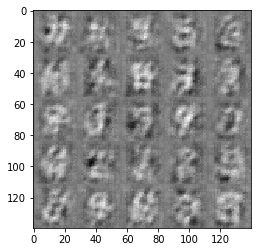

Epoch 1/2, batch 100... Discriminator Loss: 1.7856... Generator Loss: 1.0298


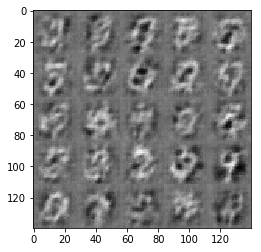

Epoch 1/2, batch 200... Discriminator Loss: 1.5811... Generator Loss: 0.3150


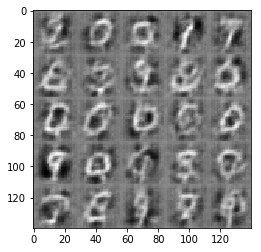

Epoch 1/2, batch 300... Discriminator Loss: 1.5361... Generator Loss: 0.3306


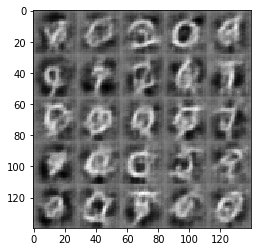

Epoch 1/2, batch 400... Discriminator Loss: 1.4414... Generator Loss: 0.3686


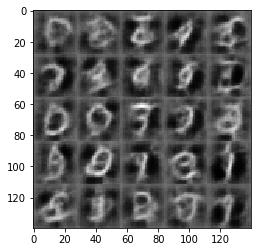

Epoch 1/2, batch 500... Discriminator Loss: 1.4957... Generator Loss: 0.3510


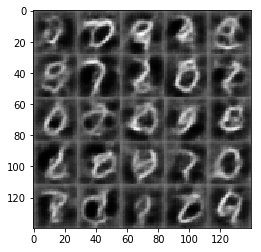

Epoch 1/2, batch 600... Discriminator Loss: 1.4088... Generator Loss: 1.4022


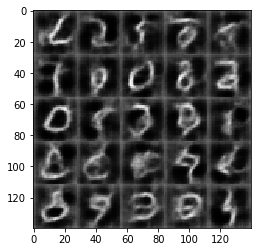

Epoch 1/2, batch 700... Discriminator Loss: 1.4043... Generator Loss: 0.4643


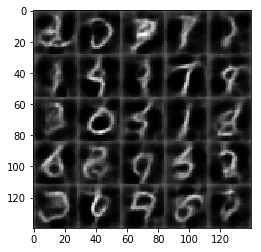

Epoch 1/2, batch 800... Discriminator Loss: 1.2354... Generator Loss: 0.7115


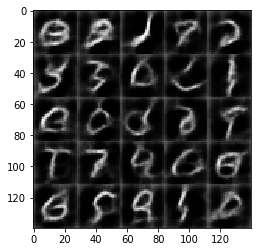

Epoch 1/2, batch 900... Discriminator Loss: 1.5481... Generator Loss: 0.3313


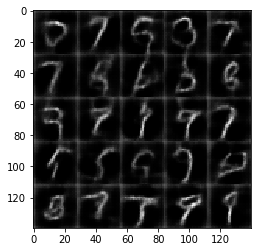

Epoch 2/2, batch 1000... Discriminator Loss: 1.4343... Generator Loss: 1.0154


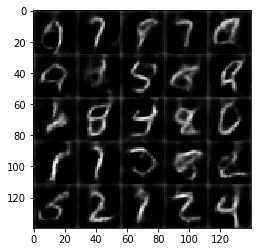

Epoch 2/2, batch 1100... Discriminator Loss: 1.1876... Generator Loss: 0.5861


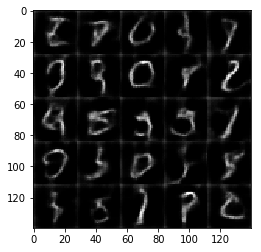

Epoch 2/2, batch 1200... Discriminator Loss: 1.3485... Generator Loss: 0.4780


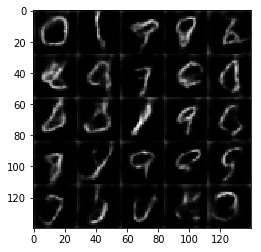

Epoch 2/2, batch 1300... Discriminator Loss: 1.3511... Generator Loss: 0.4522


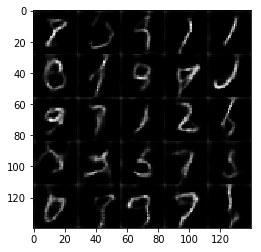

Epoch 2/2, batch 1400... Discriminator Loss: 1.2064... Generator Loss: 0.6038


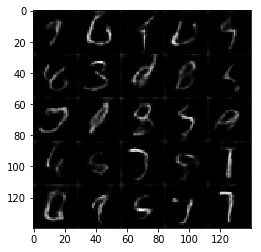

Epoch 2/2, batch 1500... Discriminator Loss: 1.2235... Generator Loss: 0.8733


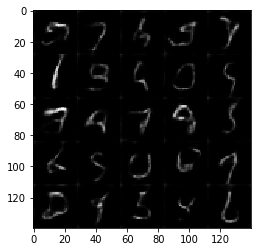

Epoch 2/2, batch 1600... Discriminator Loss: 1.2722... Generator Loss: 0.4712


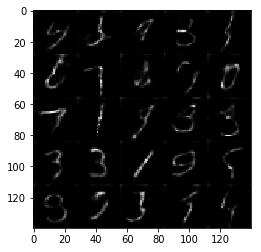

Epoch 2/2, batch 1700... Discriminator Loss: 1.0912... Generator Loss: 0.9713


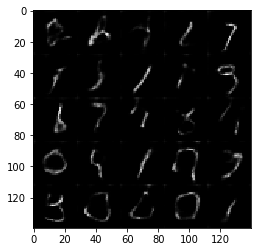

Epoch 2/2, batch 1800... Discriminator Loss: 1.0777... Generator Loss: 1.4279
batch_size is 64, beta1 is 0.1, alpha is 0.2,learning_rate is 0.0015


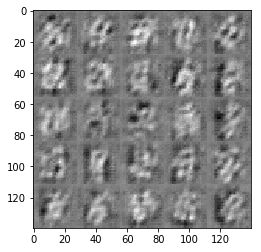

Epoch 1/2, batch 100... Discriminator Loss: 1.8535... Generator Loss: 0.5331


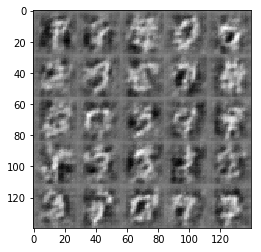

Epoch 1/2, batch 200... Discriminator Loss: 1.5143... Generator Loss: 0.8148


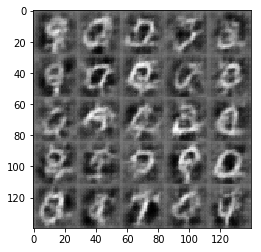

Epoch 1/2, batch 300... Discriminator Loss: 1.6324... Generator Loss: 0.2911


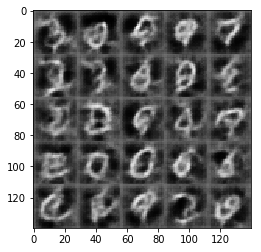

Epoch 1/2, batch 400... Discriminator Loss: 1.4537... Generator Loss: 1.0090


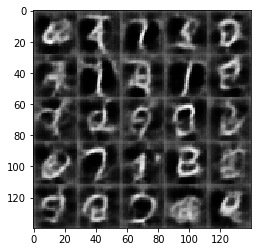

Epoch 1/2, batch 500... Discriminator Loss: 1.2926... Generator Loss: 0.9322


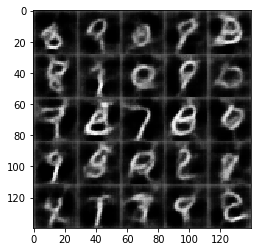

Epoch 1/2, batch 600... Discriminator Loss: 1.5973... Generator Loss: 1.2854


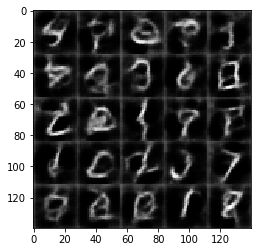

Epoch 1/2, batch 700... Discriminator Loss: 1.4187... Generator Loss: 0.4015


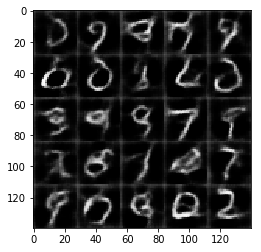

Epoch 1/2, batch 800... Discriminator Loss: 1.4613... Generator Loss: 1.1149


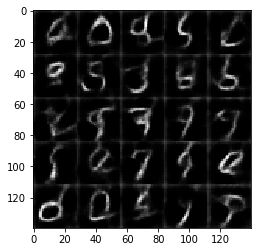

Epoch 1/2, batch 900... Discriminator Loss: 1.5570... Generator Loss: 0.3304


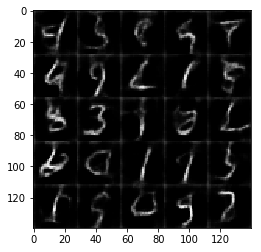

Epoch 2/2, batch 1000... Discriminator Loss: 1.3383... Generator Loss: 0.4485


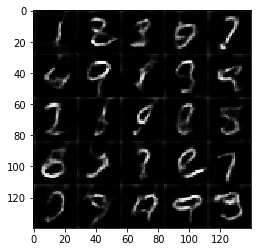

Epoch 2/2, batch 1100... Discriminator Loss: 1.1919... Generator Loss: 1.1471


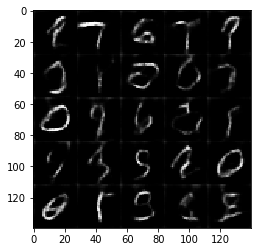

Epoch 2/2, batch 1200... Discriminator Loss: 1.0950... Generator Loss: 0.9359


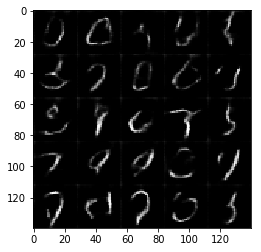

Epoch 2/2, batch 1300... Discriminator Loss: 1.3372... Generator Loss: 0.4357


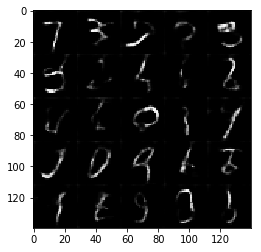

Epoch 2/2, batch 1400... Discriminator Loss: 1.1679... Generator Loss: 0.5477


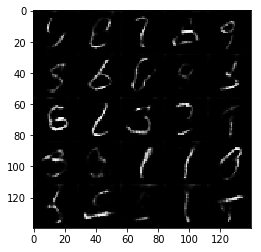

Epoch 2/2, batch 1500... Discriminator Loss: 1.5112... Generator Loss: 0.3986


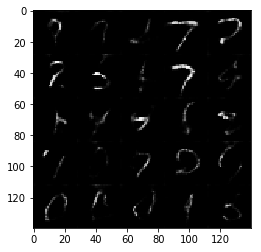

Epoch 2/2, batch 1600... Discriminator Loss: 2.0766... Generator Loss: 0.1834


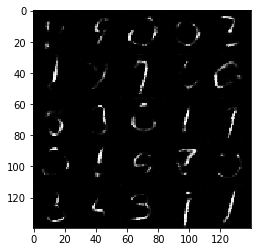

Epoch 2/2, batch 1700... Discriminator Loss: 1.2756... Generator Loss: 1.2605


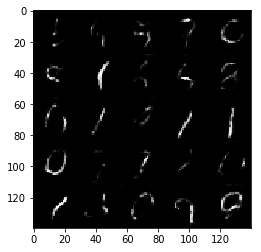

Epoch 2/2, batch 1800... Discriminator Loss: 1.0744... Generator Loss: 0.6767
batch_size is 64, beta1 is 0.1, alpha is 0.2,learning_rate is 0.002


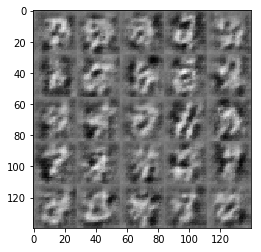

Epoch 1/2, batch 100... Discriminator Loss: 1.7257... Generator Loss: 0.7354


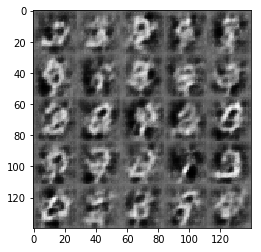

Epoch 1/2, batch 200... Discriminator Loss: 1.4115... Generator Loss: 0.8546


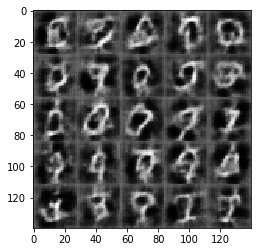

Epoch 1/2, batch 300... Discriminator Loss: 1.4170... Generator Loss: 1.0041


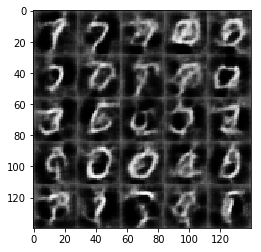

Epoch 1/2, batch 400... Discriminator Loss: 1.2835... Generator Loss: 0.8965


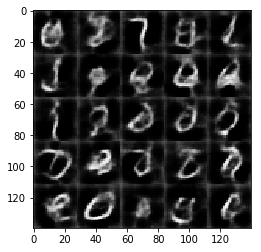

Epoch 1/2, batch 500... Discriminator Loss: 1.6707... Generator Loss: 0.2658


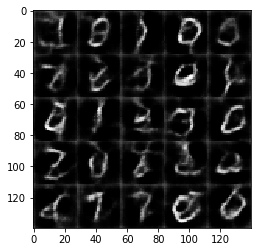

Epoch 1/2, batch 600... Discriminator Loss: 1.4744... Generator Loss: 0.9945


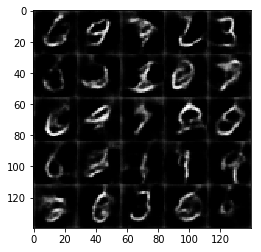

Epoch 1/2, batch 700... Discriminator Loss: 1.5698... Generator Loss: 0.3047


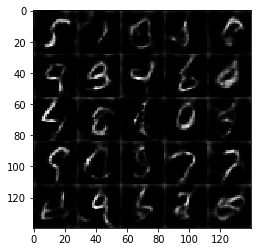

Epoch 1/2, batch 800... Discriminator Loss: 1.2928... Generator Loss: 1.0432


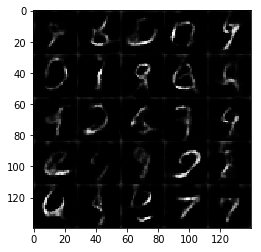

Epoch 1/2, batch 900... Discriminator Loss: 1.5874... Generator Loss: 0.3066


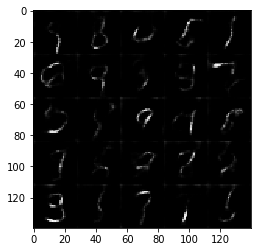

Epoch 2/2, batch 1000... Discriminator Loss: 1.2146... Generator Loss: 0.9158


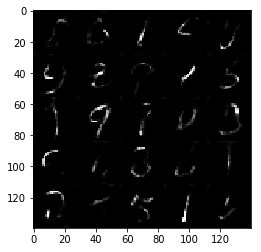

Epoch 2/2, batch 1100... Discriminator Loss: 1.3214... Generator Loss: 1.1838


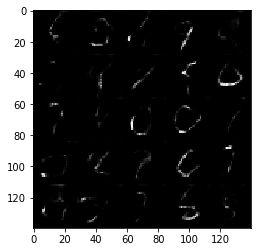

Epoch 2/2, batch 1200... Discriminator Loss: 1.3228... Generator Loss: 0.4549


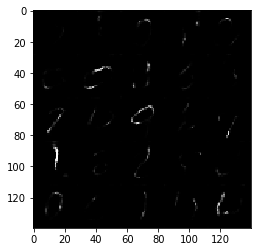

Epoch 2/2, batch 1300... Discriminator Loss: 1.2094... Generator Loss: 0.8797


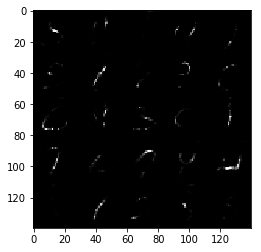

Epoch 2/2, batch 1400... Discriminator Loss: 1.2856... Generator Loss: 1.3262


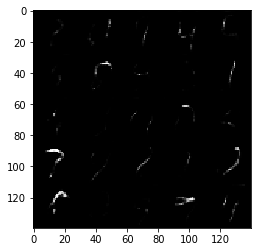

Epoch 2/2, batch 1500... Discriminator Loss: 1.1202... Generator Loss: 0.7641


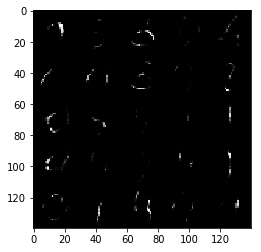

Epoch 2/2, batch 1600... Discriminator Loss: 1.0870... Generator Loss: 1.0221


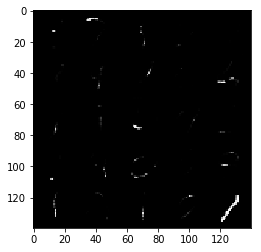

Epoch 2/2, batch 1700... Discriminator Loss: 1.1987... Generator Loss: 0.9764


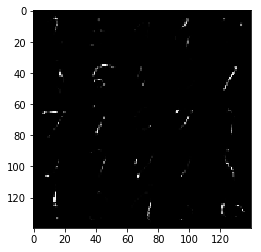

Epoch 2/2, batch 1800... Discriminator Loss: 1.1081... Generator Loss: 1.0845
batch_size is 64, beta1 is 0.2, alpha is 0.1,learning_rate is 0.0001


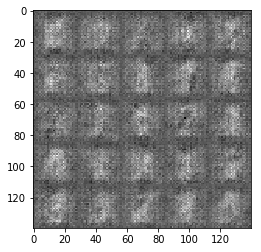

Epoch 1/2, batch 100... Discriminator Loss: 0.8843... Generator Loss: 0.7359


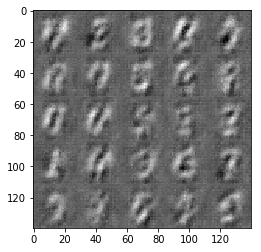

Epoch 1/2, batch 200... Discriminator Loss: 0.9392... Generator Loss: 0.7996


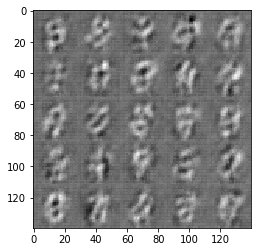

Epoch 1/2, batch 300... Discriminator Loss: 1.0862... Generator Loss: 0.6563


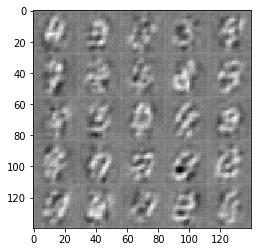

Epoch 1/2, batch 400... Discriminator Loss: 1.0694... Generator Loss: 0.6117


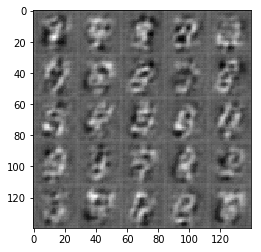

Epoch 1/2, batch 500... Discriminator Loss: 1.1036... Generator Loss: 0.6586


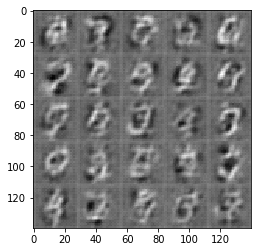

Epoch 1/2, batch 600... Discriminator Loss: 1.0548... Generator Loss: 1.0358


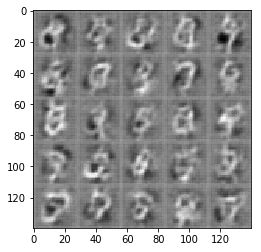

Epoch 1/2, batch 700... Discriminator Loss: 0.9700... Generator Loss: 0.9926


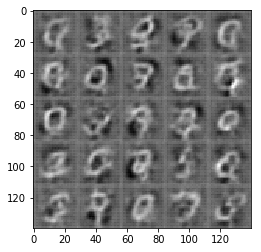

Epoch 1/2, batch 800... Discriminator Loss: 0.9959... Generator Loss: 0.8502


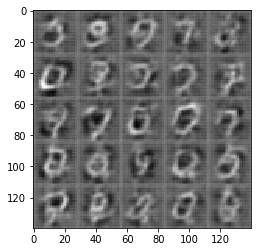

Epoch 1/2, batch 900... Discriminator Loss: 1.3201... Generator Loss: 0.4279


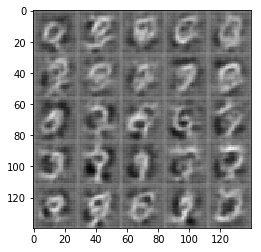

Epoch 2/2, batch 1000... Discriminator Loss: 1.0197... Generator Loss: 0.7947


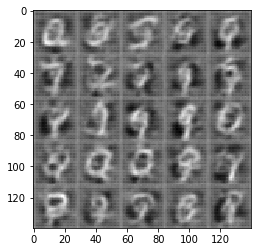

Epoch 2/2, batch 1100... Discriminator Loss: 0.9183... Generator Loss: 1.1817


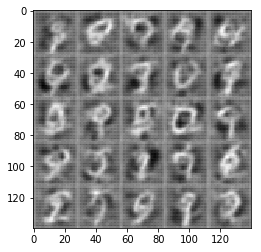

Epoch 2/2, batch 1200... Discriminator Loss: 1.0482... Generator Loss: 0.6903


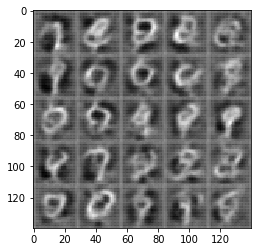

Epoch 2/2, batch 1300... Discriminator Loss: 1.0627... Generator Loss: 0.6754


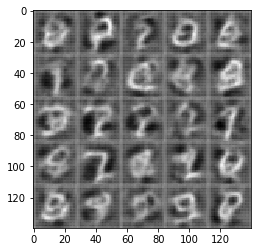

Epoch 2/2, batch 1400... Discriminator Loss: 1.0178... Generator Loss: 0.8238


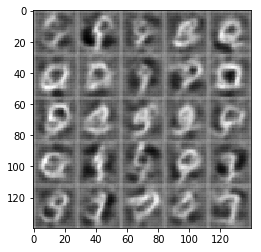

Epoch 2/2, batch 1500... Discriminator Loss: 0.9432... Generator Loss: 0.7737


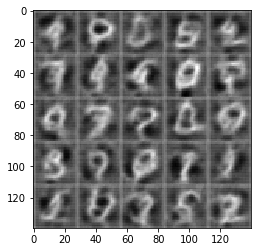

Epoch 2/2, batch 1600... Discriminator Loss: 1.0812... Generator Loss: 0.6133


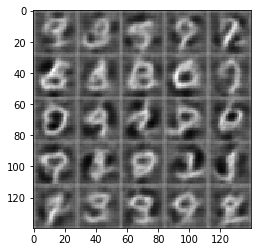

Epoch 2/2, batch 1700... Discriminator Loss: 1.0214... Generator Loss: 1.0279


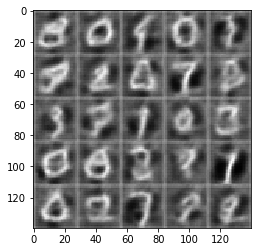

Epoch 2/2, batch 1800... Discriminator Loss: 1.0184... Generator Loss: 1.1051
batch_size is 64, beta1 is 0.2, alpha is 0.1,learning_rate is 0.0005


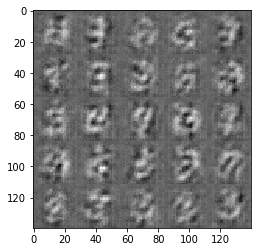

Epoch 1/2, batch 100... Discriminator Loss: 1.5663... Generator Loss: 0.3381


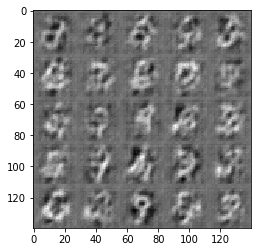

Epoch 1/2, batch 200... Discriminator Loss: 1.4147... Generator Loss: 0.3802


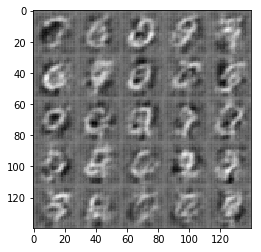

Epoch 1/2, batch 300... Discriminator Loss: 1.3555... Generator Loss: 0.4309


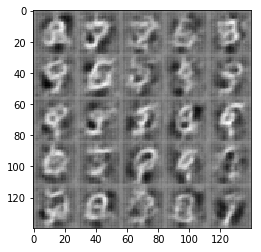

Epoch 1/2, batch 400... Discriminator Loss: 1.2518... Generator Loss: 0.6807


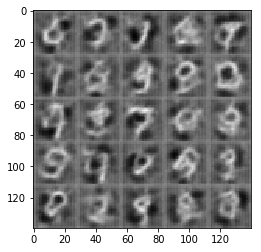

Epoch 1/2, batch 500... Discriminator Loss: 1.2582... Generator Loss: 0.6658


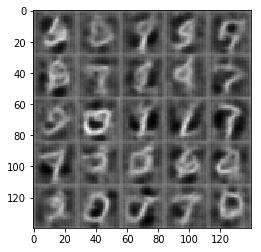

Epoch 1/2, batch 600... Discriminator Loss: 1.4072... Generator Loss: 0.3985


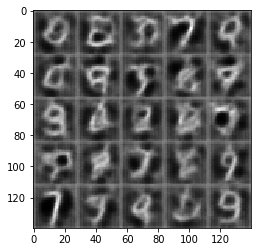

Epoch 1/2, batch 700... Discriminator Loss: 1.2020... Generator Loss: 0.6275


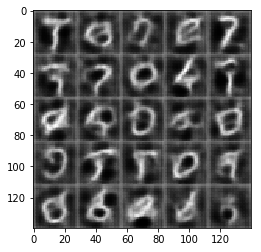

Epoch 1/2, batch 800... Discriminator Loss: 1.2683... Generator Loss: 1.3015


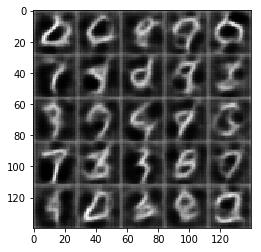

Epoch 1/2, batch 900... Discriminator Loss: 1.1690... Generator Loss: 0.7977


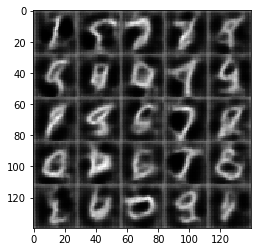

Epoch 2/2, batch 1000... Discriminator Loss: 1.0827... Generator Loss: 0.9408


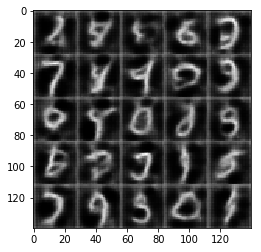

Epoch 2/2, batch 1100... Discriminator Loss: 1.2043... Generator Loss: 0.5923


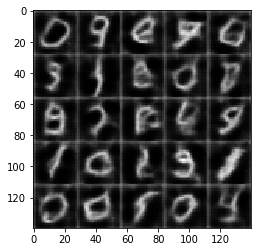

Epoch 2/2, batch 1200... Discriminator Loss: 1.1260... Generator Loss: 0.6321


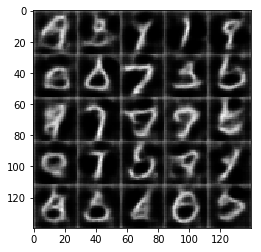

Epoch 2/2, batch 1300... Discriminator Loss: 1.2888... Generator Loss: 1.4220


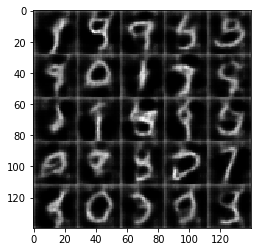

Epoch 2/2, batch 1400... Discriminator Loss: 1.0604... Generator Loss: 0.6503


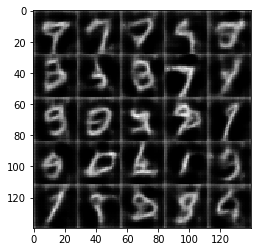

Epoch 2/2, batch 1500... Discriminator Loss: 1.0059... Generator Loss: 0.8762


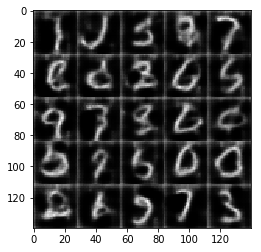

Epoch 2/2, batch 1600... Discriminator Loss: 1.0614... Generator Loss: 0.6725


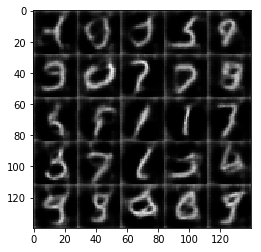

Epoch 2/2, batch 1700... Discriminator Loss: 1.6469... Generator Loss: 1.9989


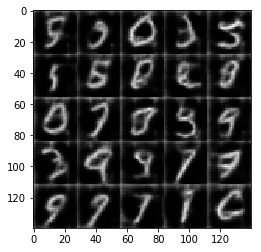

Epoch 2/2, batch 1800... Discriminator Loss: 1.0857... Generator Loss: 0.5654
batch_size is 64, beta1 is 0.2, alpha is 0.1,learning_rate is 0.001


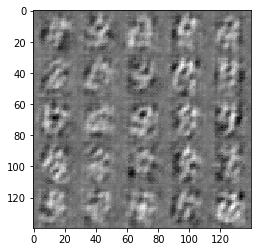

Epoch 1/2, batch 100... Discriminator Loss: 1.6376... Generator Loss: 0.5477


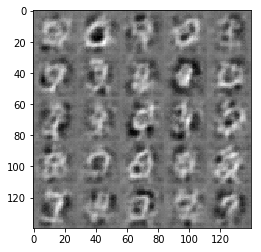

Epoch 1/2, batch 200... Discriminator Loss: 1.4242... Generator Loss: 1.2328


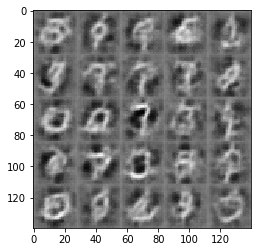

Epoch 1/2, batch 300... Discriminator Loss: 1.4224... Generator Loss: 1.1723


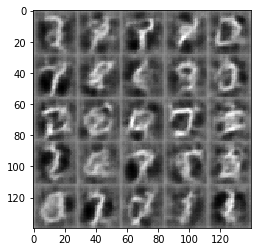

Epoch 1/2, batch 400... Discriminator Loss: 1.5450... Generator Loss: 0.3385


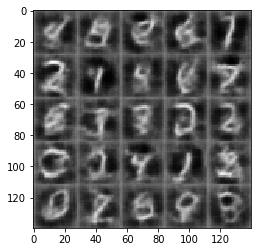

Epoch 1/2, batch 500... Discriminator Loss: 1.4996... Generator Loss: 1.2191


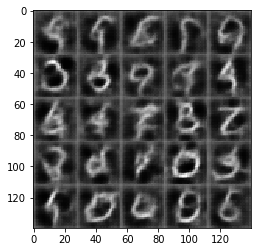

Epoch 1/2, batch 600... Discriminator Loss: 1.2430... Generator Loss: 0.6550


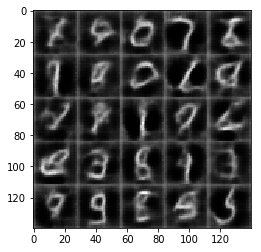

Epoch 1/2, batch 700... Discriminator Loss: 1.3659... Generator Loss: 0.4488


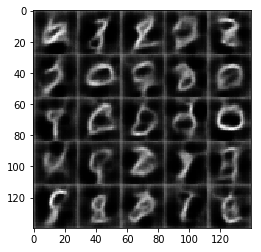

Epoch 1/2, batch 800... Discriminator Loss: 1.2937... Generator Loss: 0.9331


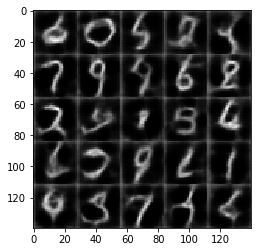

Epoch 1/2, batch 900... Discriminator Loss: 1.6149... Generator Loss: 0.2820


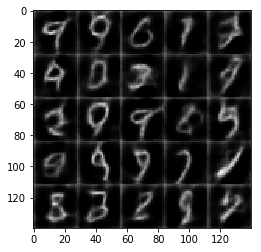

Epoch 2/2, batch 1000... Discriminator Loss: 1.2245... Generator Loss: 1.0970


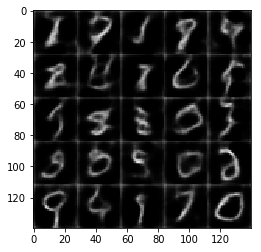

Epoch 2/2, batch 1100... Discriminator Loss: 1.0936... Generator Loss: 1.0606


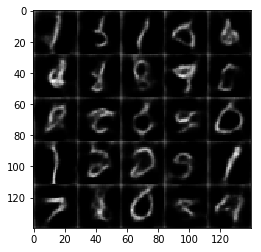

Epoch 2/2, batch 1200... Discriminator Loss: 1.3547... Generator Loss: 0.4310


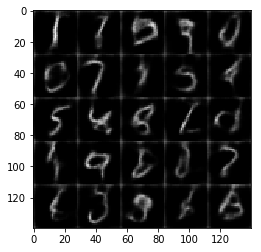

Epoch 2/2, batch 1300... Discriminator Loss: 1.2367... Generator Loss: 1.1187


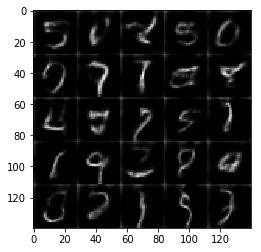

Epoch 2/2, batch 1400... Discriminator Loss: 1.2211... Generator Loss: 0.4579


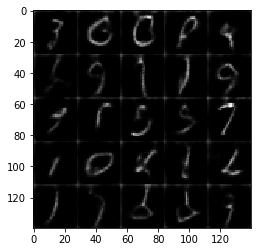

Epoch 2/2, batch 1500... Discriminator Loss: 1.3812... Generator Loss: 1.5188


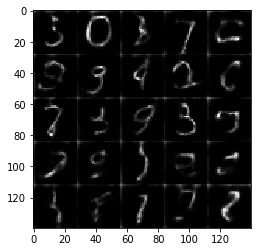

Epoch 2/2, batch 1600... Discriminator Loss: 1.2794... Generator Loss: 0.4244


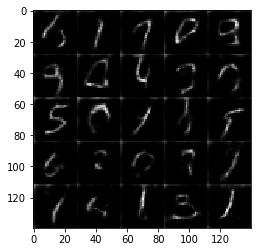

Epoch 2/2, batch 1700... Discriminator Loss: 1.7154... Generator Loss: 1.9067


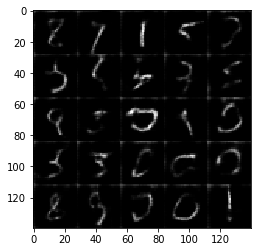

Epoch 2/2, batch 1800... Discriminator Loss: 1.5634... Generator Loss: 0.3246
batch_size is 64, beta1 is 0.2, alpha is 0.1,learning_rate is 0.0015


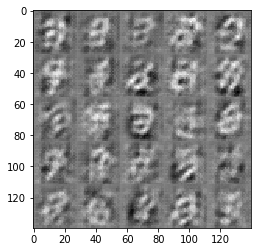

Epoch 1/2, batch 100... Discriminator Loss: 1.7382... Generator Loss: 0.3138


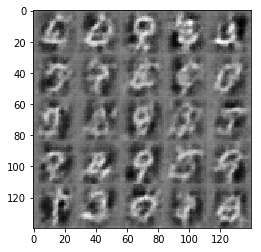

Epoch 1/2, batch 200... Discriminator Loss: 1.5733... Generator Loss: 0.3125


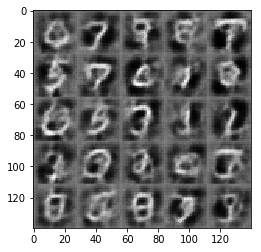

Epoch 1/2, batch 300... Discriminator Loss: 1.3263... Generator Loss: 0.6064


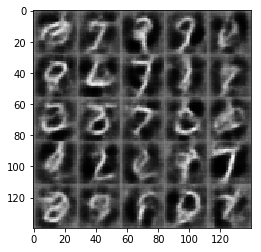

Epoch 1/2, batch 400... Discriminator Loss: 1.4138... Generator Loss: 1.1202


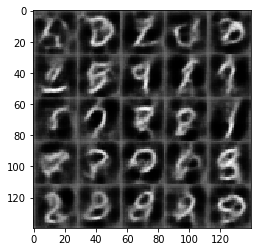

Epoch 1/2, batch 500... Discriminator Loss: 1.4756... Generator Loss: 0.9510


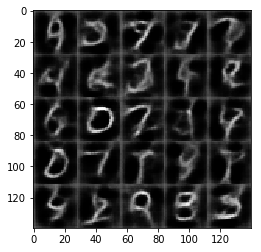

Epoch 1/2, batch 600... Discriminator Loss: 1.4843... Generator Loss: 1.0503


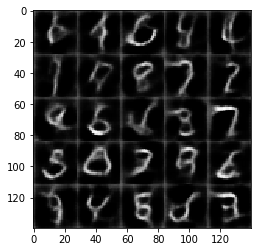

Epoch 1/2, batch 700... Discriminator Loss: 1.3340... Generator Loss: 1.2477


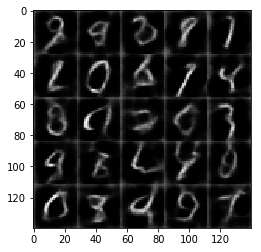

Epoch 1/2, batch 800... Discriminator Loss: 1.3424... Generator Loss: 0.4776


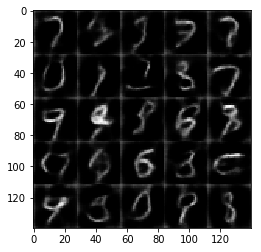

Epoch 1/2, batch 900... Discriminator Loss: 1.3173... Generator Loss: 0.7985


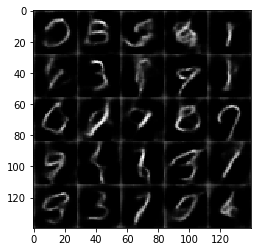

Epoch 2/2, batch 1000... Discriminator Loss: 1.3486... Generator Loss: 0.4477


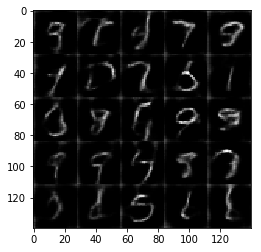

Epoch 2/2, batch 1100... Discriminator Loss: 1.5175... Generator Loss: 0.3499


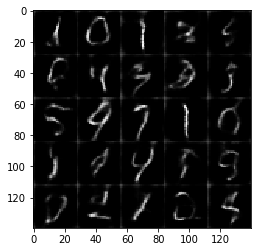

Epoch 2/2, batch 1200... Discriminator Loss: 1.0731... Generator Loss: 0.8176


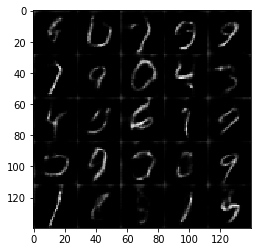

Epoch 2/2, batch 1300... Discriminator Loss: 1.0496... Generator Loss: 1.0560


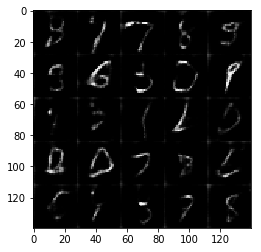

Epoch 2/2, batch 1400... Discriminator Loss: 1.8520... Generator Loss: 2.0325


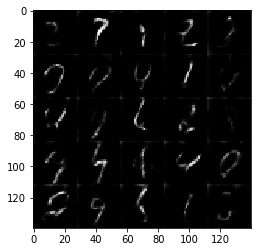

Epoch 2/2, batch 1500... Discriminator Loss: 1.0797... Generator Loss: 1.5435


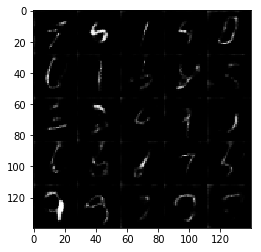

Epoch 2/2, batch 1600... Discriminator Loss: 1.0584... Generator Loss: 0.6814


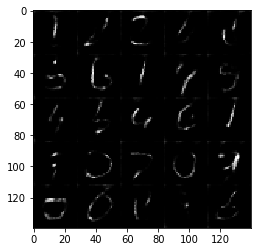

Epoch 2/2, batch 1700... Discriminator Loss: 1.0190... Generator Loss: 0.7443


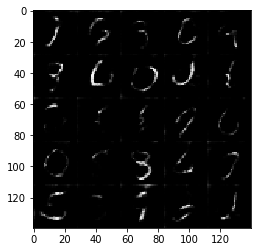

Epoch 2/2, batch 1800... Discriminator Loss: 1.2745... Generator Loss: 0.6682
batch_size is 64, beta1 is 0.2, alpha is 0.1,learning_rate is 0.002


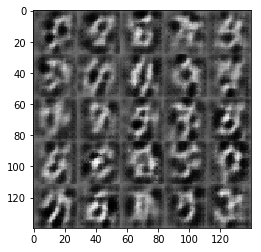

Epoch 1/2, batch 100... Discriminator Loss: 1.5649... Generator Loss: 0.9314


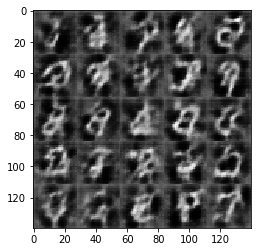

Epoch 1/2, batch 200... Discriminator Loss: 1.4995... Generator Loss: 1.1174


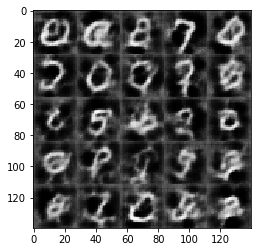

Epoch 1/2, batch 300... Discriminator Loss: 1.5036... Generator Loss: 1.1131


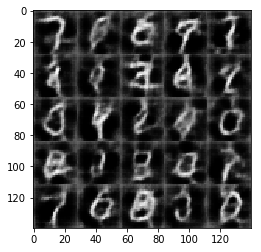

Epoch 1/2, batch 400... Discriminator Loss: 1.5672... Generator Loss: 0.3274


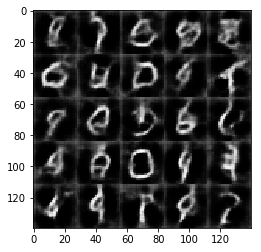

Epoch 1/2, batch 500... Discriminator Loss: 1.5694... Generator Loss: 0.2951


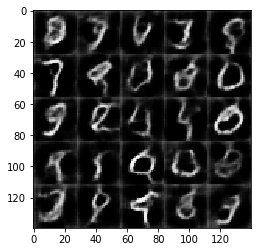

Epoch 1/2, batch 600... Discriminator Loss: 1.4191... Generator Loss: 0.4043


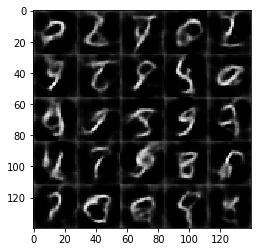

Epoch 1/2, batch 700... Discriminator Loss: 1.2452... Generator Loss: 0.7517


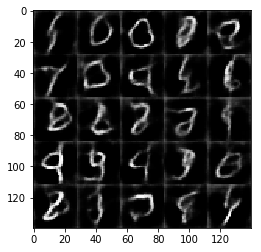

Epoch 1/2, batch 800... Discriminator Loss: 1.4323... Generator Loss: 1.3136


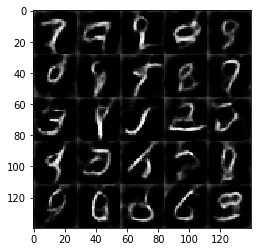

Epoch 1/2, batch 900... Discriminator Loss: 1.2457... Generator Loss: 0.7672


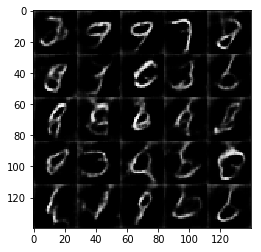

Epoch 2/2, batch 1000... Discriminator Loss: 1.3553... Generator Loss: 1.1909


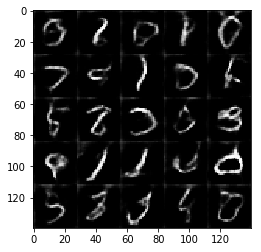

Epoch 2/2, batch 1100... Discriminator Loss: 1.2566... Generator Loss: 1.3318


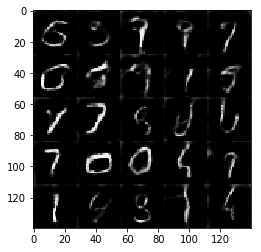

Epoch 2/2, batch 1200... Discriminator Loss: 1.1305... Generator Loss: 0.7081


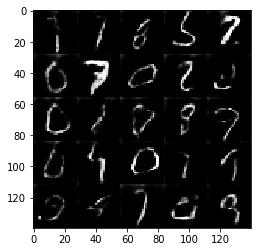

Epoch 2/2, batch 1300... Discriminator Loss: 1.1137... Generator Loss: 0.8637


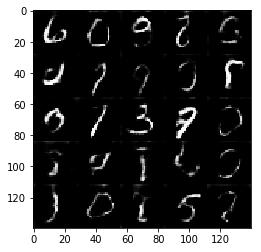

Epoch 2/2, batch 1400... Discriminator Loss: 1.4572... Generator Loss: 1.6571


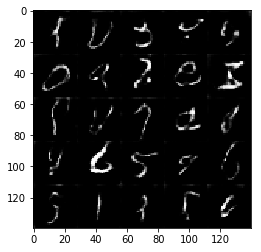

Epoch 2/2, batch 1500... Discriminator Loss: 1.2427... Generator Loss: 0.5622


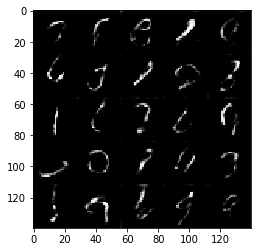

Epoch 2/2, batch 1600... Discriminator Loss: 1.6401... Generator Loss: 0.2690


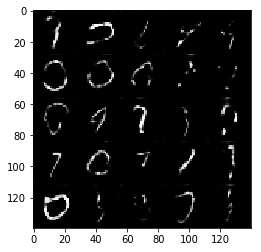

Epoch 2/2, batch 1700... Discriminator Loss: 1.2596... Generator Loss: 0.4560


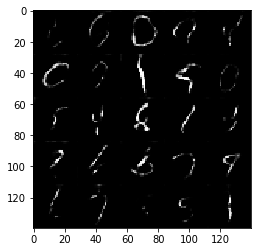

Epoch 2/2, batch 1800... Discriminator Loss: 1.3106... Generator Loss: 0.4676
batch_size is 64, beta1 is 0.2, alpha is 0.2,learning_rate is 0.0001


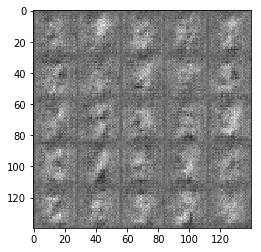

Epoch 1/2, batch 100... Discriminator Loss: 1.0792... Generator Loss: 0.5965


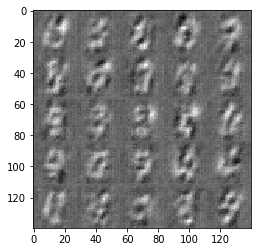

Epoch 1/2, batch 200... Discriminator Loss: 1.0427... Generator Loss: 0.7744


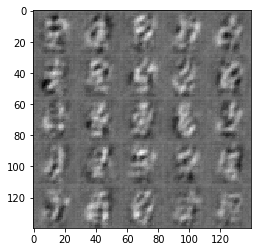

Epoch 1/2, batch 300... Discriminator Loss: 1.1477... Generator Loss: 0.6851


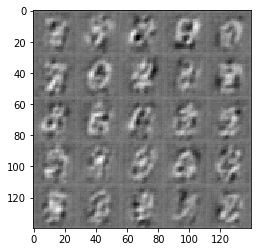

Epoch 1/2, batch 400... Discriminator Loss: 1.0736... Generator Loss: 0.6771


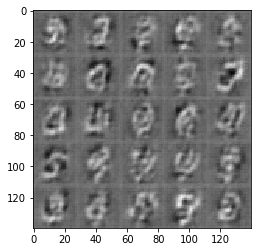

Epoch 1/2, batch 500... Discriminator Loss: 1.0652... Generator Loss: 0.8615


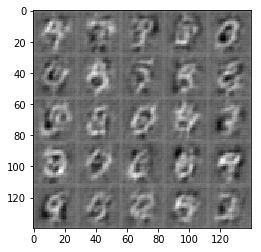

Epoch 1/2, batch 600... Discriminator Loss: 1.0633... Generator Loss: 0.7963


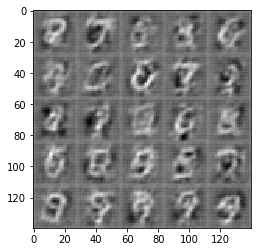

Epoch 1/2, batch 700... Discriminator Loss: 1.0255... Generator Loss: 0.8897


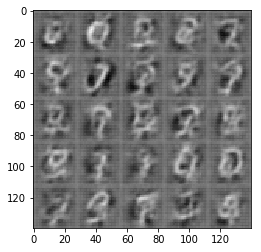

Epoch 1/2, batch 800... Discriminator Loss: 1.0480... Generator Loss: 0.7955


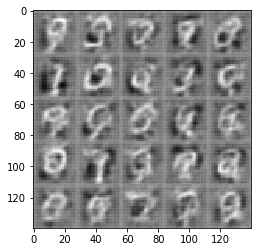

Epoch 1/2, batch 900... Discriminator Loss: 1.1176... Generator Loss: 0.9419


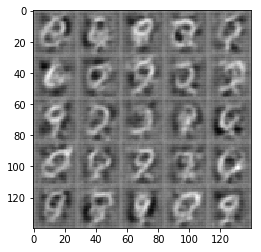

Epoch 2/2, batch 1000... Discriminator Loss: 1.0360... Generator Loss: 0.9306


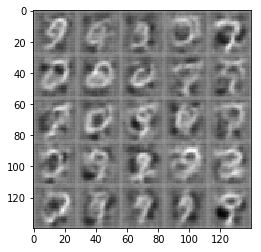

Epoch 2/2, batch 1100... Discriminator Loss: 1.0794... Generator Loss: 1.2349


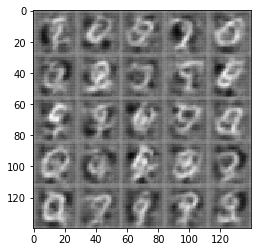

Epoch 2/2, batch 1200... Discriminator Loss: 0.9687... Generator Loss: 1.0817


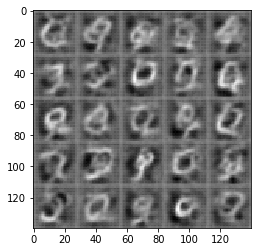

Epoch 2/2, batch 1300... Discriminator Loss: 1.0676... Generator Loss: 0.8561


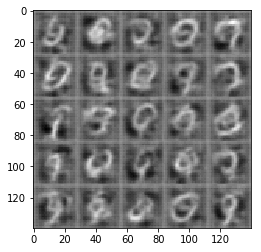

Epoch 2/2, batch 1400... Discriminator Loss: 1.0190... Generator Loss: 1.0786


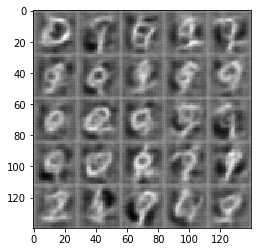

Epoch 2/2, batch 1500... Discriminator Loss: 1.1255... Generator Loss: 0.5292


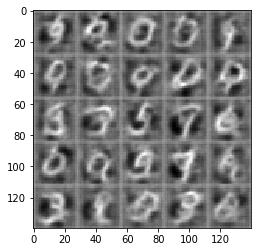

Epoch 2/2, batch 1600... Discriminator Loss: 1.1263... Generator Loss: 0.6038


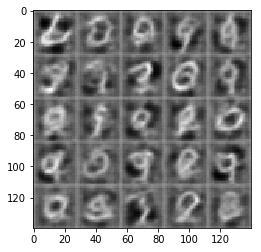

Epoch 2/2, batch 1700... Discriminator Loss: 1.0716... Generator Loss: 1.1906


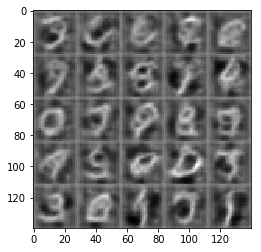

Epoch 2/2, batch 1800... Discriminator Loss: 1.1037... Generator Loss: 0.5678
batch_size is 64, beta1 is 0.2, alpha is 0.2,learning_rate is 0.0005


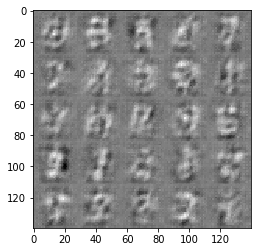

Epoch 1/2, batch 100... Discriminator Loss: 1.3813... Generator Loss: 0.5701


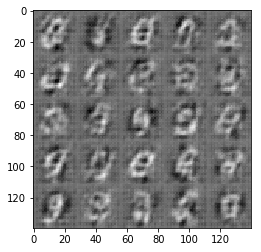

Epoch 1/2, batch 200... Discriminator Loss: 1.3765... Generator Loss: 0.5127


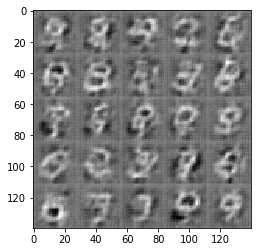

Epoch 1/2, batch 300... Discriminator Loss: 1.7473... Generator Loss: 0.2332


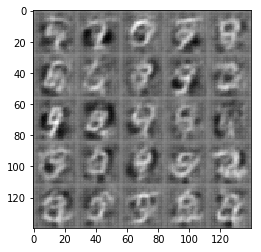

Epoch 1/2, batch 400... Discriminator Loss: 1.2088... Generator Loss: 0.7578


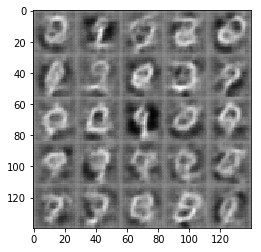

Epoch 1/2, batch 500... Discriminator Loss: 1.3502... Generator Loss: 0.8740


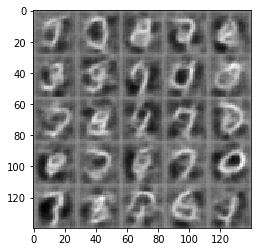

Epoch 1/2, batch 600... Discriminator Loss: 1.3090... Generator Loss: 0.4770


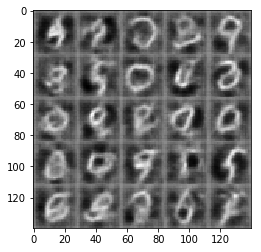

Epoch 1/2, batch 700... Discriminator Loss: 1.2358... Generator Loss: 0.9398


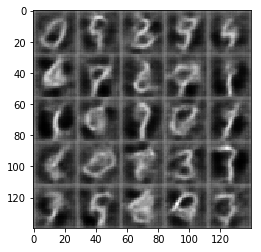

Epoch 1/2, batch 800... Discriminator Loss: 1.3814... Generator Loss: 1.0247


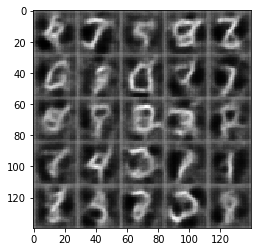

Epoch 1/2, batch 900... Discriminator Loss: 1.2944... Generator Loss: 0.6481


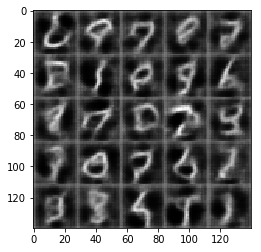

Epoch 2/2, batch 1000... Discriminator Loss: 1.2453... Generator Loss: 0.7162


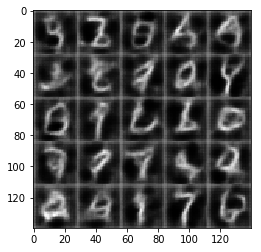

Epoch 2/2, batch 1100... Discriminator Loss: 1.2094... Generator Loss: 0.9500


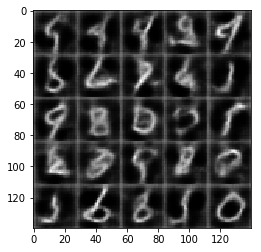

Epoch 2/2, batch 1200... Discriminator Loss: 1.1935... Generator Loss: 0.8644


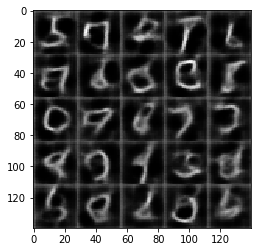

Epoch 2/2, batch 1300... Discriminator Loss: 1.5172... Generator Loss: 1.3874


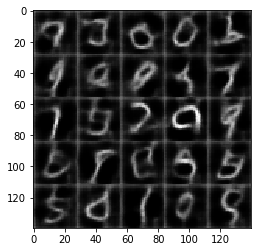

Epoch 2/2, batch 1400... Discriminator Loss: 1.1937... Generator Loss: 0.5785


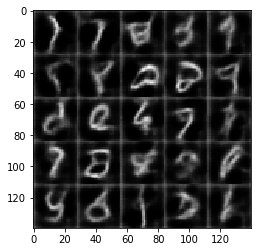

Epoch 2/2, batch 1500... Discriminator Loss: 1.3959... Generator Loss: 0.4093


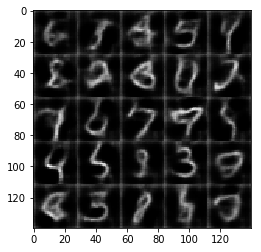

Epoch 2/2, batch 1600... Discriminator Loss: 1.1116... Generator Loss: 0.6534


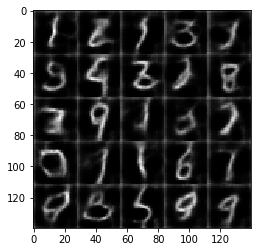

Epoch 2/2, batch 1700... Discriminator Loss: 1.1589... Generator Loss: 0.7239


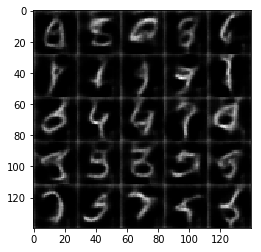

Epoch 2/2, batch 1800... Discriminator Loss: 1.1391... Generator Loss: 0.7128
batch_size is 64, beta1 is 0.2, alpha is 0.2,learning_rate is 0.001


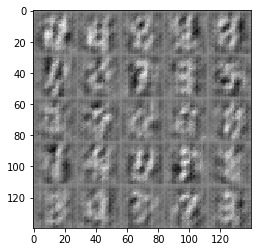

Epoch 1/2, batch 100... Discriminator Loss: 1.8671... Generator Loss: 0.2902


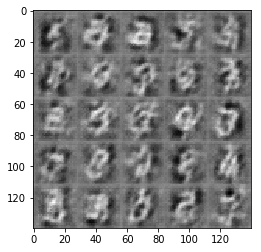

Epoch 1/2, batch 200... Discriminator Loss: 1.3981... Generator Loss: 0.4812


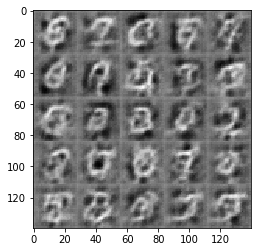

Epoch 1/2, batch 300... Discriminator Loss: 1.3368... Generator Loss: 0.8999


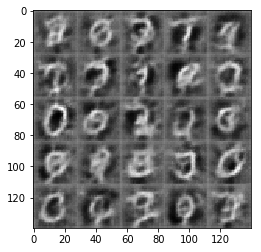

Epoch 1/2, batch 400... Discriminator Loss: 1.5889... Generator Loss: 0.2961


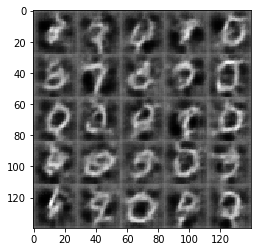

Epoch 1/2, batch 500... Discriminator Loss: 1.4130... Generator Loss: 1.0820


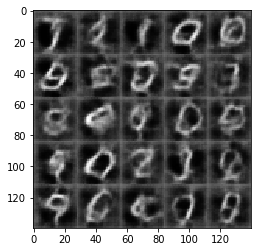

Epoch 1/2, batch 600... Discriminator Loss: 1.4713... Generator Loss: 1.2313


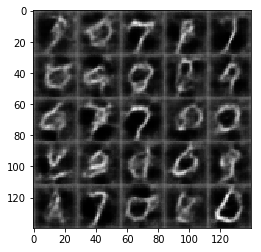

Epoch 1/2, batch 700... Discriminator Loss: 2.7090... Generator Loss: 0.0836


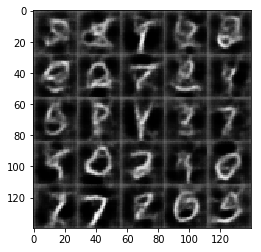

Epoch 1/2, batch 800... Discriminator Loss: 1.4690... Generator Loss: 0.3579


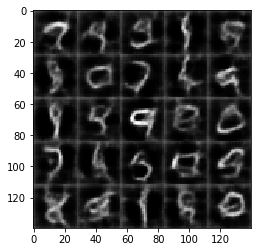

Epoch 1/2, batch 900... Discriminator Loss: 1.2869... Generator Loss: 0.7033


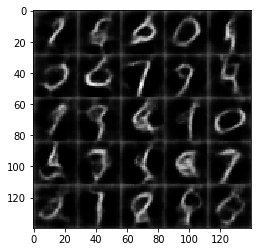

Epoch 2/2, batch 1000... Discriminator Loss: 1.4558... Generator Loss: 0.3795


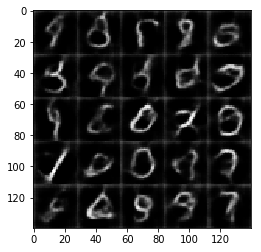

Epoch 2/2, batch 1100... Discriminator Loss: 1.7589... Generator Loss: 1.8012


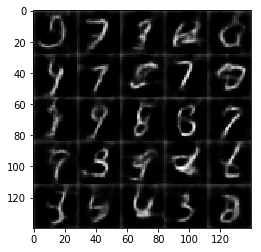

Epoch 2/2, batch 1200... Discriminator Loss: 1.4849... Generator Loss: 0.3288


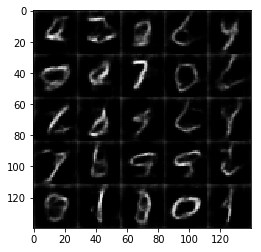

Epoch 2/2, batch 1300... Discriminator Loss: 1.6078... Generator Loss: 0.2774


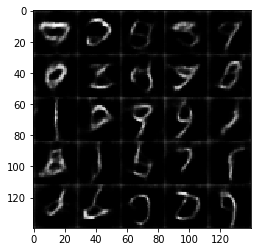

Epoch 2/2, batch 1400... Discriminator Loss: 1.1545... Generator Loss: 1.0900


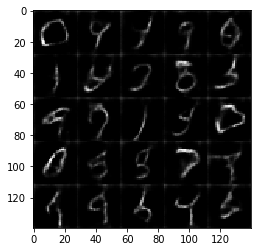

Epoch 2/2, batch 1500... Discriminator Loss: 1.2315... Generator Loss: 0.5328


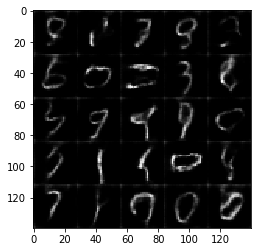

Epoch 2/2, batch 1600... Discriminator Loss: 1.2947... Generator Loss: 0.5010


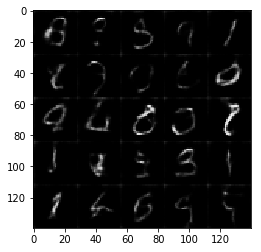

Epoch 2/2, batch 1700... Discriminator Loss: 1.2113... Generator Loss: 0.5234


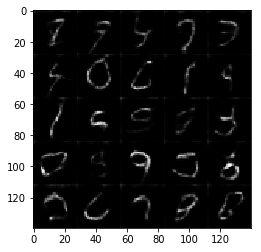

Epoch 2/2, batch 1800... Discriminator Loss: 1.2811... Generator Loss: 1.3418
batch_size is 64, beta1 is 0.2, alpha is 0.2,learning_rate is 0.0015


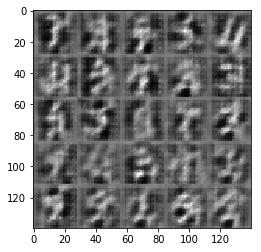

Epoch 1/2, batch 100... Discriminator Loss: 1.7867... Generator Loss: 0.3374


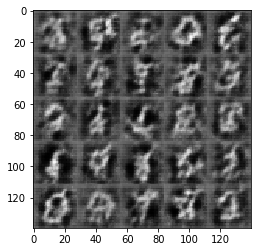

Epoch 1/2, batch 200... Discriminator Loss: 1.7039... Generator Loss: 0.2668


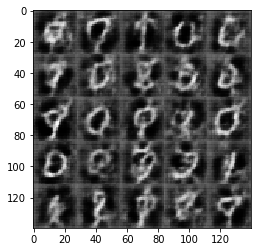

Epoch 1/2, batch 300... Discriminator Loss: 1.5387... Generator Loss: 1.3473


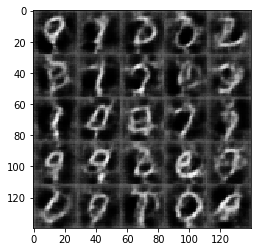

Epoch 1/2, batch 400... Discriminator Loss: 1.5174... Generator Loss: 0.9945


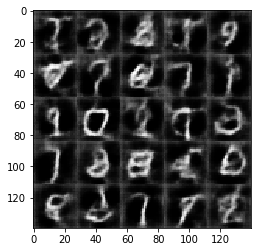

Epoch 1/2, batch 500... Discriminator Loss: 1.5196... Generator Loss: 0.3190


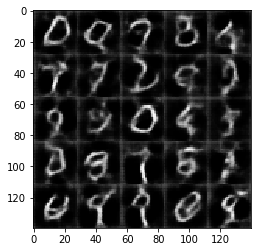

Epoch 1/2, batch 600... Discriminator Loss: 1.4260... Generator Loss: 0.3794


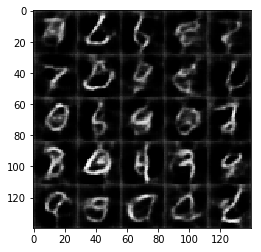

Epoch 1/2, batch 700... Discriminator Loss: 1.5502... Generator Loss: 0.3390


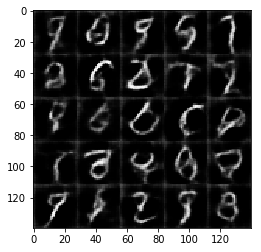

Epoch 1/2, batch 800... Discriminator Loss: 1.2584... Generator Loss: 0.8242


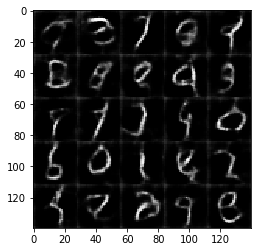

Epoch 1/2, batch 900... Discriminator Loss: 1.4494... Generator Loss: 0.3592


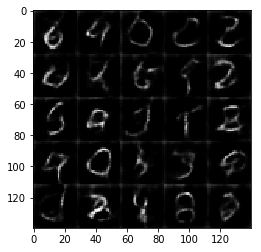

Epoch 2/2, batch 1000... Discriminator Loss: 1.6902... Generator Loss: 0.2503


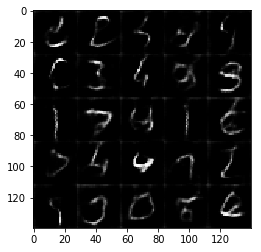

Epoch 2/2, batch 1100... Discriminator Loss: 1.2237... Generator Loss: 1.0184


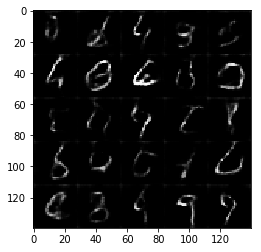

Epoch 2/2, batch 1200... Discriminator Loss: 1.4203... Generator Loss: 0.4089


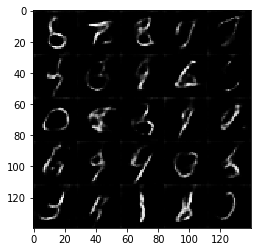

Epoch 2/2, batch 1300... Discriminator Loss: 1.1670... Generator Loss: 0.6293


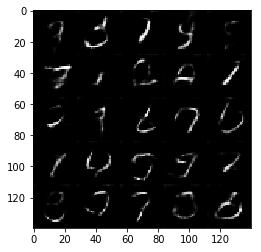

Epoch 2/2, batch 1400... Discriminator Loss: 1.0898... Generator Loss: 1.1908


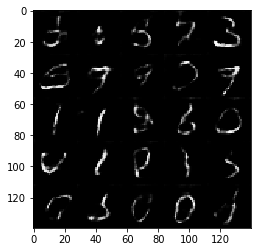

Epoch 2/2, batch 1500... Discriminator Loss: 1.4669... Generator Loss: 0.3433


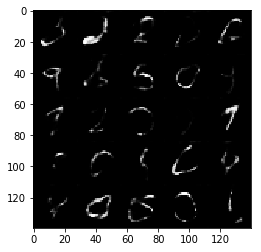

Epoch 2/2, batch 1600... Discriminator Loss: 1.1999... Generator Loss: 1.3549


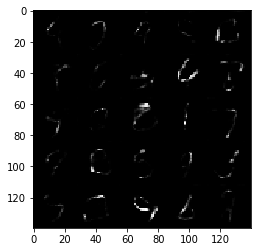

Epoch 2/2, batch 1700... Discriminator Loss: 1.7835... Generator Loss: 0.3043


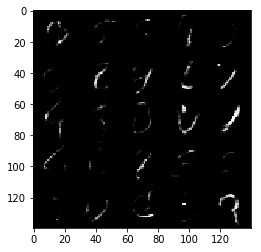

Epoch 2/2, batch 1800... Discriminator Loss: 1.1897... Generator Loss: 0.5507
batch_size is 64, beta1 is 0.2, alpha is 0.2,learning_rate is 0.002


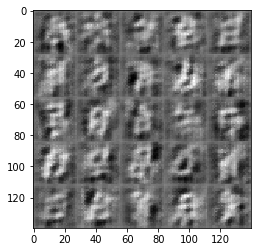

Epoch 1/2, batch 100... Discriminator Loss: 1.7545... Generator Loss: 0.7514


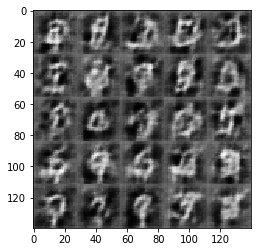

Epoch 1/2, batch 200... Discriminator Loss: 1.5927... Generator Loss: 0.3146


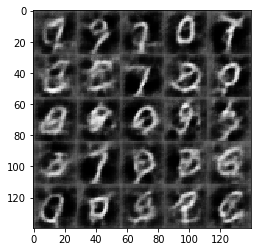

Epoch 1/2, batch 300... Discriminator Loss: 1.6783... Generator Loss: 0.2721


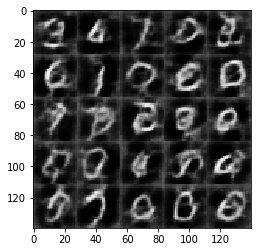

Epoch 1/2, batch 400... Discriminator Loss: 1.4102... Generator Loss: 1.0660


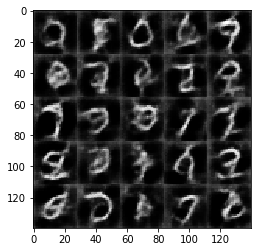

Epoch 1/2, batch 500... Discriminator Loss: 1.4473... Generator Loss: 0.3937


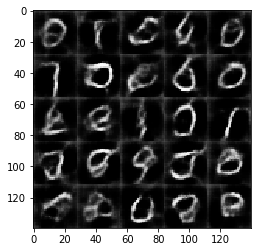

Epoch 1/2, batch 600... Discriminator Loss: 1.4836... Generator Loss: 0.3759


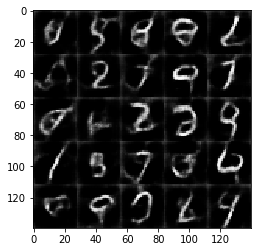

Epoch 1/2, batch 700... Discriminator Loss: 1.3754... Generator Loss: 0.4186


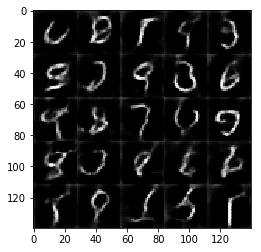

Epoch 1/2, batch 800... Discriminator Loss: 1.3322... Generator Loss: 0.5113


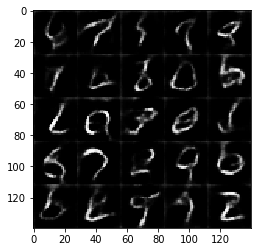

Epoch 1/2, batch 900... Discriminator Loss: 1.2950... Generator Loss: 0.5320


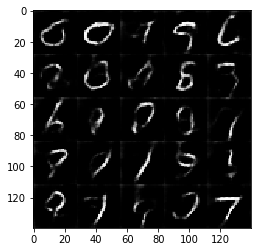

Epoch 2/2, batch 1000... Discriminator Loss: 1.2714... Generator Loss: 0.5044


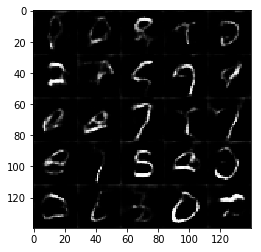

Epoch 2/2, batch 1100... Discriminator Loss: 1.1157... Generator Loss: 0.7909


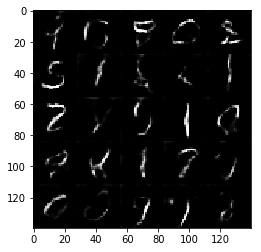

Epoch 2/2, batch 1200... Discriminator Loss: 1.1766... Generator Loss: 0.6863


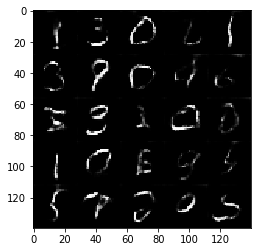

Epoch 2/2, batch 1300... Discriminator Loss: 1.2320... Generator Loss: 0.9814


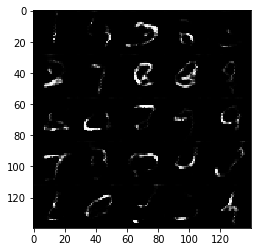

Epoch 2/2, batch 1400... Discriminator Loss: 1.4040... Generator Loss: 1.6576


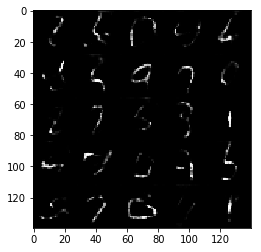

Epoch 2/2, batch 1500... Discriminator Loss: 1.2318... Generator Loss: 0.5723


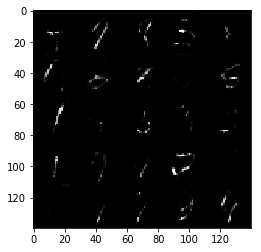

Epoch 2/2, batch 1600... Discriminator Loss: 1.3925... Generator Loss: 0.3602


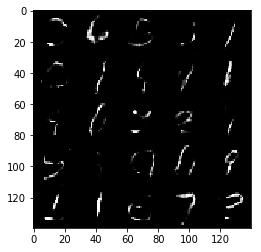

Epoch 2/2, batch 1700... Discriminator Loss: 1.0271... Generator Loss: 1.1663


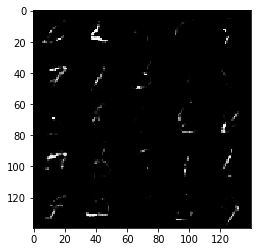

Epoch 2/2, batch 1800... Discriminator Loss: 1.2173... Generator Loss: 0.5933
batch_size is 64, beta1 is 0.4, alpha is 0.1,learning_rate is 0.0001


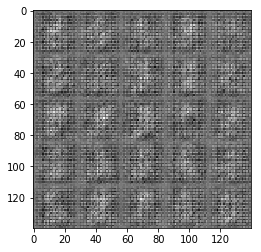

Epoch 1/2, batch 100... Discriminator Loss: 0.5829... Generator Loss: 1.2331


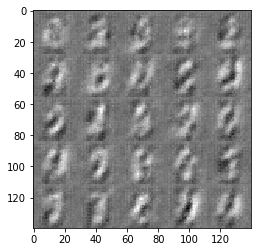

Epoch 1/2, batch 200... Discriminator Loss: 0.8938... Generator Loss: 0.8877


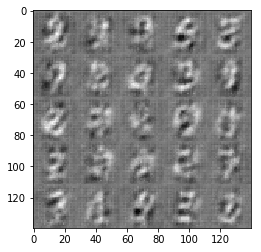

Epoch 1/2, batch 300... Discriminator Loss: 1.0355... Generator Loss: 0.7422


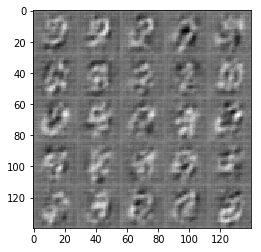

Epoch 1/2, batch 400... Discriminator Loss: 0.9702... Generator Loss: 0.6993


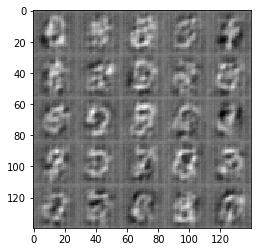

Epoch 1/2, batch 500... Discriminator Loss: 1.0336... Generator Loss: 0.8520


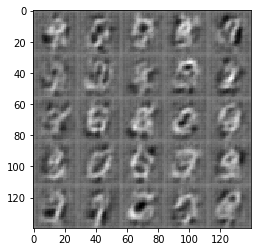

Epoch 1/2, batch 600... Discriminator Loss: 0.9823... Generator Loss: 0.9350


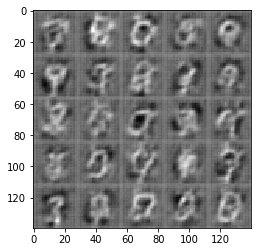

Epoch 1/2, batch 700... Discriminator Loss: 0.9314... Generator Loss: 1.2400


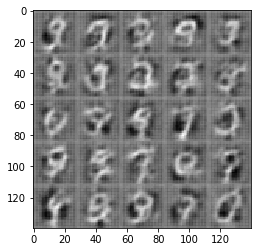

Epoch 1/2, batch 800... Discriminator Loss: 0.9854... Generator Loss: 1.0782


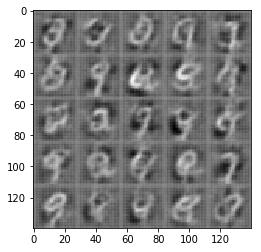

Epoch 1/2, batch 900... Discriminator Loss: 1.0869... Generator Loss: 0.7226


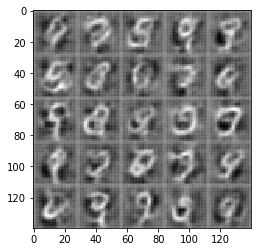

Epoch 2/2, batch 1000... Discriminator Loss: 1.0303... Generator Loss: 0.7207


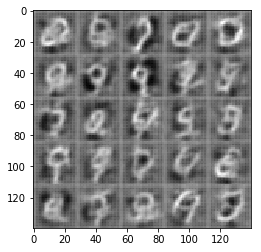

Epoch 2/2, batch 1100... Discriminator Loss: 0.9028... Generator Loss: 1.2235


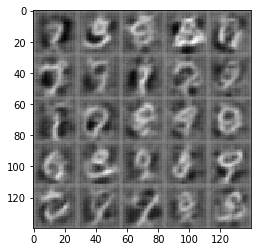

Epoch 2/2, batch 1200... Discriminator Loss: 0.9446... Generator Loss: 0.7977


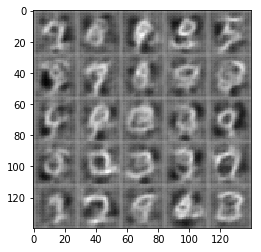

Epoch 2/2, batch 1300... Discriminator Loss: 0.9687... Generator Loss: 0.9763


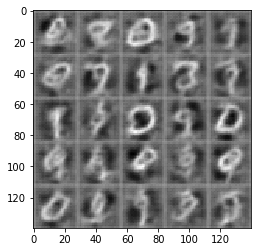

Epoch 2/2, batch 1400... Discriminator Loss: 1.0136... Generator Loss: 1.3542


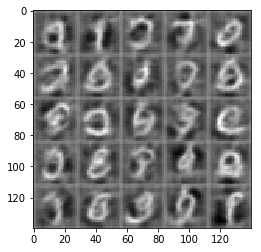

Epoch 2/2, batch 1500... Discriminator Loss: 0.9964... Generator Loss: 0.6990


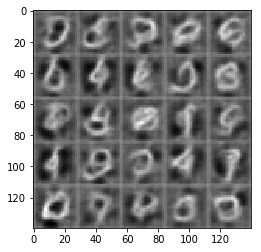

Epoch 2/2, batch 1600... Discriminator Loss: 0.9596... Generator Loss: 1.0238


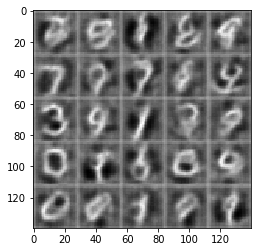

Epoch 2/2, batch 1700... Discriminator Loss: 0.9682... Generator Loss: 0.6767


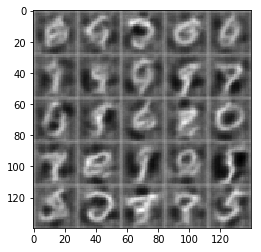

Epoch 2/2, batch 1800... Discriminator Loss: 0.9319... Generator Loss: 1.2092
batch_size is 64, beta1 is 0.4, alpha is 0.1,learning_rate is 0.0005


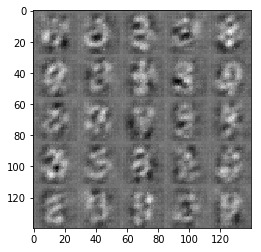

Epoch 1/2, batch 100... Discriminator Loss: 1.3367... Generator Loss: 0.6501


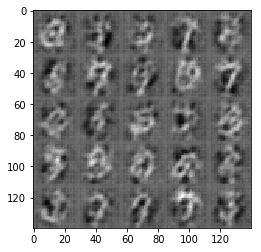

Epoch 1/2, batch 200... Discriminator Loss: 1.1015... Generator Loss: 1.2125


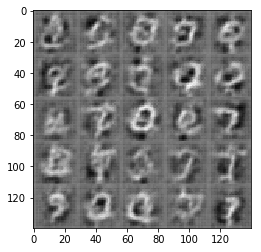

Epoch 1/2, batch 300... Discriminator Loss: 1.2888... Generator Loss: 0.4429


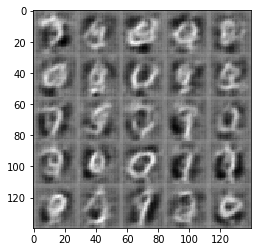

Epoch 1/2, batch 400... Discriminator Loss: 1.2182... Generator Loss: 0.5282


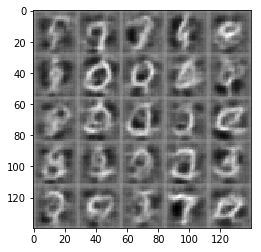

Epoch 1/2, batch 500... Discriminator Loss: 1.1818... Generator Loss: 1.1600


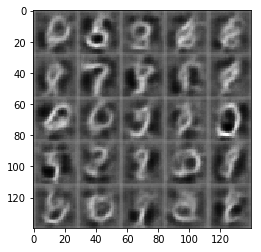

Epoch 1/2, batch 600... Discriminator Loss: 1.3088... Generator Loss: 1.2424


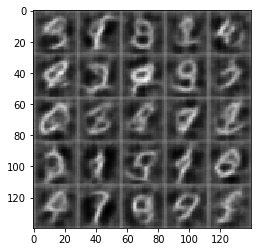

Epoch 1/2, batch 700... Discriminator Loss: 1.0928... Generator Loss: 0.6333


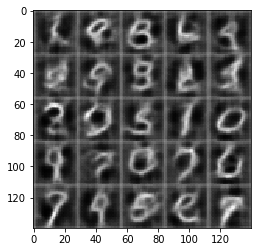

Epoch 1/2, batch 800... Discriminator Loss: 1.0533... Generator Loss: 0.8651


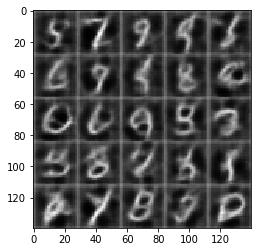

Epoch 1/2, batch 900... Discriminator Loss: 1.1583... Generator Loss: 0.5931


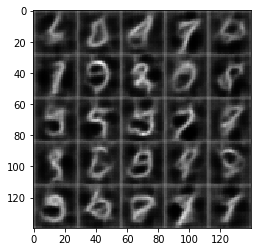

Epoch 2/2, batch 1000... Discriminator Loss: 1.5332... Generator Loss: 0.3076


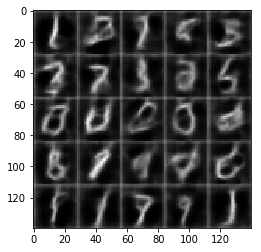

Epoch 2/2, batch 1100... Discriminator Loss: 1.0791... Generator Loss: 0.6126


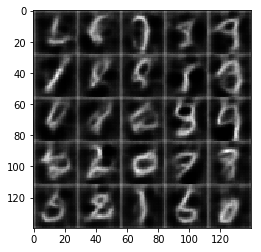

Epoch 2/2, batch 1200... Discriminator Loss: 1.1680... Generator Loss: 0.5345


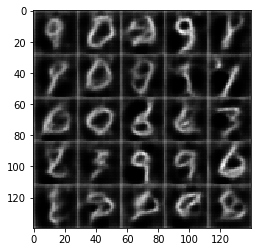

Epoch 2/2, batch 1300... Discriminator Loss: 0.9415... Generator Loss: 0.8487


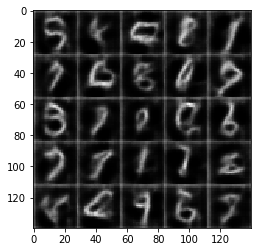

Epoch 2/2, batch 1400... Discriminator Loss: 0.9508... Generator Loss: 1.1680


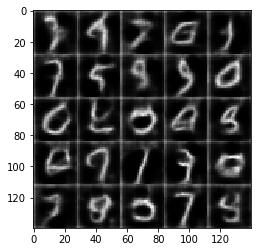

Epoch 2/2, batch 1500... Discriminator Loss: 1.2537... Generator Loss: 0.4494


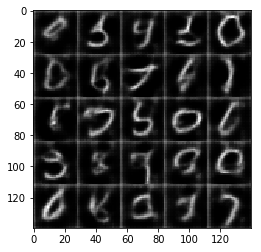

Epoch 2/2, batch 1600... Discriminator Loss: 2.6200... Generator Loss: 0.1052


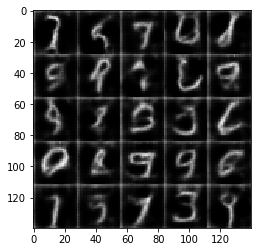

Epoch 2/2, batch 1700... Discriminator Loss: 0.9849... Generator Loss: 1.0414


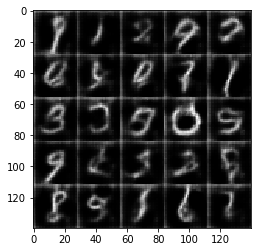

Epoch 2/2, batch 1800... Discriminator Loss: 1.0746... Generator Loss: 0.7881
batch_size is 64, beta1 is 0.4, alpha is 0.1,learning_rate is 0.001


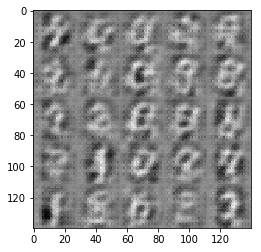

Epoch 1/2, batch 100... Discriminator Loss: 1.5391... Generator Loss: 0.4717


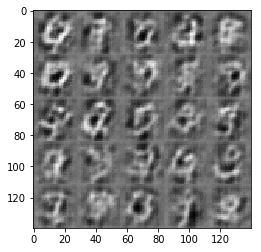

Epoch 1/2, batch 200... Discriminator Loss: 1.3658... Generator Loss: 1.3710


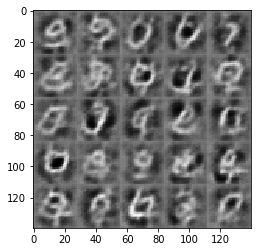

Epoch 1/2, batch 300... Discriminator Loss: 1.4770... Generator Loss: 0.3676


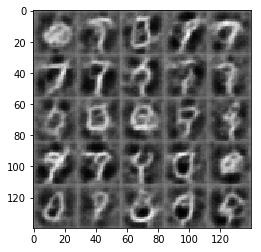

Epoch 1/2, batch 400... Discriminator Loss: 1.2170... Generator Loss: 0.6174


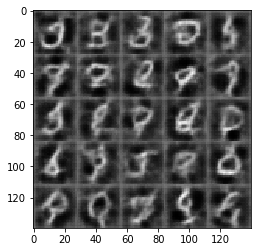

Epoch 1/2, batch 500... Discriminator Loss: 1.2366... Generator Loss: 0.6196


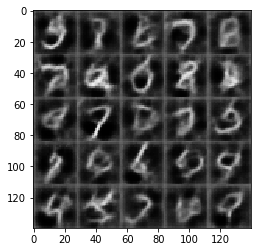

Epoch 1/2, batch 600... Discriminator Loss: 1.2542... Generator Loss: 0.6203


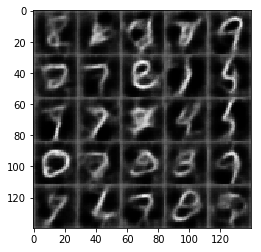

Epoch 1/2, batch 700... Discriminator Loss: 1.1987... Generator Loss: 0.8482


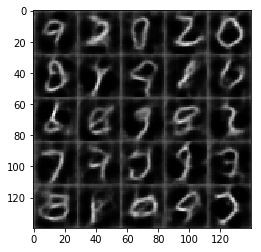

Epoch 1/2, batch 800... Discriminator Loss: 1.2043... Generator Loss: 1.2918


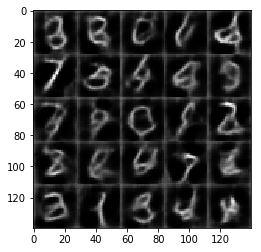

Epoch 1/2, batch 900... Discriminator Loss: 1.6502... Generator Loss: 0.2711


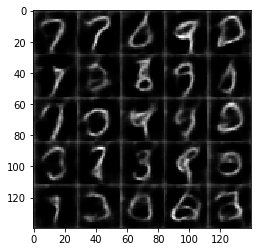

Epoch 2/2, batch 1000... Discriminator Loss: 1.8353... Generator Loss: 2.2980


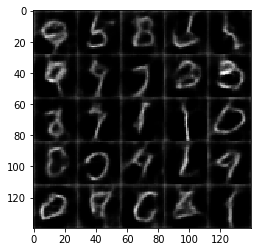

Epoch 2/2, batch 1100... Discriminator Loss: 1.2357... Generator Loss: 0.6119


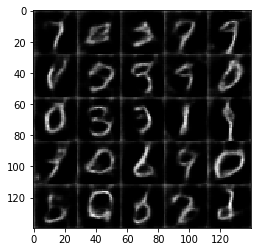

Epoch 2/2, batch 1200... Discriminator Loss: 1.2174... Generator Loss: 0.6766


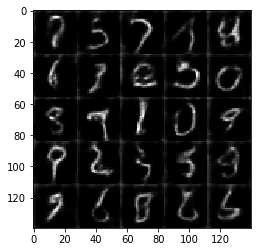

Epoch 2/2, batch 1300... Discriminator Loss: 0.9907... Generator Loss: 1.2894


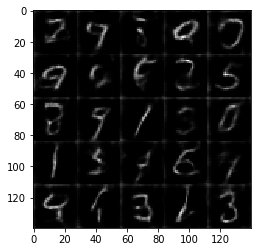

Epoch 2/2, batch 1400... Discriminator Loss: 0.9886... Generator Loss: 0.9736


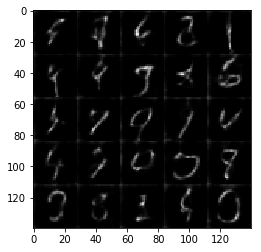

Epoch 2/2, batch 1500... Discriminator Loss: 1.1196... Generator Loss: 0.5551


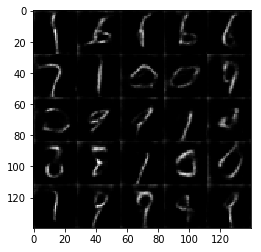

Epoch 2/2, batch 1600... Discriminator Loss: 0.9459... Generator Loss: 1.0615


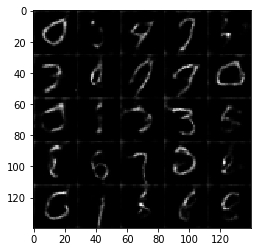

Epoch 2/2, batch 1700... Discriminator Loss: 0.8342... Generator Loss: 1.0150


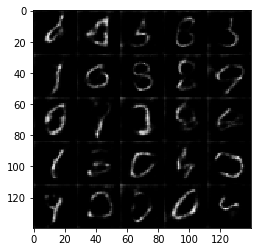

Epoch 2/2, batch 1800... Discriminator Loss: 1.3334... Generator Loss: 1.6853
batch_size is 64, beta1 is 0.4, alpha is 0.1,learning_rate is 0.0015


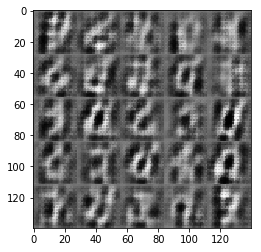

Epoch 1/2, batch 100... Discriminator Loss: 2.2247... Generator Loss: 0.1677


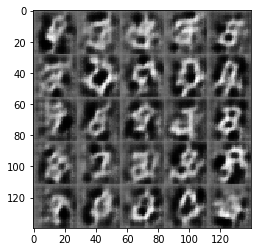

Epoch 1/2, batch 200... Discriminator Loss: 1.5485... Generator Loss: 1.1903


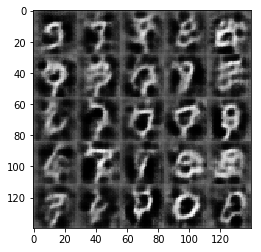

Epoch 1/2, batch 300... Discriminator Loss: 1.3060... Generator Loss: 0.4342


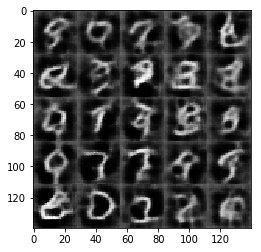

Epoch 1/2, batch 400... Discriminator Loss: 1.3620... Generator Loss: 0.4974


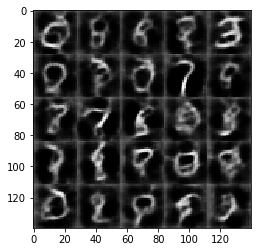

Epoch 1/2, batch 500... Discriminator Loss: 1.2400... Generator Loss: 0.5996


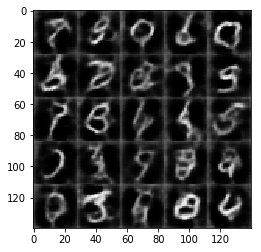

Epoch 1/2, batch 600... Discriminator Loss: 1.2704... Generator Loss: 1.0196


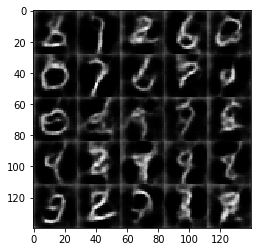

Epoch 1/2, batch 700... Discriminator Loss: 1.2518... Generator Loss: 0.9849


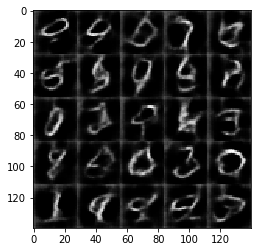

Epoch 1/2, batch 800... Discriminator Loss: 1.3455... Generator Loss: 1.2321


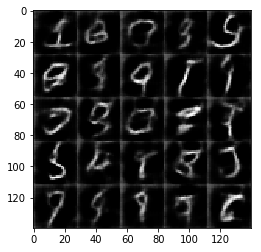

Epoch 1/2, batch 900... Discriminator Loss: 1.1581... Generator Loss: 0.6974


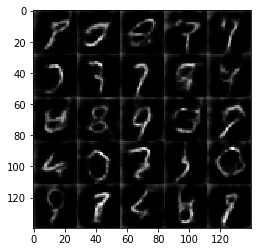

Epoch 2/2, batch 1000... Discriminator Loss: 1.1038... Generator Loss: 0.7335


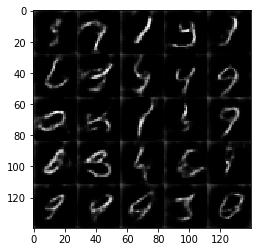

Epoch 2/2, batch 1100... Discriminator Loss: 1.3721... Generator Loss: 0.3824


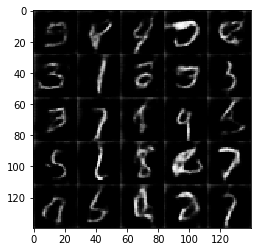

Epoch 2/2, batch 1200... Discriminator Loss: 1.3502... Generator Loss: 1.2987


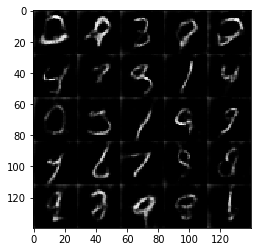

Epoch 2/2, batch 1300... Discriminator Loss: 1.1360... Generator Loss: 1.5251


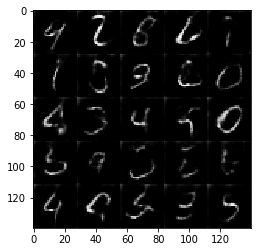

Epoch 2/2, batch 1400... Discriminator Loss: 1.2144... Generator Loss: 0.4638


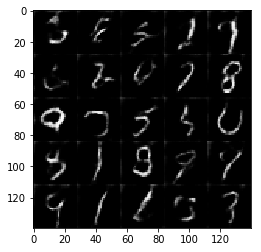

Epoch 2/2, batch 1500... Discriminator Loss: 1.7527... Generator Loss: 0.2473


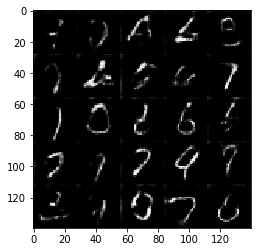

Epoch 2/2, batch 1600... Discriminator Loss: 1.1326... Generator Loss: 0.5330


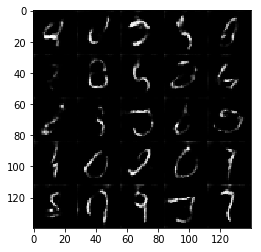

Epoch 2/2, batch 1700... Discriminator Loss: 1.1021... Generator Loss: 0.7987


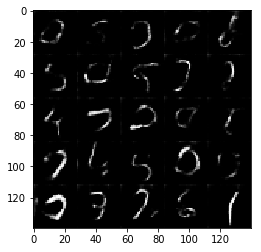

Epoch 2/2, batch 1800... Discriminator Loss: 1.0630... Generator Loss: 0.9611
batch_size is 64, beta1 is 0.4, alpha is 0.1,learning_rate is 0.002


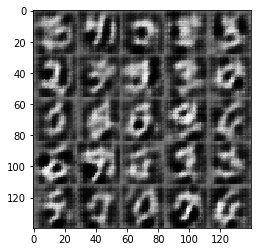

Epoch 1/2, batch 100... Discriminator Loss: 1.4788... Generator Loss: 0.8580


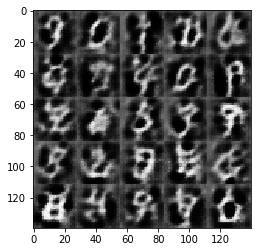

Epoch 1/2, batch 200... Discriminator Loss: 1.4889... Generator Loss: 0.4163


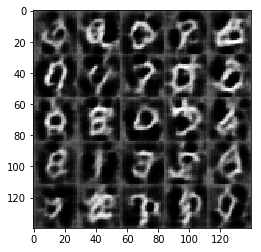

Epoch 1/2, batch 300... Discriminator Loss: 1.4856... Generator Loss: 0.3792


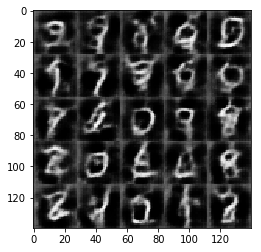

Epoch 1/2, batch 400... Discriminator Loss: 1.8464... Generator Loss: 0.2152


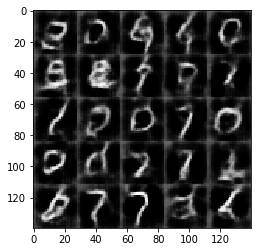

Epoch 1/2, batch 500... Discriminator Loss: 1.2624... Generator Loss: 0.9406


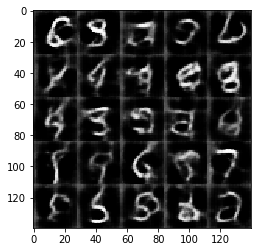

Epoch 1/2, batch 600... Discriminator Loss: 1.3962... Generator Loss: 0.6879


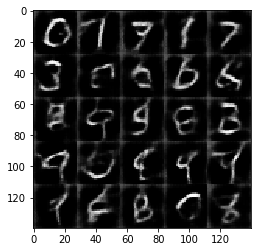

Epoch 1/2, batch 700... Discriminator Loss: 1.2812... Generator Loss: 0.5743


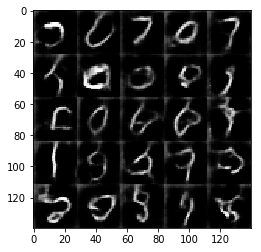

Epoch 1/2, batch 800... Discriminator Loss: 1.3438... Generator Loss: 1.0022


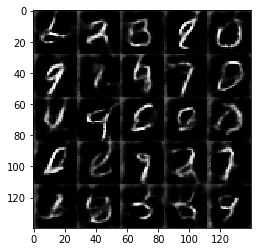

Epoch 1/2, batch 900... Discriminator Loss: 1.3476... Generator Loss: 0.8846


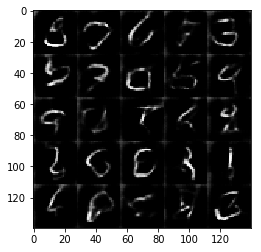

Epoch 2/2, batch 1000... Discriminator Loss: 1.3642... Generator Loss: 0.4174


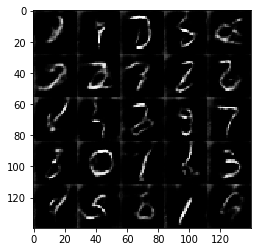

Epoch 2/2, batch 1100... Discriminator Loss: 1.2190... Generator Loss: 0.7161


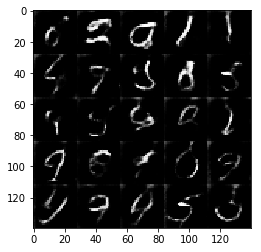

Epoch 2/2, batch 1200... Discriminator Loss: 1.2080... Generator Loss: 0.8939


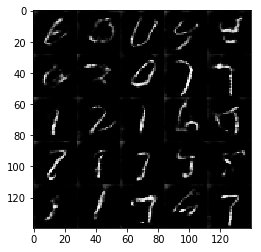

Epoch 2/2, batch 1300... Discriminator Loss: 1.6666... Generator Loss: 0.2618


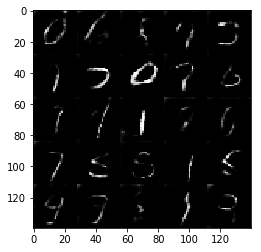

Epoch 2/2, batch 1400... Discriminator Loss: 1.1482... Generator Loss: 1.0116


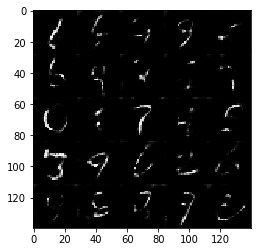

Epoch 2/2, batch 1500... Discriminator Loss: 1.1360... Generator Loss: 0.7305


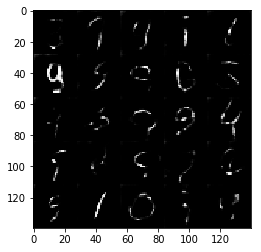

Epoch 2/2, batch 1600... Discriminator Loss: 1.2921... Generator Loss: 0.6067


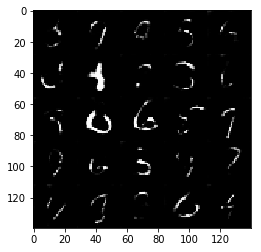

Epoch 2/2, batch 1700... Discriminator Loss: 1.2075... Generator Loss: 0.6709


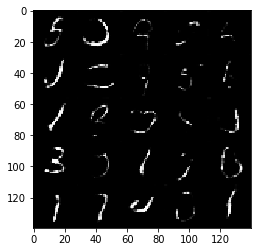

Epoch 2/2, batch 1800... Discriminator Loss: 1.2053... Generator Loss: 0.6721
batch_size is 64, beta1 is 0.4, alpha is 0.2,learning_rate is 0.0001


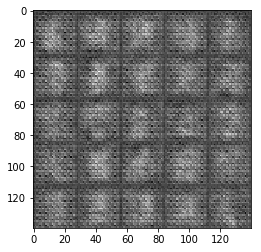

Epoch 1/2, batch 100... Discriminator Loss: 0.8551... Generator Loss: 0.9047


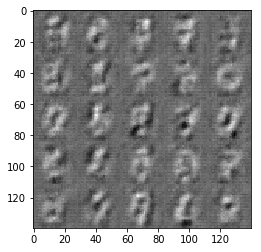

Epoch 1/2, batch 200... Discriminator Loss: 0.9702... Generator Loss: 1.2318


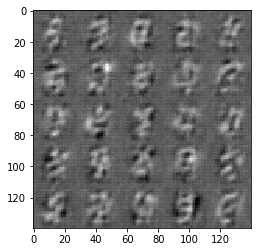

Epoch 1/2, batch 300... Discriminator Loss: 0.9970... Generator Loss: 0.8854


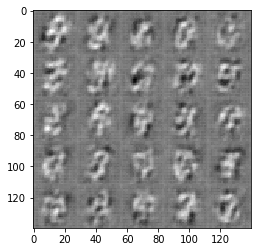

Epoch 1/2, batch 400... Discriminator Loss: 1.0588... Generator Loss: 0.6360


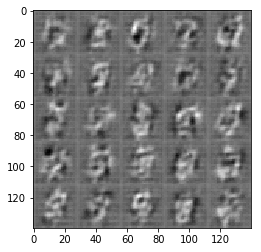

Epoch 1/2, batch 500... Discriminator Loss: 0.9729... Generator Loss: 0.8449


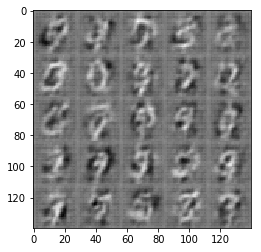

Epoch 1/2, batch 600... Discriminator Loss: 0.9825... Generator Loss: 1.2050


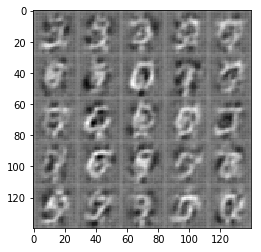

Epoch 1/2, batch 700... Discriminator Loss: 0.9676... Generator Loss: 1.0385


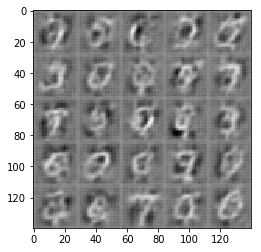

Epoch 1/2, batch 800... Discriminator Loss: 0.9758... Generator Loss: 0.8332


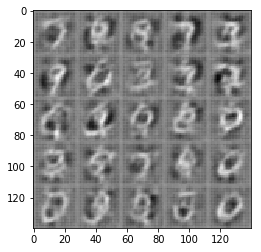

Epoch 1/2, batch 900... Discriminator Loss: 1.0408... Generator Loss: 0.7859


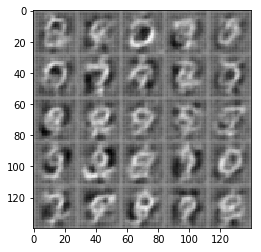

Epoch 2/2, batch 1000... Discriminator Loss: 1.0380... Generator Loss: 0.8008


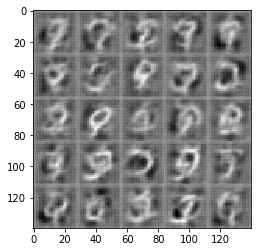

Epoch 2/2, batch 1100... Discriminator Loss: 0.8645... Generator Loss: 1.0635


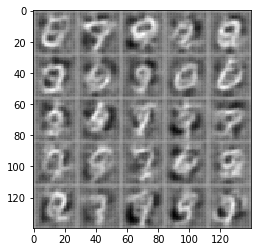

Epoch 2/2, batch 1200... Discriminator Loss: 0.9145... Generator Loss: 0.8368


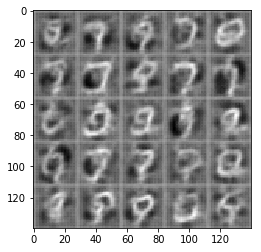

Epoch 2/2, batch 1300... Discriminator Loss: 1.0108... Generator Loss: 0.7473


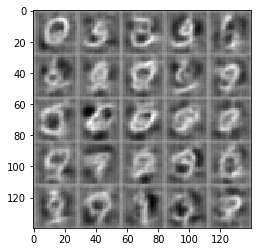

Epoch 2/2, batch 1400... Discriminator Loss: 0.9817... Generator Loss: 1.3840


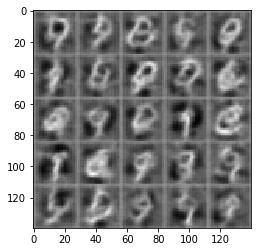

Epoch 2/2, batch 1500... Discriminator Loss: 1.0100... Generator Loss: 0.6514


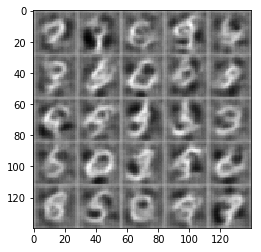

Epoch 2/2, batch 1600... Discriminator Loss: 0.8896... Generator Loss: 1.2715


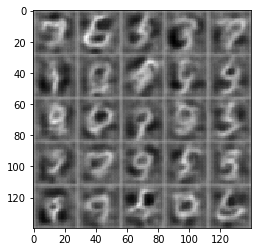

Epoch 2/2, batch 1700... Discriminator Loss: 0.9930... Generator Loss: 0.7980


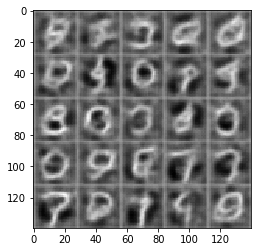

Epoch 2/2, batch 1800... Discriminator Loss: 0.9195... Generator Loss: 1.0750
batch_size is 64, beta1 is 0.4, alpha is 0.2,learning_rate is 0.0005


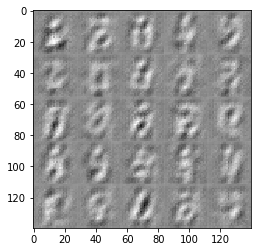

Epoch 1/2, batch 100... Discriminator Loss: 1.2995... Generator Loss: 0.5675


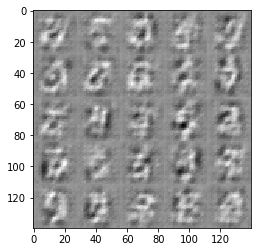

Epoch 1/2, batch 200... Discriminator Loss: 1.1868... Generator Loss: 0.9957


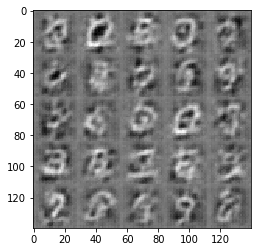

Epoch 1/2, batch 300... Discriminator Loss: 1.3049... Generator Loss: 0.4751


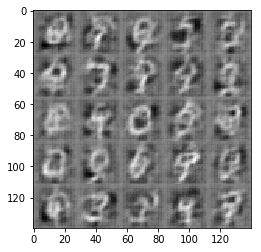

Epoch 1/2, batch 400... Discriminator Loss: 1.1493... Generator Loss: 0.6582


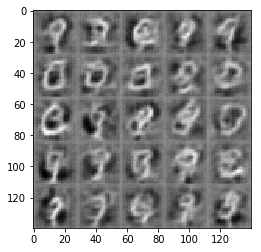

Epoch 1/2, batch 500... Discriminator Loss: 1.2165... Generator Loss: 0.5533


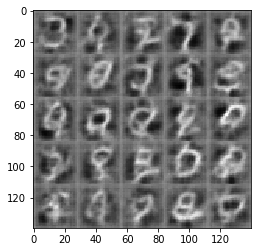

Epoch 1/2, batch 600... Discriminator Loss: 1.1626... Generator Loss: 0.8364


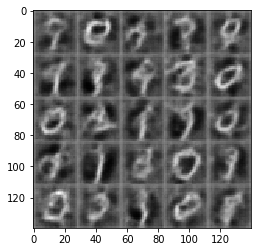

Epoch 1/2, batch 700... Discriminator Loss: 1.0709... Generator Loss: 1.1235


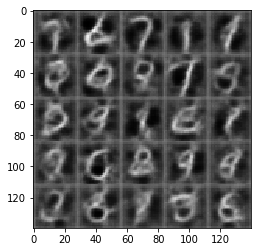

Epoch 1/2, batch 800... Discriminator Loss: 1.1277... Generator Loss: 0.6852


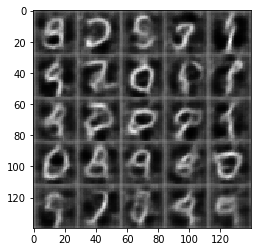

Epoch 1/2, batch 900... Discriminator Loss: 1.3489... Generator Loss: 0.4532


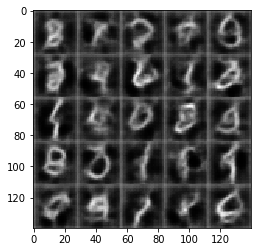

Epoch 2/2, batch 1000... Discriminator Loss: 1.2626... Generator Loss: 0.4649


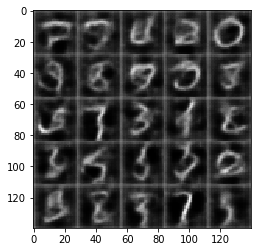

Epoch 2/2, batch 1100... Discriminator Loss: 1.0273... Generator Loss: 0.8449


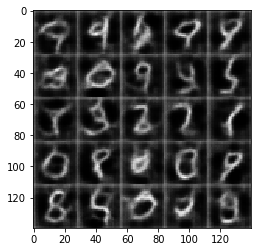

Epoch 2/2, batch 1200... Discriminator Loss: 1.0572... Generator Loss: 0.6741


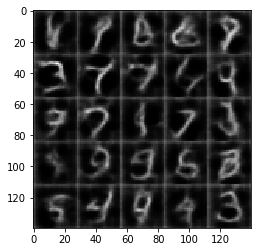

Epoch 2/2, batch 1300... Discriminator Loss: 1.0506... Generator Loss: 0.8184


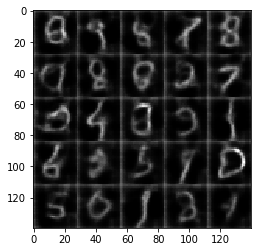

Epoch 2/2, batch 1400... Discriminator Loss: 1.3362... Generator Loss: 1.7216


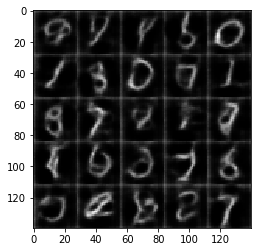

Epoch 2/2, batch 1500... Discriminator Loss: 1.0616... Generator Loss: 0.6830


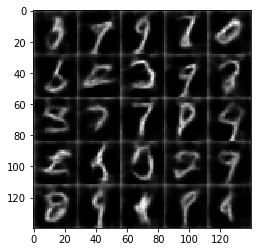

Epoch 2/2, batch 1600... Discriminator Loss: 0.9702... Generator Loss: 0.9614


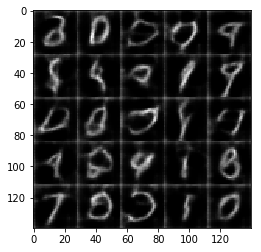

Epoch 2/2, batch 1700... Discriminator Loss: 1.0500... Generator Loss: 0.9105


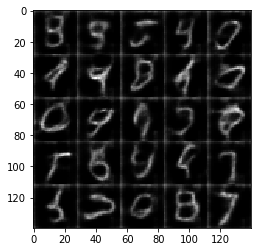

Epoch 2/2, batch 1800... Discriminator Loss: 1.3654... Generator Loss: 0.4879
batch_size is 64, beta1 is 0.4, alpha is 0.2,learning_rate is 0.001


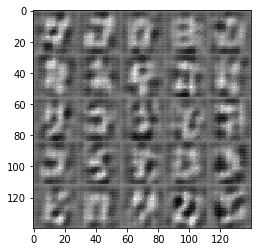

Epoch 1/2, batch 100... Discriminator Loss: 1.3659... Generator Loss: 1.2545


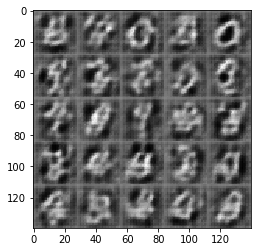

Epoch 1/2, batch 200... Discriminator Loss: 1.5593... Generator Loss: 1.6564


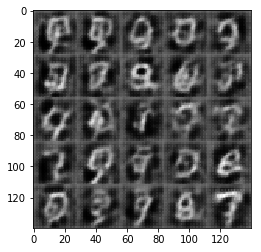

Epoch 1/2, batch 300... Discriminator Loss: 1.3176... Generator Loss: 0.5127


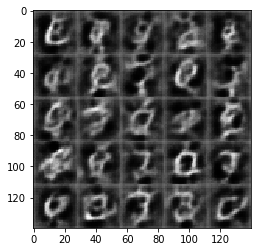

Epoch 1/2, batch 400... Discriminator Loss: 1.2282... Generator Loss: 1.0023


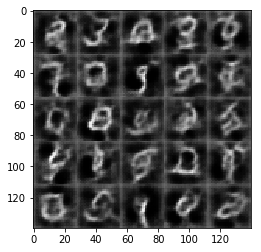

Epoch 1/2, batch 500... Discriminator Loss: 1.3111... Generator Loss: 0.7182


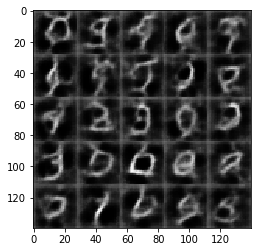

Epoch 1/2, batch 600... Discriminator Loss: 1.4189... Generator Loss: 1.3288


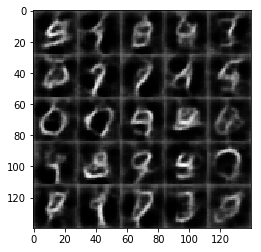

Epoch 1/2, batch 700... Discriminator Loss: 1.0830... Generator Loss: 1.1724


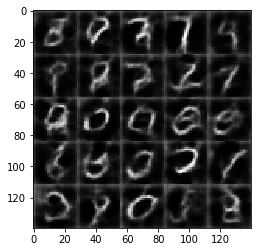

Epoch 1/2, batch 800... Discriminator Loss: 1.2395... Generator Loss: 0.8060


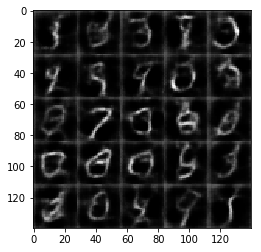

Epoch 1/2, batch 900... Discriminator Loss: 1.3271... Generator Loss: 1.0972


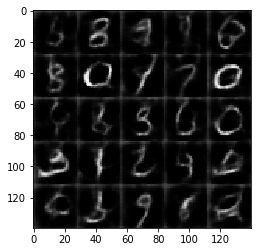

Epoch 2/2, batch 1000... Discriminator Loss: 1.3363... Generator Loss: 1.0060


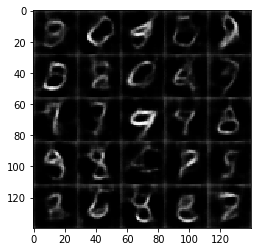

Epoch 2/2, batch 1100... Discriminator Loss: 1.2483... Generator Loss: 0.5021


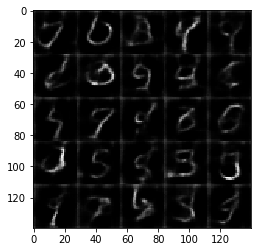

Epoch 2/2, batch 1200... Discriminator Loss: 1.2659... Generator Loss: 0.5130


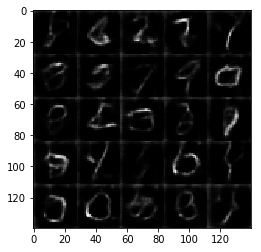

Epoch 2/2, batch 1300... Discriminator Loss: 1.1566... Generator Loss: 0.8672


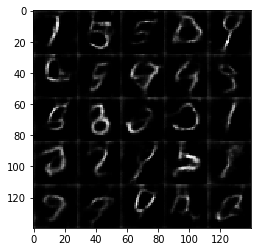

Epoch 2/2, batch 1400... Discriminator Loss: 1.0515... Generator Loss: 1.1536


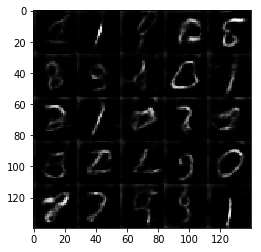

Epoch 2/2, batch 1500... Discriminator Loss: 1.2927... Generator Loss: 0.4685


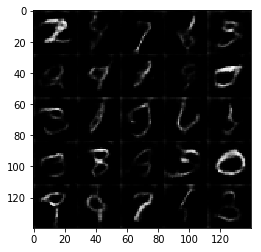

Epoch 2/2, batch 1600... Discriminator Loss: 1.2518... Generator Loss: 1.4693


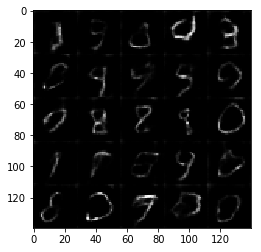

Epoch 2/2, batch 1700... Discriminator Loss: 1.0855... Generator Loss: 0.9895


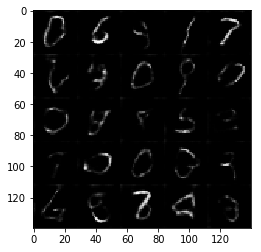

Epoch 2/2, batch 1800... Discriminator Loss: 1.4898... Generator Loss: 0.3194
batch_size is 64, beta1 is 0.4, alpha is 0.2,learning_rate is 0.0015


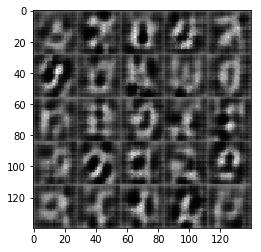

Epoch 1/2, batch 100... Discriminator Loss: 1.9139... Generator Loss: 1.8996


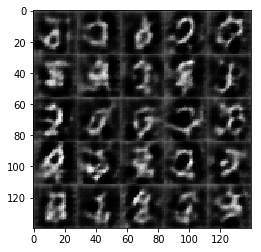

Epoch 1/2, batch 200... Discriminator Loss: 1.3978... Generator Loss: 1.3038


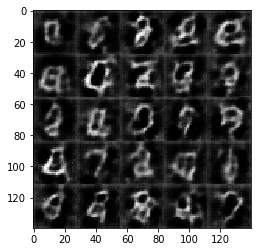

Epoch 1/2, batch 300... Discriminator Loss: 1.5018... Generator Loss: 0.3444


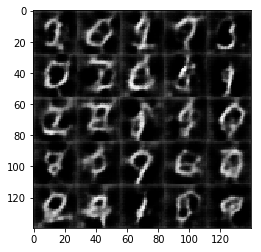

Epoch 1/2, batch 400... Discriminator Loss: 1.3474... Generator Loss: 1.3678


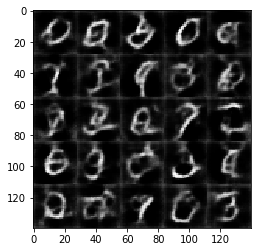

Epoch 1/2, batch 500... Discriminator Loss: 1.5384... Generator Loss: 0.3607


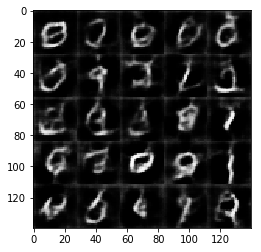

Epoch 1/2, batch 600... Discriminator Loss: 1.2826... Generator Loss: 0.5097


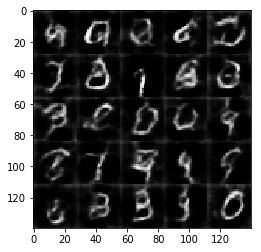

Epoch 1/2, batch 700... Discriminator Loss: 1.1308... Generator Loss: 1.0036


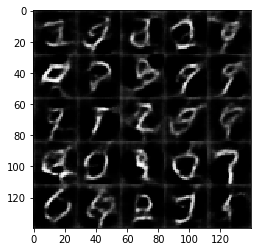

Epoch 1/2, batch 800... Discriminator Loss: 1.1597... Generator Loss: 0.7256


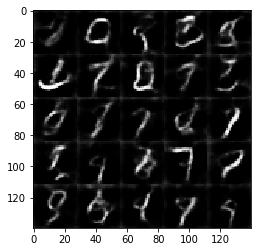

Epoch 1/2, batch 900... Discriminator Loss: 1.3357... Generator Loss: 0.4695


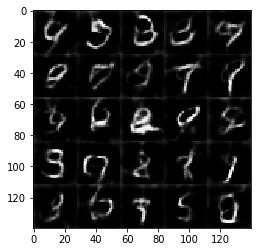

Epoch 2/2, batch 1000... Discriminator Loss: 1.2362... Generator Loss: 0.8190


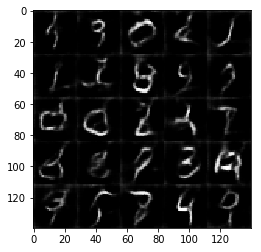

Epoch 2/2, batch 1100... Discriminator Loss: 1.2050... Generator Loss: 0.5831


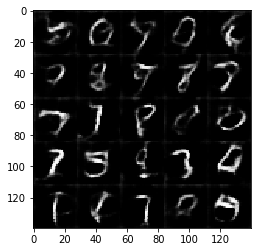

Epoch 2/2, batch 1200... Discriminator Loss: 1.6548... Generator Loss: 0.3167


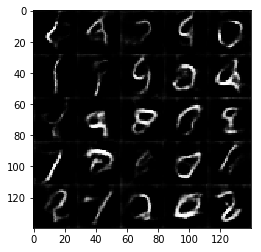

Epoch 2/2, batch 1300... Discriminator Loss: 1.2048... Generator Loss: 0.5149


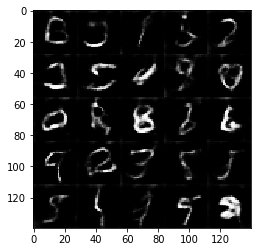

Epoch 2/2, batch 1400... Discriminator Loss: 1.1633... Generator Loss: 1.2865


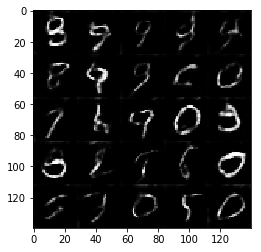

Epoch 2/2, batch 1500... Discriminator Loss: 1.2020... Generator Loss: 0.5687


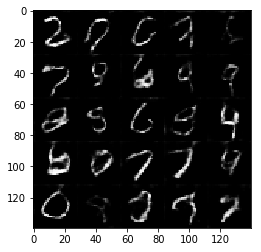

Epoch 2/2, batch 1600... Discriminator Loss: 1.3072... Generator Loss: 0.9193


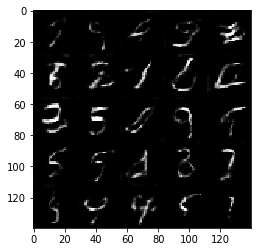

Epoch 2/2, batch 1700... Discriminator Loss: 1.1798... Generator Loss: 0.6336


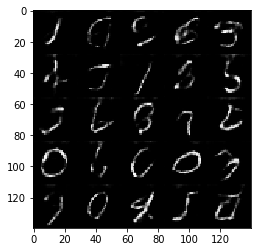

Epoch 2/2, batch 1800... Discriminator Loss: 1.1883... Generator Loss: 0.7269
batch_size is 64, beta1 is 0.4, alpha is 0.2,learning_rate is 0.002


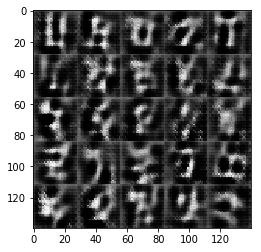

Epoch 1/2, batch 100... Discriminator Loss: 1.5255... Generator Loss: 0.5843


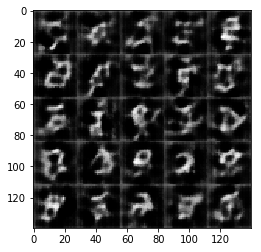

Epoch 1/2, batch 200... Discriminator Loss: 1.2981... Generator Loss: 0.5449


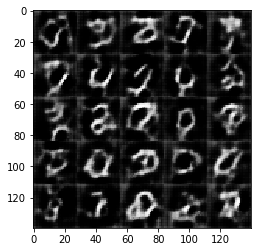

Epoch 1/2, batch 300... Discriminator Loss: 1.2334... Generator Loss: 0.9697


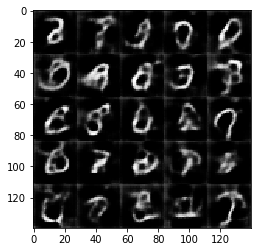

Epoch 1/2, batch 400... Discriminator Loss: 1.4672... Generator Loss: 0.3607


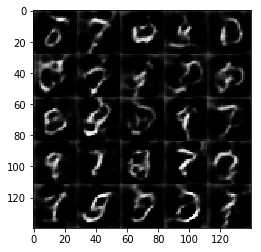

Epoch 1/2, batch 500... Discriminator Loss: 1.4846... Generator Loss: 0.3544


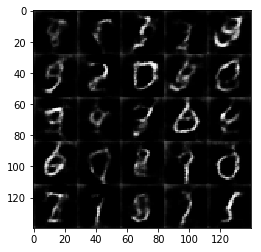

Epoch 1/2, batch 600... Discriminator Loss: 1.3647... Generator Loss: 1.1651


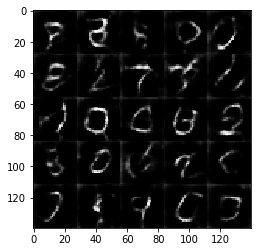

Epoch 1/2, batch 700... Discriminator Loss: 1.4024... Generator Loss: 0.5379


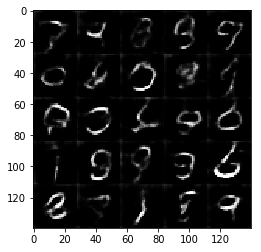

Epoch 1/2, batch 800... Discriminator Loss: 1.1732... Generator Loss: 0.8317


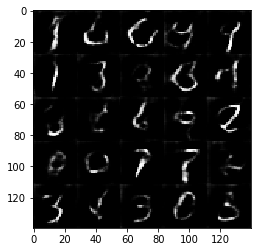

Epoch 1/2, batch 900... Discriminator Loss: 1.3704... Generator Loss: 0.4572


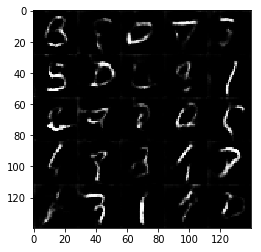

Epoch 2/2, batch 1000... Discriminator Loss: 1.4238... Generator Loss: 0.3758


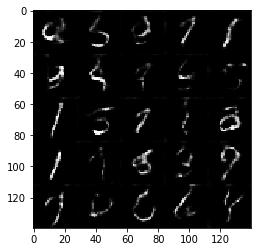

Epoch 2/2, batch 1100... Discriminator Loss: 1.2069... Generator Loss: 0.6003


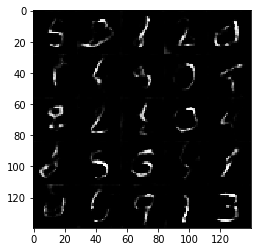

Epoch 2/2, batch 1200... Discriminator Loss: 1.3618... Generator Loss: 0.4175


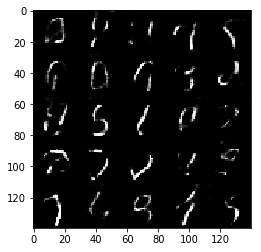

Epoch 2/2, batch 1300... Discriminator Loss: 2.0071... Generator Loss: 0.1796


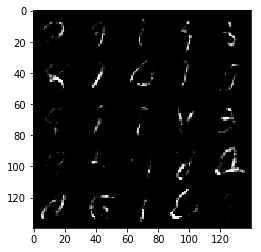

Epoch 2/2, batch 1400... Discriminator Loss: 1.1828... Generator Loss: 0.9681


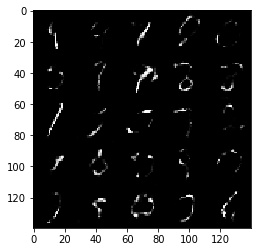

Epoch 2/2, batch 1500... Discriminator Loss: 1.3327... Generator Loss: 0.4101


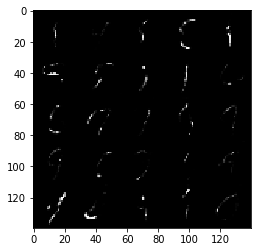

Epoch 2/2, batch 1600... Discriminator Loss: 1.1532... Generator Loss: 0.6659


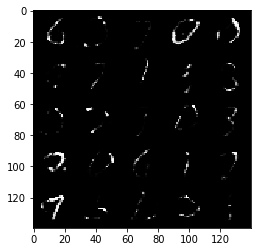

Epoch 2/2, batch 1700... Discriminator Loss: 1.1988... Generator Loss: 1.3797


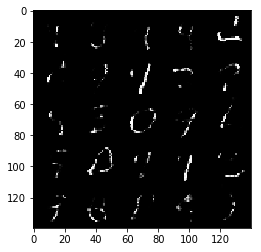

Epoch 2/2, batch 1800... Discriminator Loss: 0.8733... Generator Loss: 1.5301
batch_size is 128, beta1 is 0.1, alpha is 0.1,learning_rate is 0.0001


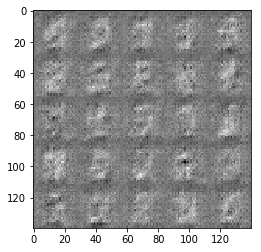

Epoch 1/2, batch 100... Discriminator Loss: 0.7837... Generator Loss: 1.0844


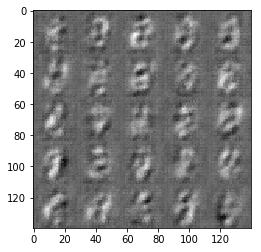

Epoch 1/2, batch 200... Discriminator Loss: 0.9742... Generator Loss: 1.3939


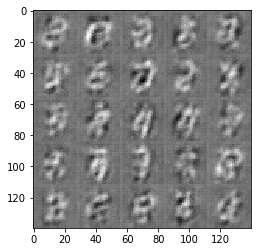

Epoch 1/2, batch 300... Discriminator Loss: 1.0892... Generator Loss: 1.3852


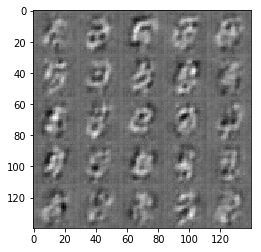

Epoch 1/2, batch 400... Discriminator Loss: 1.0785... Generator Loss: 1.1323


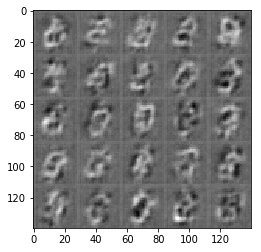

Epoch 2/2, batch 500... Discriminator Loss: 1.0482... Generator Loss: 1.2129


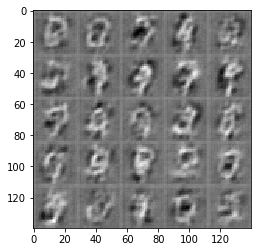

Epoch 2/2, batch 600... Discriminator Loss: 1.0656... Generator Loss: 1.1473


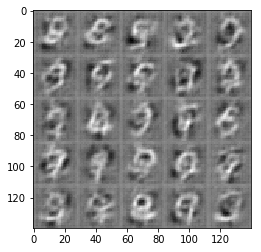

Epoch 2/2, batch 700... Discriminator Loss: 1.0681... Generator Loss: 1.1618


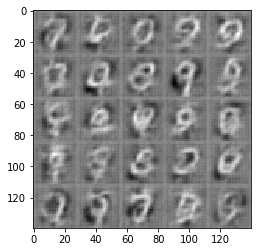

Epoch 2/2, batch 800... Discriminator Loss: 0.9965... Generator Loss: 0.9036


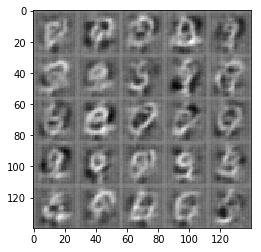

Epoch 2/2, batch 900... Discriminator Loss: 0.9974... Generator Loss: 0.7416
batch_size is 128, beta1 is 0.1, alpha is 0.1,learning_rate is 0.0005


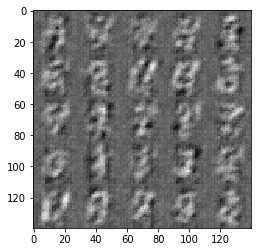

Epoch 1/2, batch 100... Discriminator Loss: 1.4742... Generator Loss: 0.9677


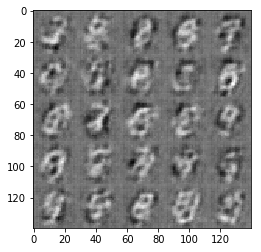

Epoch 1/2, batch 200... Discriminator Loss: 1.3409... Generator Loss: 1.0694


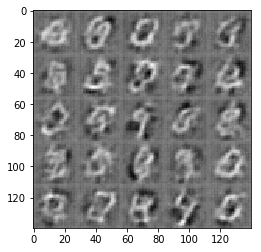

Epoch 1/2, batch 300... Discriminator Loss: 1.3153... Generator Loss: 1.0941


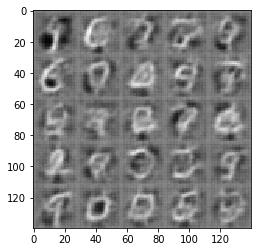

Epoch 1/2, batch 400... Discriminator Loss: 1.2730... Generator Loss: 0.5447


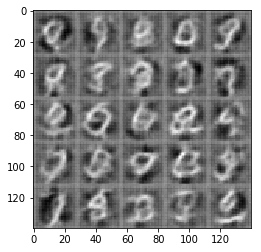

Epoch 2/2, batch 500... Discriminator Loss: 1.3622... Generator Loss: 0.4243


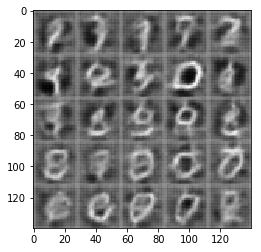

Epoch 2/2, batch 600... Discriminator Loss: 1.4091... Generator Loss: 0.3939


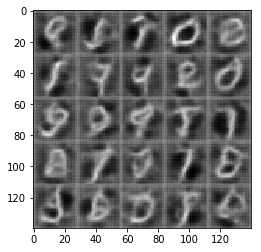

Epoch 2/2, batch 700... Discriminator Loss: 1.3802... Generator Loss: 0.4219


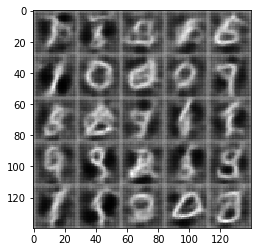

Epoch 2/2, batch 800... Discriminator Loss: 1.4322... Generator Loss: 0.4131


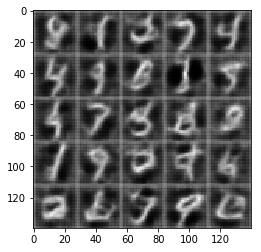

Epoch 2/2, batch 900... Discriminator Loss: 1.3363... Generator Loss: 0.4578
batch_size is 128, beta1 is 0.1, alpha is 0.1,learning_rate is 0.001


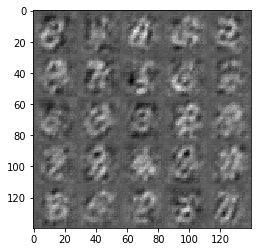

Epoch 1/2, batch 100... Discriminator Loss: 1.5277... Generator Loss: 0.7920


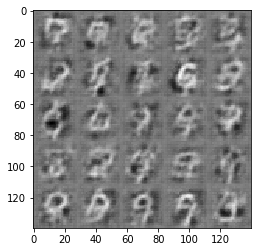

Epoch 1/2, batch 200... Discriminator Loss: 1.3773... Generator Loss: 0.7333


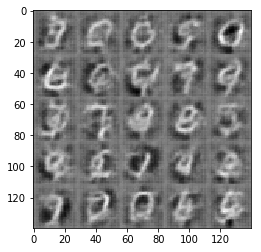

Epoch 1/2, batch 300... Discriminator Loss: 1.2930... Generator Loss: 0.8837


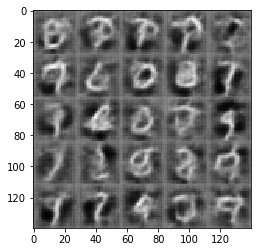

Epoch 1/2, batch 400... Discriminator Loss: 1.4616... Generator Loss: 1.1219


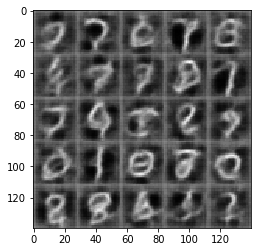

Epoch 2/2, batch 500... Discriminator Loss: 1.3363... Generator Loss: 0.9997


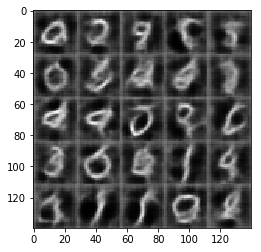

Epoch 2/2, batch 600... Discriminator Loss: 1.3019... Generator Loss: 0.9238


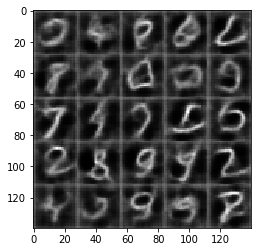

Epoch 2/2, batch 700... Discriminator Loss: 1.3372... Generator Loss: 1.0281


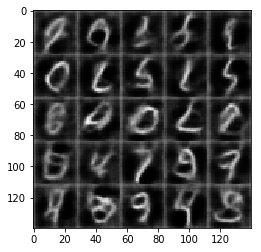

Epoch 2/2, batch 800... Discriminator Loss: 1.3889... Generator Loss: 1.1462


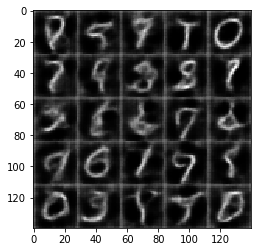

Epoch 2/2, batch 900... Discriminator Loss: 1.4086... Generator Loss: 1.2110
batch_size is 128, beta1 is 0.1, alpha is 0.1,learning_rate is 0.0015


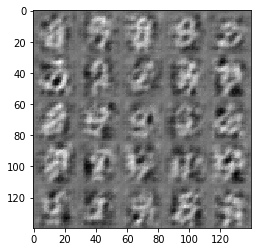

Epoch 1/2, batch 100... Discriminator Loss: 1.7987... Generator Loss: 0.2404


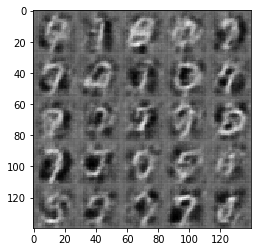

Epoch 1/2, batch 200... Discriminator Loss: 1.5014... Generator Loss: 0.3542


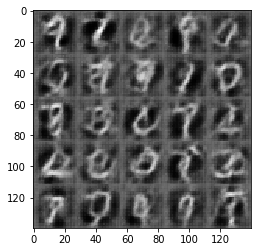

Epoch 1/2, batch 300... Discriminator Loss: 1.6105... Generator Loss: 0.2949


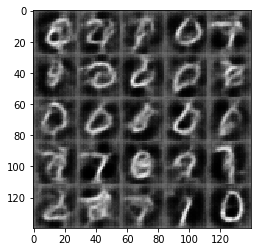

Epoch 1/2, batch 400... Discriminator Loss: 1.4702... Generator Loss: 0.3724


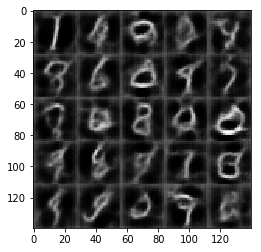

Epoch 2/2, batch 500... Discriminator Loss: 1.3702... Generator Loss: 0.4253


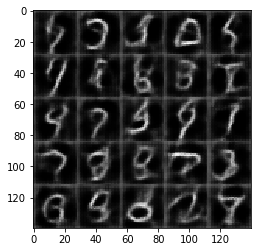

Epoch 2/2, batch 600... Discriminator Loss: 1.9670... Generator Loss: 0.1842


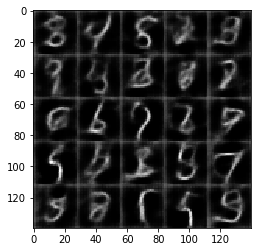

Epoch 2/2, batch 700... Discriminator Loss: 1.3397... Generator Loss: 1.0411


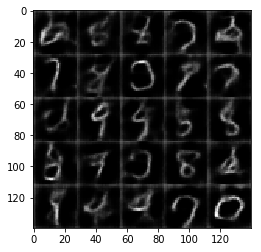

Epoch 2/2, batch 800... Discriminator Loss: 1.2700... Generator Loss: 1.0250


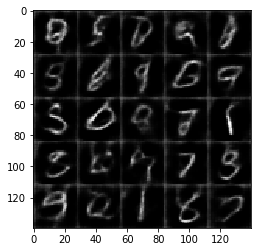

Epoch 2/2, batch 900... Discriminator Loss: 1.1812... Generator Loss: 0.9234
batch_size is 128, beta1 is 0.1, alpha is 0.1,learning_rate is 0.002


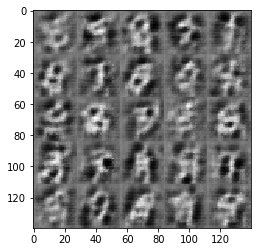

Epoch 1/2, batch 100... Discriminator Loss: 1.7658... Generator Loss: 0.2644


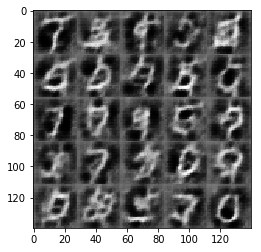

Epoch 1/2, batch 200... Discriminator Loss: 1.6329... Generator Loss: 0.3043


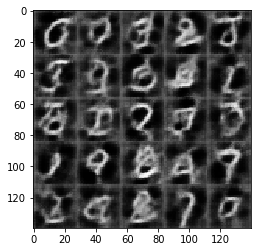

Epoch 1/2, batch 300... Discriminator Loss: 1.5148... Generator Loss: 0.3482


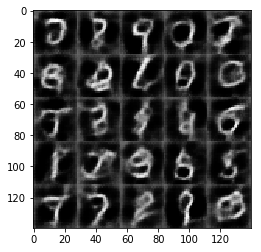

Epoch 1/2, batch 400... Discriminator Loss: 1.4748... Generator Loss: 0.4088


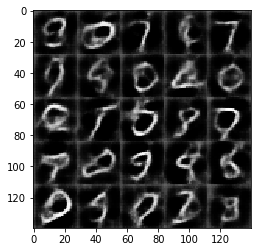

Epoch 2/2, batch 500... Discriminator Loss: 1.5685... Generator Loss: 0.3410


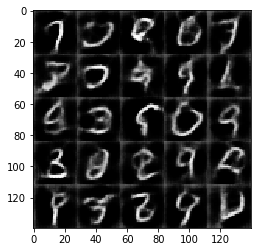

Epoch 2/2, batch 600... Discriminator Loss: 1.4697... Generator Loss: 0.3953


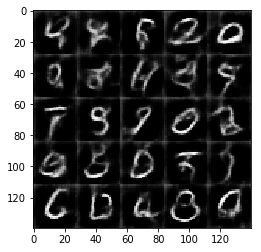

Epoch 2/2, batch 700... Discriminator Loss: 1.5881... Generator Loss: 0.3196


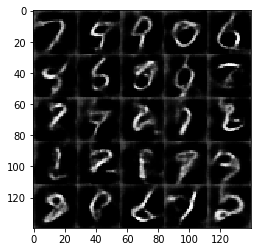

Epoch 2/2, batch 800... Discriminator Loss: 1.7523... Generator Loss: 0.2487


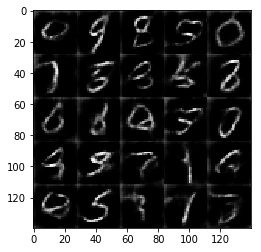

Epoch 2/2, batch 900... Discriminator Loss: 1.3039... Generator Loss: 0.4961
batch_size is 128, beta1 is 0.1, alpha is 0.2,learning_rate is 0.0001


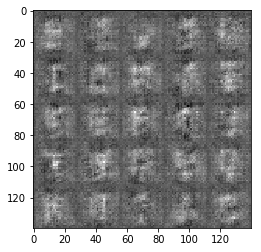

Epoch 1/2, batch 100... Discriminator Loss: 0.8663... Generator Loss: 0.9081


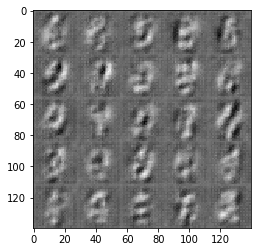

Epoch 1/2, batch 200... Discriminator Loss: 0.9752... Generator Loss: 1.1666


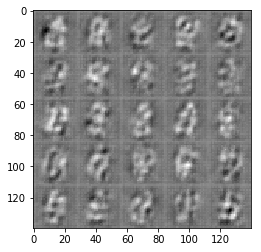

Epoch 1/2, batch 300... Discriminator Loss: 1.1088... Generator Loss: 1.0037


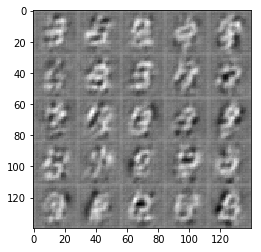

Epoch 1/2, batch 400... Discriminator Loss: 1.1110... Generator Loss: 0.9644


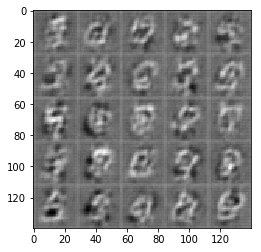

Epoch 2/2, batch 500... Discriminator Loss: 1.1739... Generator Loss: 1.1681


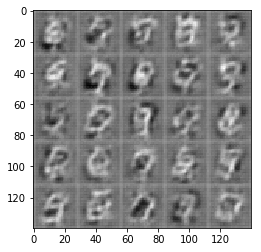

Epoch 2/2, batch 600... Discriminator Loss: 1.1010... Generator Loss: 0.6870


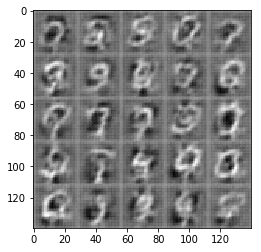

Epoch 2/2, batch 700... Discriminator Loss: 1.0821... Generator Loss: 0.7919


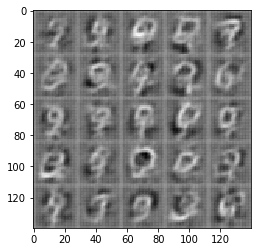

Epoch 2/2, batch 800... Discriminator Loss: 1.1486... Generator Loss: 1.1428


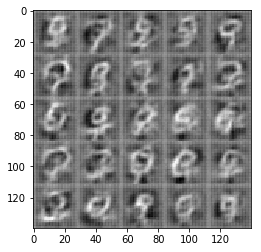

Epoch 2/2, batch 900... Discriminator Loss: 1.1670... Generator Loss: 1.3428
batch_size is 128, beta1 is 0.1, alpha is 0.2,learning_rate is 0.0005


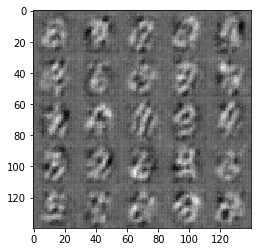

Epoch 1/2, batch 100... Discriminator Loss: 1.6252... Generator Loss: 0.3045


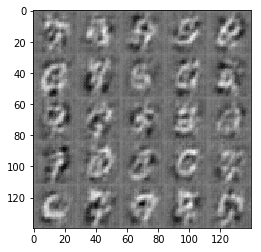

Epoch 1/2, batch 200... Discriminator Loss: 1.3769... Generator Loss: 0.4169


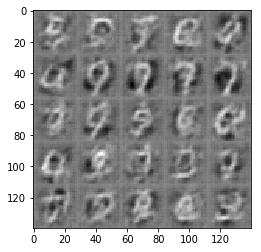

Epoch 1/2, batch 300... Discriminator Loss: 1.4593... Generator Loss: 0.3633


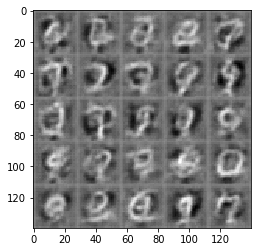

Epoch 1/2, batch 400... Discriminator Loss: 1.3680... Generator Loss: 0.4347


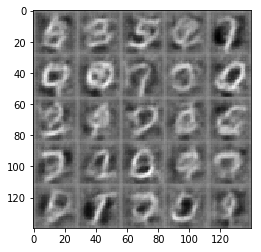

Epoch 2/2, batch 500... Discriminator Loss: 1.4191... Generator Loss: 0.3867


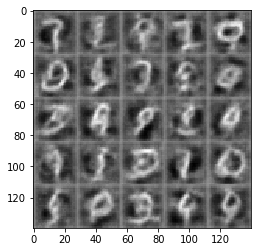

Epoch 2/2, batch 600... Discriminator Loss: 1.6334... Generator Loss: 0.2960


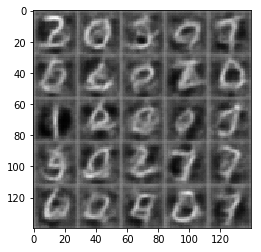

Epoch 2/2, batch 700... Discriminator Loss: 1.3248... Generator Loss: 0.4964


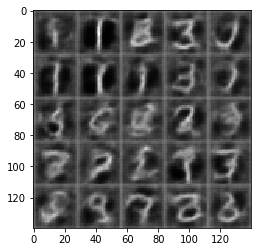

Epoch 2/2, batch 800... Discriminator Loss: 1.3687... Generator Loss: 1.1950


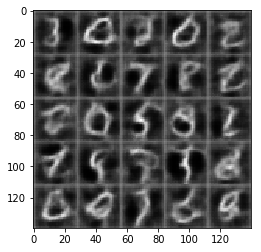

Epoch 2/2, batch 900... Discriminator Loss: 2.0457... Generator Loss: 2.0661
batch_size is 128, beta1 is 0.1, alpha is 0.2,learning_rate is 0.001


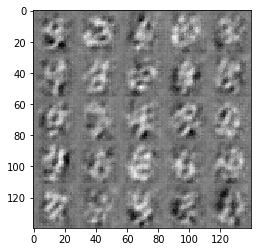

Epoch 1/2, batch 100... Discriminator Loss: 1.7293... Generator Loss: 0.2728


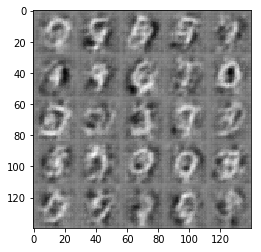

Epoch 1/2, batch 200... Discriminator Loss: 1.5229... Generator Loss: 0.3445


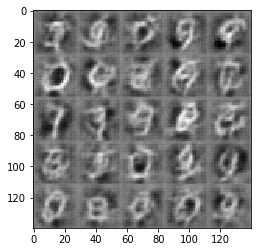

Epoch 1/2, batch 300... Discriminator Loss: 1.3311... Generator Loss: 0.8987


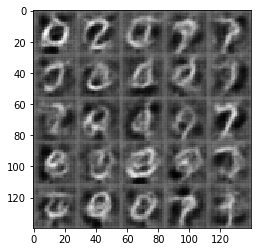

Epoch 1/2, batch 400... Discriminator Loss: 1.3677... Generator Loss: 1.0335


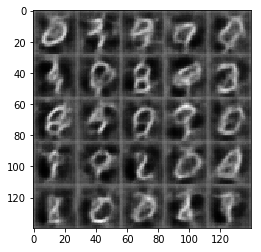

Epoch 2/2, batch 500... Discriminator Loss: 1.5185... Generator Loss: 1.3482


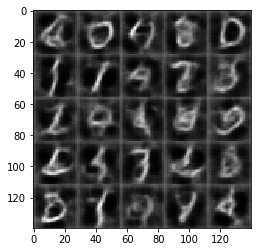

Epoch 2/2, batch 600... Discriminator Loss: 1.2493... Generator Loss: 0.9941


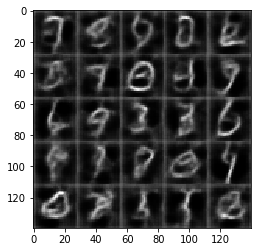

Epoch 2/2, batch 700... Discriminator Loss: 1.3301... Generator Loss: 0.4862


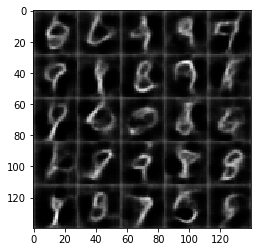

Epoch 2/2, batch 800... Discriminator Loss: 1.5070... Generator Loss: 0.3592


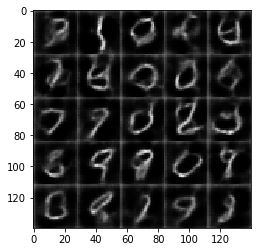

Epoch 2/2, batch 900... Discriminator Loss: 1.2226... Generator Loss: 0.6071
batch_size is 128, beta1 is 0.1, alpha is 0.2,learning_rate is 0.0015


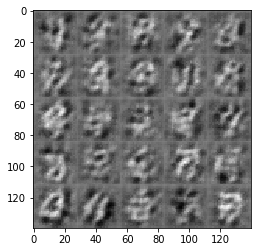

Epoch 1/2, batch 100... Discriminator Loss: 1.8189... Generator Loss: 0.2329


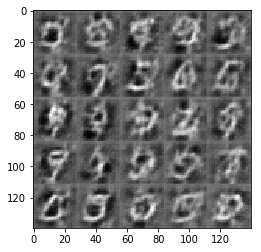

Epoch 1/2, batch 200... Discriminator Loss: 1.6131... Generator Loss: 0.3075


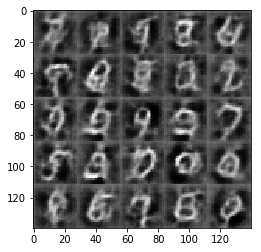

Epoch 1/2, batch 300... Discriminator Loss: 1.5631... Generator Loss: 0.3089


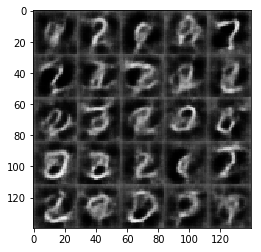

Epoch 1/2, batch 400... Discriminator Loss: 1.5493... Generator Loss: 0.3206


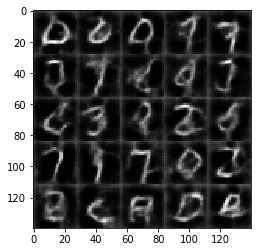

Epoch 2/2, batch 500... Discriminator Loss: 1.2803... Generator Loss: 1.0554


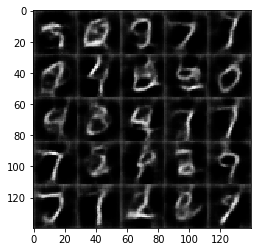

Epoch 2/2, batch 600... Discriminator Loss: 1.3086... Generator Loss: 1.1777


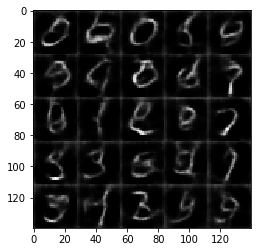

Epoch 2/2, batch 700... Discriminator Loss: 1.5005... Generator Loss: 0.3535


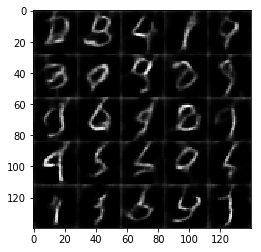

Epoch 2/2, batch 800... Discriminator Loss: 1.2507... Generator Loss: 0.9599


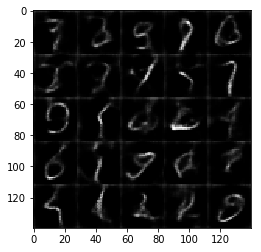

Epoch 2/2, batch 900... Discriminator Loss: 1.4965... Generator Loss: 1.3693
batch_size is 128, beta1 is 0.1, alpha is 0.2,learning_rate is 0.002


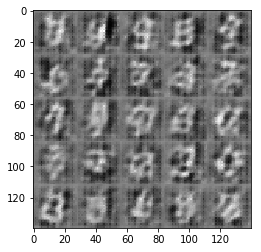

Epoch 1/2, batch 100... Discriminator Loss: 1.7808... Generator Loss: 0.2598


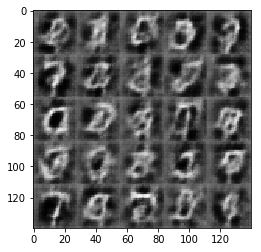

Epoch 1/2, batch 200... Discriminator Loss: 1.5885... Generator Loss: 0.3303


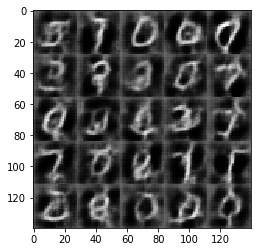

Epoch 1/2, batch 300... Discriminator Loss: 1.5739... Generator Loss: 0.3246


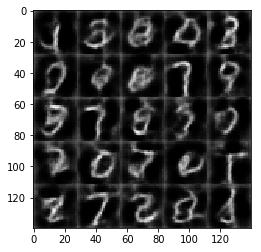

Epoch 1/2, batch 400... Discriminator Loss: 1.4781... Generator Loss: 0.3743


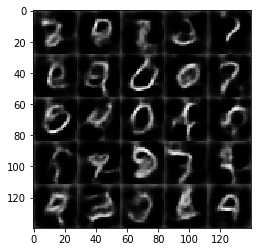

Epoch 2/2, batch 500... Discriminator Loss: 1.3349... Generator Loss: 0.5085


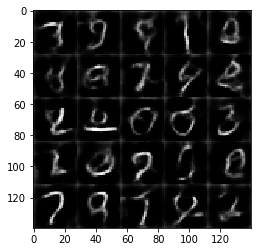

Epoch 2/2, batch 600... Discriminator Loss: 1.5289... Generator Loss: 0.3489


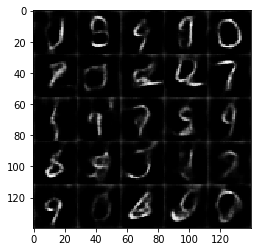

Epoch 2/2, batch 700... Discriminator Loss: 1.2963... Generator Loss: 1.0786


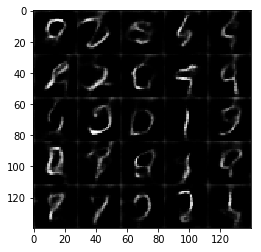

Epoch 2/2, batch 800... Discriminator Loss: 1.3156... Generator Loss: 0.8913


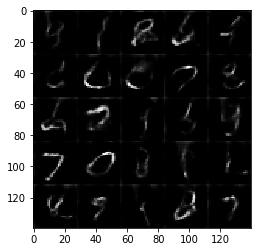

Epoch 2/2, batch 900... Discriminator Loss: 1.4640... Generator Loss: 0.3900
batch_size is 128, beta1 is 0.2, alpha is 0.1,learning_rate is 0.0001


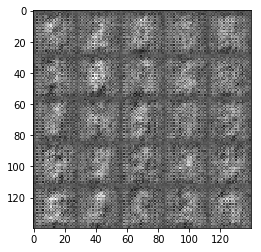

Epoch 1/2, batch 100... Discriminator Loss: 0.7472... Generator Loss: 1.0067


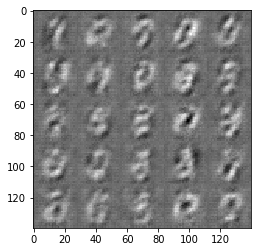

Epoch 1/2, batch 200... Discriminator Loss: 1.0136... Generator Loss: 1.3650


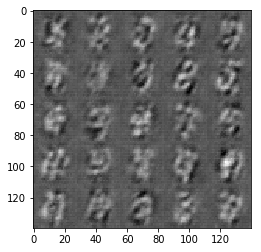

Epoch 1/2, batch 300... Discriminator Loss: 1.0451... Generator Loss: 0.7292


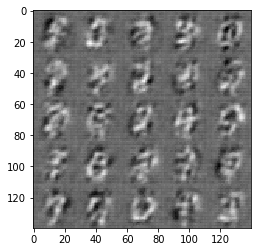

Epoch 1/2, batch 400... Discriminator Loss: 1.0044... Generator Loss: 0.7666


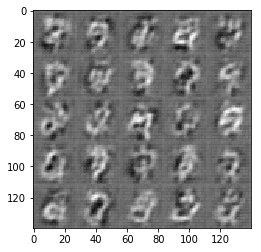

Epoch 2/2, batch 500... Discriminator Loss: 1.0858... Generator Loss: 1.2425


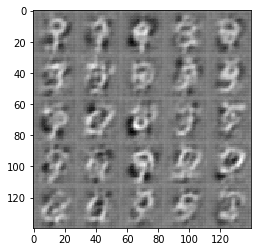

Epoch 2/2, batch 600... Discriminator Loss: 1.0696... Generator Loss: 1.1430


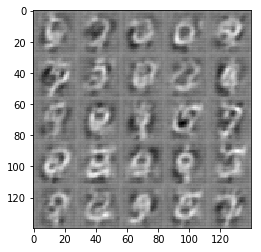

Epoch 2/2, batch 700... Discriminator Loss: 0.9819... Generator Loss: 0.8486


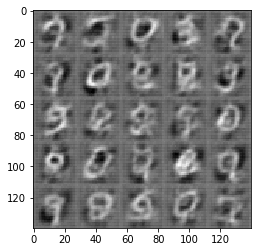

Epoch 2/2, batch 800... Discriminator Loss: 1.0425... Generator Loss: 1.3190


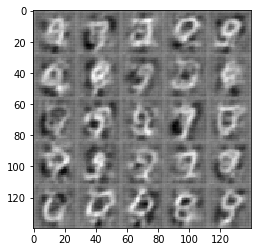

Epoch 2/2, batch 900... Discriminator Loss: 0.9601... Generator Loss: 0.8071
batch_size is 128, beta1 is 0.2, alpha is 0.1,learning_rate is 0.0005


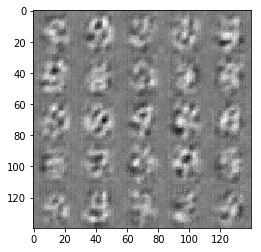

Epoch 1/2, batch 100... Discriminator Loss: 1.3151... Generator Loss: 0.9202


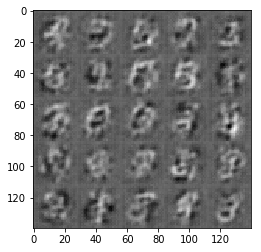

Epoch 1/2, batch 200... Discriminator Loss: 1.2157... Generator Loss: 1.1128


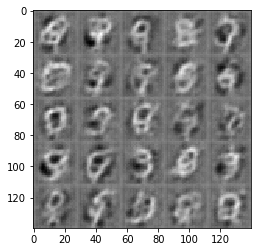

Epoch 1/2, batch 300... Discriminator Loss: 1.1678... Generator Loss: 0.7728


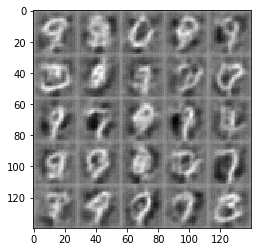

Epoch 1/2, batch 400... Discriminator Loss: 1.4749... Generator Loss: 0.3312


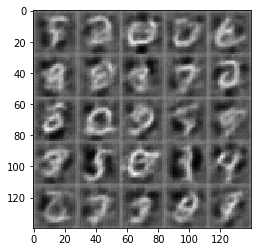

Epoch 2/2, batch 500... Discriminator Loss: 1.2383... Generator Loss: 0.9623


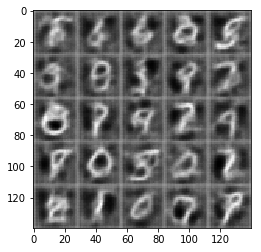

Epoch 2/2, batch 600... Discriminator Loss: 1.7668... Generator Loss: 0.2301


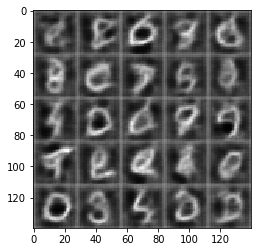

Epoch 2/2, batch 700... Discriminator Loss: 1.2816... Generator Loss: 0.5220


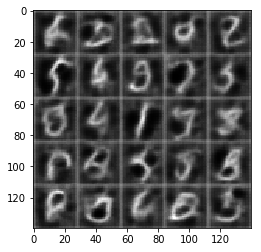

Epoch 2/2, batch 800... Discriminator Loss: 1.2556... Generator Loss: 0.9486


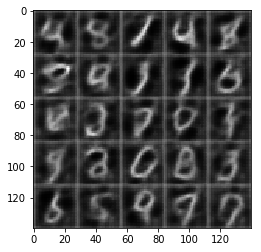

Epoch 2/2, batch 900... Discriminator Loss: 1.1460... Generator Loss: 0.7261
batch_size is 128, beta1 is 0.2, alpha is 0.1,learning_rate is 0.001


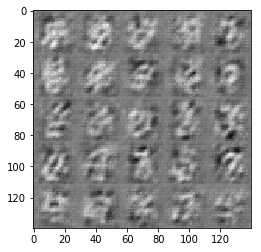

Epoch 1/2, batch 100... Discriminator Loss: 1.4865... Generator Loss: 0.6888


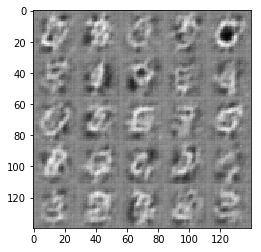

Epoch 1/2, batch 200... Discriminator Loss: 1.4731... Generator Loss: 1.0822


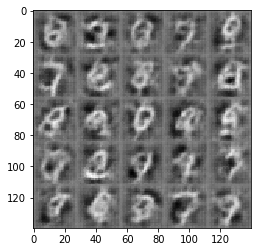

Epoch 1/2, batch 300... Discriminator Loss: 1.4734... Generator Loss: 0.3672


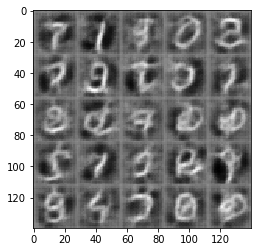

Epoch 1/2, batch 400... Discriminator Loss: 1.4515... Generator Loss: 0.4027


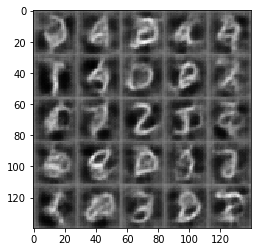

Epoch 2/2, batch 500... Discriminator Loss: 1.5140... Generator Loss: 1.3393


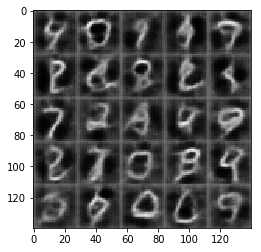

Epoch 2/2, batch 600... Discriminator Loss: 1.3258... Generator Loss: 0.5110


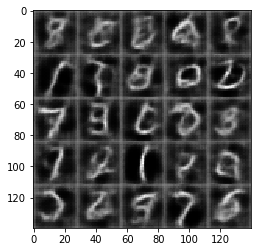

Epoch 2/2, batch 700... Discriminator Loss: 1.5626... Generator Loss: 0.3274


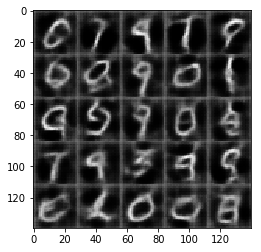

Epoch 2/2, batch 800... Discriminator Loss: 1.6691... Generator Loss: 1.5147


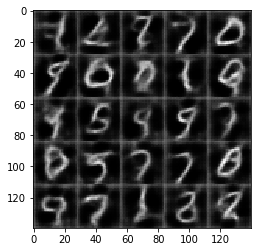

Epoch 2/2, batch 900... Discriminator Loss: 1.3912... Generator Loss: 1.4743
batch_size is 128, beta1 is 0.2, alpha is 0.1,learning_rate is 0.0015


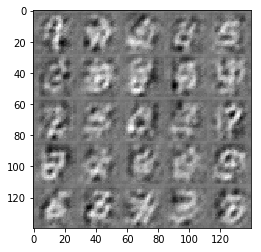

Epoch 1/2, batch 100... Discriminator Loss: 1.4644... Generator Loss: 0.9071


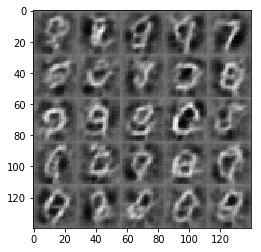

Epoch 1/2, batch 200... Discriminator Loss: 1.5203... Generator Loss: 1.2512


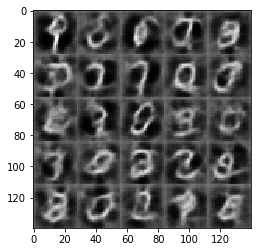

Epoch 1/2, batch 300... Discriminator Loss: 1.3004... Generator Loss: 0.6177


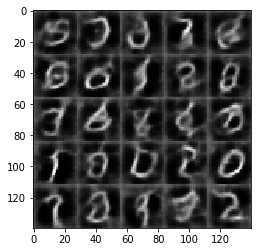

Epoch 1/2, batch 400... Discriminator Loss: 1.4077... Generator Loss: 0.4368


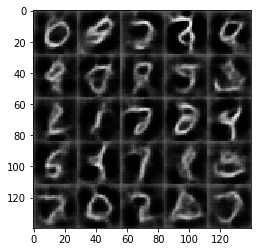

Epoch 2/2, batch 500... Discriminator Loss: 1.5428... Generator Loss: 0.3379


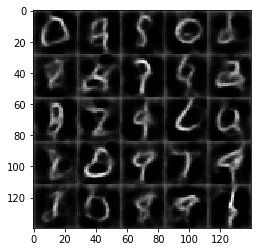

Epoch 2/2, batch 600... Discriminator Loss: 1.5128... Generator Loss: 0.3289


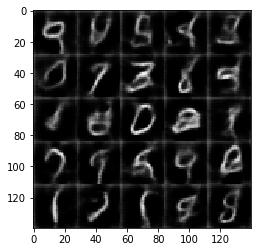

Epoch 2/2, batch 700... Discriminator Loss: 1.3539... Generator Loss: 0.4288


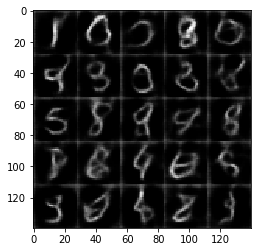

Epoch 2/2, batch 800... Discriminator Loss: 1.3656... Generator Loss: 1.2781


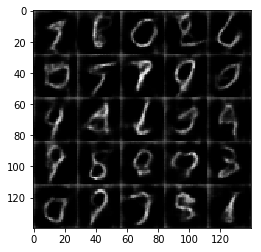

Epoch 2/2, batch 900... Discriminator Loss: 1.4597... Generator Loss: 0.3602
batch_size is 128, beta1 is 0.2, alpha is 0.1,learning_rate is 0.002


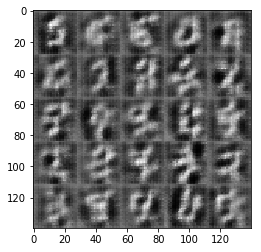

Epoch 1/2, batch 100... Discriminator Loss: 1.6490... Generator Loss: 1.3713


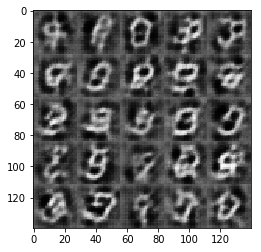

Epoch 1/2, batch 200... Discriminator Loss: 1.4626... Generator Loss: 1.1073


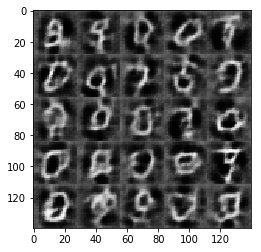

Epoch 1/2, batch 300... Discriminator Loss: 1.3509... Generator Loss: 0.9823


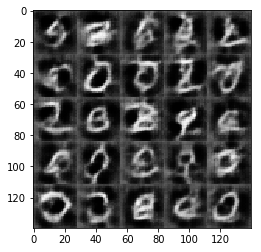

Epoch 1/2, batch 400... Discriminator Loss: 1.3665... Generator Loss: 0.9822


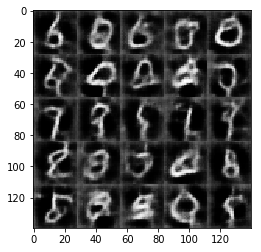

Epoch 2/2, batch 500... Discriminator Loss: 1.2992... Generator Loss: 0.9669


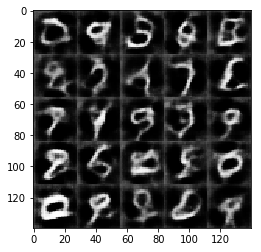

Epoch 2/2, batch 600... Discriminator Loss: 1.4508... Generator Loss: 0.3679


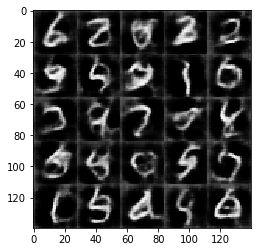

Epoch 2/2, batch 700... Discriminator Loss: 1.3661... Generator Loss: 0.4738


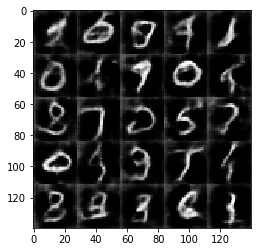

Epoch 2/2, batch 800... Discriminator Loss: 1.2936... Generator Loss: 0.9193


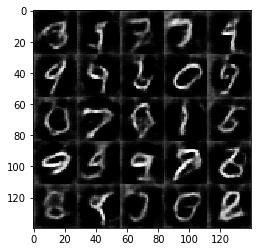

Epoch 2/2, batch 900... Discriminator Loss: 1.4322... Generator Loss: 1.1439
batch_size is 128, beta1 is 0.2, alpha is 0.2,learning_rate is 0.0001


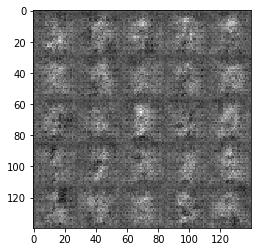

Epoch 1/2, batch 100... Discriminator Loss: 0.8886... Generator Loss: 1.0773


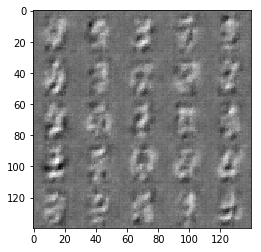

Epoch 1/2, batch 200... Discriminator Loss: 1.0438... Generator Loss: 1.1862


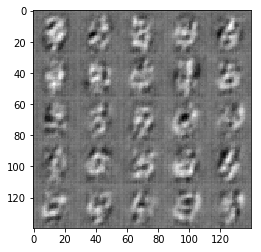

Epoch 1/2, batch 300... Discriminator Loss: 1.0765... Generator Loss: 0.7326


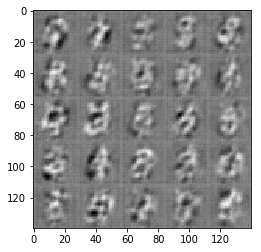

Epoch 1/2, batch 400... Discriminator Loss: 1.1570... Generator Loss: 0.5936


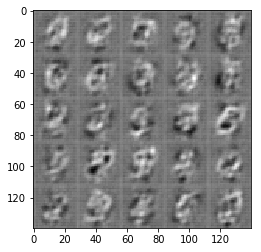

Epoch 2/2, batch 500... Discriminator Loss: 1.0915... Generator Loss: 1.0616


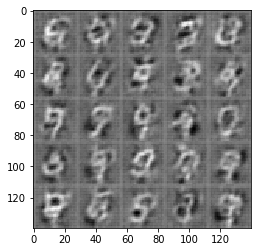

Epoch 2/2, batch 600... Discriminator Loss: 1.0737... Generator Loss: 1.1063


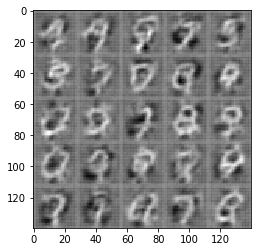

Epoch 2/2, batch 700... Discriminator Loss: 1.0811... Generator Loss: 1.1553


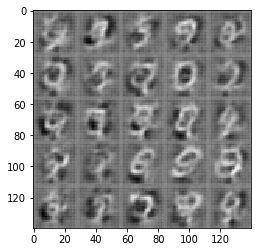

Epoch 2/2, batch 800... Discriminator Loss: 1.0860... Generator Loss: 1.0597


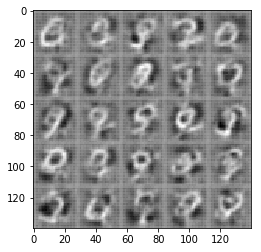

Epoch 2/2, batch 900... Discriminator Loss: 1.0330... Generator Loss: 0.6952
batch_size is 128, beta1 is 0.2, alpha is 0.2,learning_rate is 0.0005


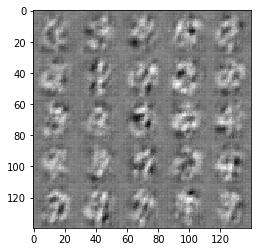

Epoch 1/2, batch 100... Discriminator Loss: 1.3398... Generator Loss: 0.7221


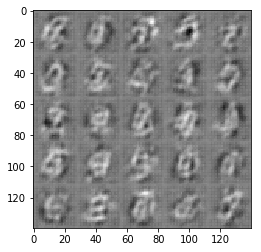

Epoch 1/2, batch 200... Discriminator Loss: 1.2082... Generator Loss: 0.8506


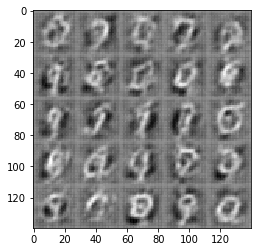

Epoch 1/2, batch 300... Discriminator Loss: 1.2567... Generator Loss: 0.9649


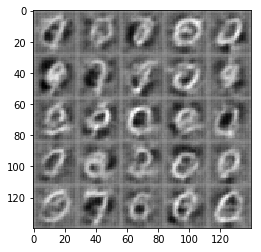

Epoch 1/2, batch 400... Discriminator Loss: 1.3019... Generator Loss: 1.0582


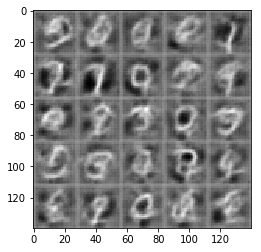

Epoch 2/2, batch 500... Discriminator Loss: 1.2178... Generator Loss: 0.8783


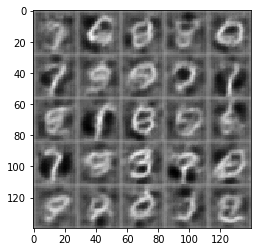

Epoch 2/2, batch 600... Discriminator Loss: 1.2195... Generator Loss: 0.7239


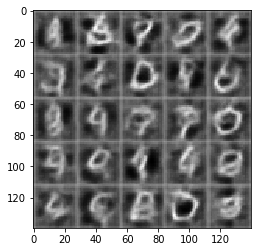

Epoch 2/2, batch 700... Discriminator Loss: 1.3154... Generator Loss: 0.4835


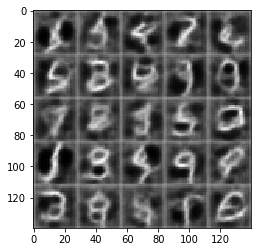

Epoch 2/2, batch 800... Discriminator Loss: 1.2604... Generator Loss: 0.5689


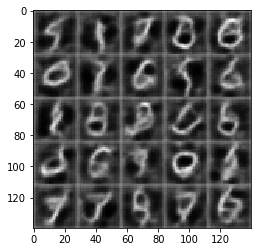

Epoch 2/2, batch 900... Discriminator Loss: 1.1925... Generator Loss: 0.6995
batch_size is 128, beta1 is 0.2, alpha is 0.2,learning_rate is 0.001


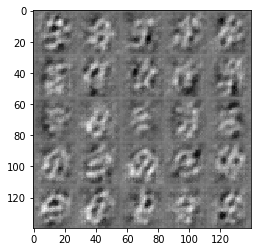

Epoch 1/2, batch 100... Discriminator Loss: 1.4493... Generator Loss: 0.5281


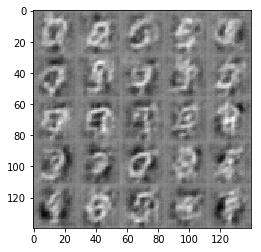

Epoch 1/2, batch 200... Discriminator Loss: 1.3568... Generator Loss: 1.0106


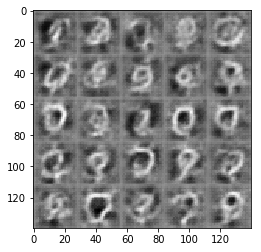

Epoch 1/2, batch 300... Discriminator Loss: 1.3386... Generator Loss: 0.8710


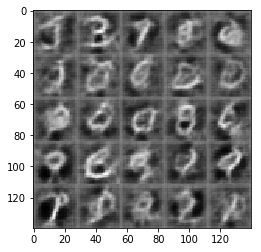

Epoch 1/2, batch 400... Discriminator Loss: 1.2697... Generator Loss: 0.5838


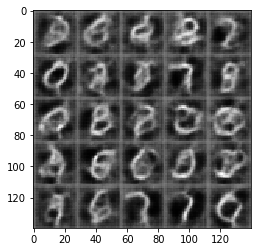

Epoch 2/2, batch 500... Discriminator Loss: 1.2744... Generator Loss: 0.8291


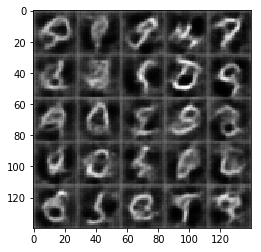

Epoch 2/2, batch 600... Discriminator Loss: 1.3293... Generator Loss: 0.5433


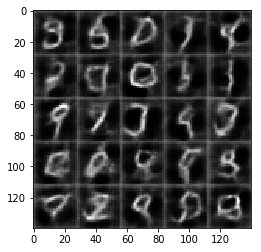

Epoch 2/2, batch 700... Discriminator Loss: 1.3127... Generator Loss: 0.5054


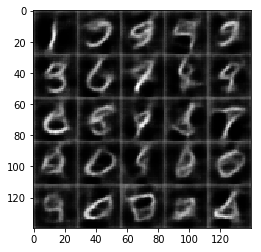

Epoch 2/2, batch 800... Discriminator Loss: 1.2754... Generator Loss: 0.6224


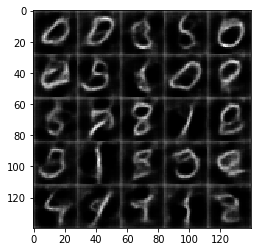

Epoch 2/2, batch 900... Discriminator Loss: 1.1690... Generator Loss: 0.7059
batch_size is 128, beta1 is 0.2, alpha is 0.2,learning_rate is 0.0015


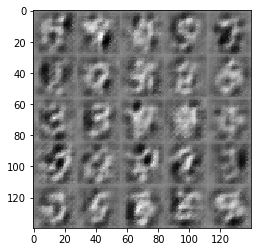

Epoch 1/2, batch 100... Discriminator Loss: 1.4856... Generator Loss: 0.9287


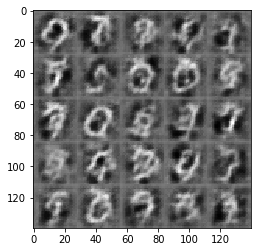

Epoch 1/2, batch 200... Discriminator Loss: 1.3915... Generator Loss: 0.8301


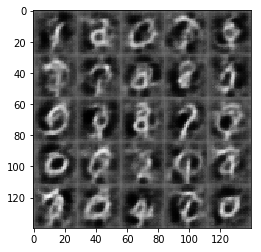

Epoch 1/2, batch 300... Discriminator Loss: 1.2936... Generator Loss: 0.9902


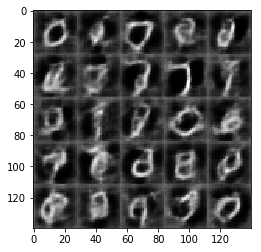

Epoch 1/2, batch 400... Discriminator Loss: 1.4492... Generator Loss: 1.2335


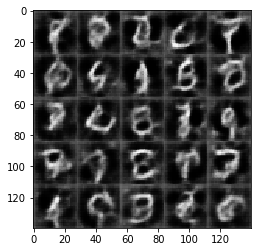

Epoch 2/2, batch 500... Discriminator Loss: 1.6489... Generator Loss: 1.5186


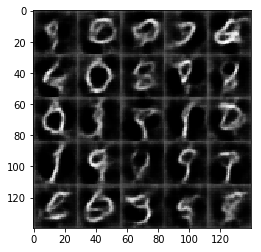

Epoch 2/2, batch 600... Discriminator Loss: 1.3184... Generator Loss: 0.9112


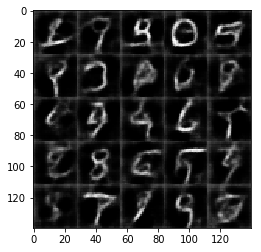

Epoch 2/2, batch 700... Discriminator Loss: 1.5478... Generator Loss: 0.3489


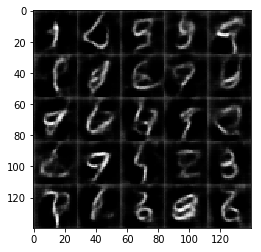

Epoch 2/2, batch 800... Discriminator Loss: 1.2980... Generator Loss: 1.1832


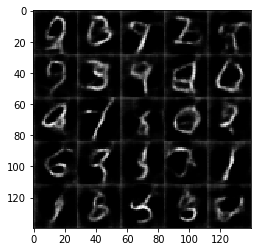

Epoch 2/2, batch 900... Discriminator Loss: 1.2596... Generator Loss: 0.9584
batch_size is 128, beta1 is 0.2, alpha is 0.2,learning_rate is 0.002


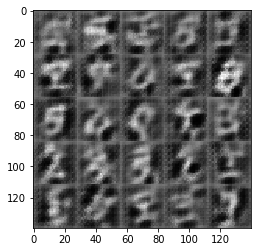

Epoch 1/2, batch 100... Discriminator Loss: 1.6107... Generator Loss: 1.2625


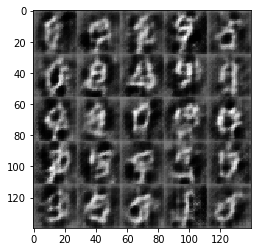

Epoch 1/2, batch 200... Discriminator Loss: 1.4054... Generator Loss: 0.9949


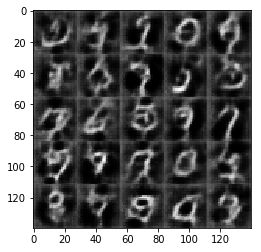

Epoch 1/2, batch 300... Discriminator Loss: 1.3937... Generator Loss: 1.1087


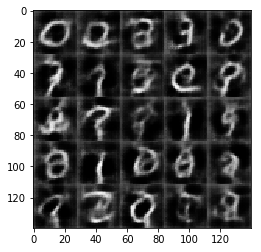

Epoch 1/2, batch 400... Discriminator Loss: 1.2899... Generator Loss: 0.9483


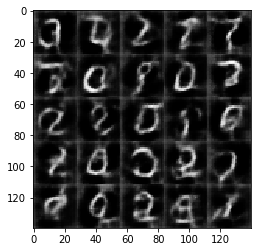

Epoch 2/2, batch 500... Discriminator Loss: 1.4514... Generator Loss: 1.4597


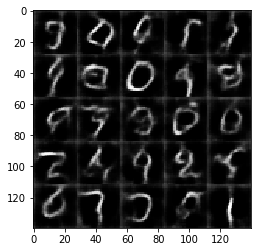

Epoch 2/2, batch 600... Discriminator Loss: 1.7101... Generator Loss: 0.2818


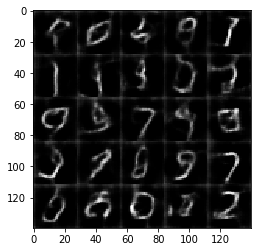

Epoch 2/2, batch 700... Discriminator Loss: 1.3354... Generator Loss: 0.4633


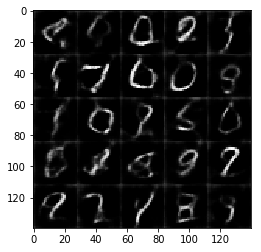

Epoch 2/2, batch 800... Discriminator Loss: 1.3016... Generator Loss: 1.0269


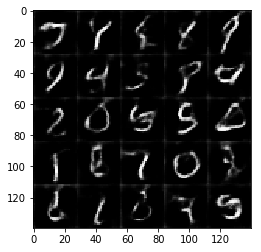

Epoch 2/2, batch 900... Discriminator Loss: 1.2773... Generator Loss: 0.5218
batch_size is 128, beta1 is 0.4, alpha is 0.1,learning_rate is 0.0001


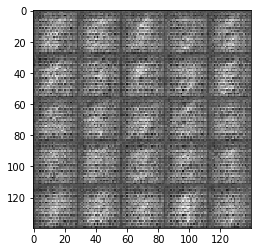

Epoch 1/2, batch 100... Discriminator Loss: 0.6477... Generator Loss: 1.2037


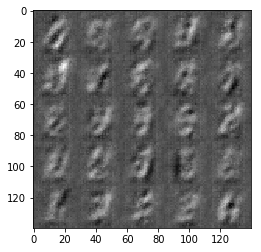

Epoch 1/2, batch 200... Discriminator Loss: 0.8217... Generator Loss: 1.2937


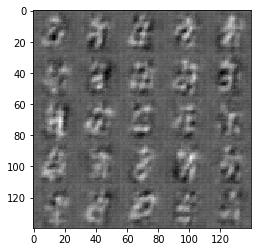

Epoch 1/2, batch 300... Discriminator Loss: 0.9754... Generator Loss: 0.7215


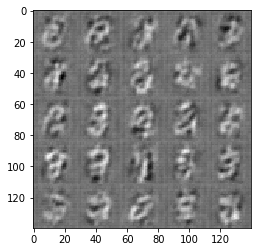

Epoch 1/2, batch 400... Discriminator Loss: 0.9549... Generator Loss: 1.1031


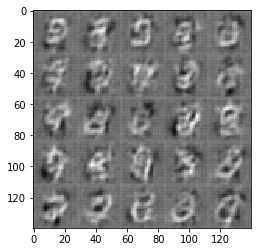

Epoch 2/2, batch 500... Discriminator Loss: 1.0242... Generator Loss: 1.2867


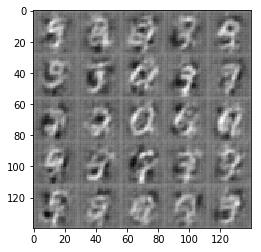

Epoch 2/2, batch 600... Discriminator Loss: 1.0446... Generator Loss: 0.6869


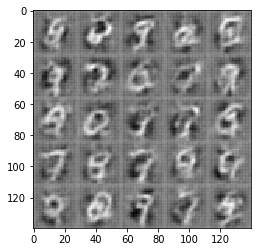

Epoch 2/2, batch 700... Discriminator Loss: 0.9544... Generator Loss: 1.0643


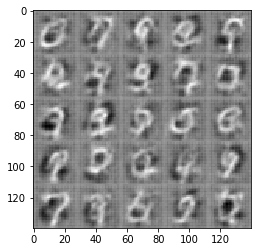

Epoch 2/2, batch 800... Discriminator Loss: 1.0006... Generator Loss: 1.2037


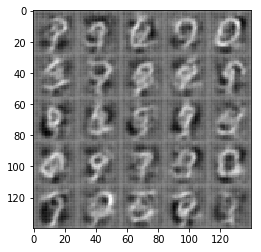

Epoch 2/2, batch 900... Discriminator Loss: 0.9348... Generator Loss: 0.8245
batch_size is 128, beta1 is 0.4, alpha is 0.1,learning_rate is 0.0005


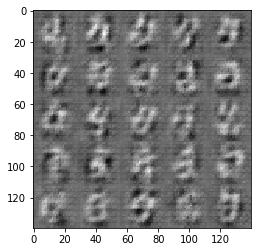

Epoch 1/2, batch 100... Discriminator Loss: 1.3679... Generator Loss: 0.5861


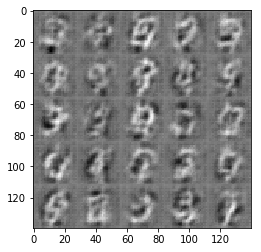

Epoch 1/2, batch 200... Discriminator Loss: 1.1646... Generator Loss: 0.9051


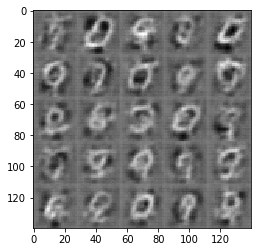

Epoch 1/2, batch 300... Discriminator Loss: 1.1706... Generator Loss: 0.9018


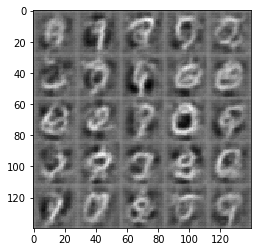

Epoch 1/2, batch 400... Discriminator Loss: 1.1756... Generator Loss: 1.0619


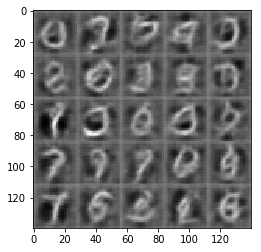

Epoch 2/2, batch 500... Discriminator Loss: 1.0937... Generator Loss: 0.9206


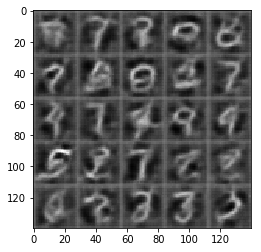

Epoch 2/2, batch 600... Discriminator Loss: 1.4559... Generator Loss: 0.3691


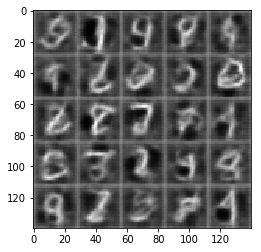

Epoch 2/2, batch 700... Discriminator Loss: 1.0853... Generator Loss: 0.7699


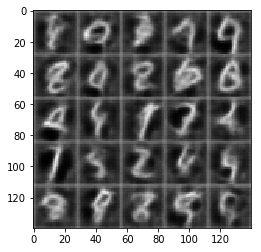

Epoch 2/2, batch 800... Discriminator Loss: 1.1034... Generator Loss: 0.7903


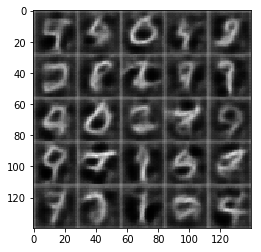

Epoch 2/2, batch 900... Discriminator Loss: 1.0938... Generator Loss: 1.3450
batch_size is 128, beta1 is 0.4, alpha is 0.1,learning_rate is 0.001


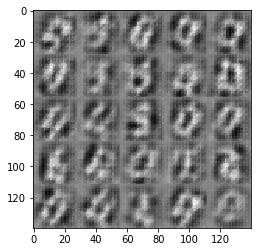

Epoch 1/2, batch 100... Discriminator Loss: 1.8029... Generator Loss: 0.2276


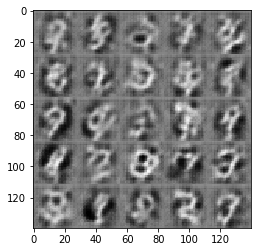

Epoch 1/2, batch 200... Discriminator Loss: 1.2984... Generator Loss: 0.5167


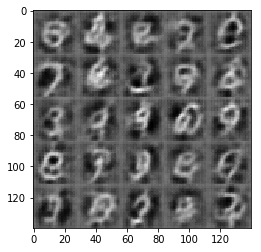

Epoch 1/2, batch 300... Discriminator Loss: 1.4215... Generator Loss: 0.3956


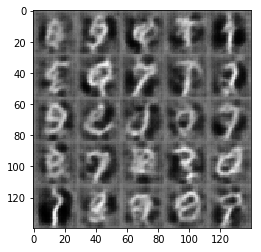

Epoch 1/2, batch 400... Discriminator Loss: 1.2691... Generator Loss: 0.5115


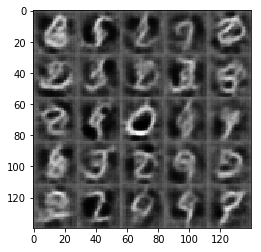

Epoch 2/2, batch 500... Discriminator Loss: 1.1614... Generator Loss: 0.7066


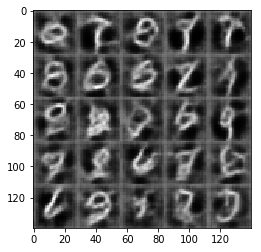

Epoch 2/2, batch 600... Discriminator Loss: 1.2620... Generator Loss: 1.1485


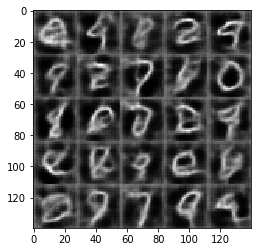

Epoch 2/2, batch 700... Discriminator Loss: 1.2473... Generator Loss: 0.6854


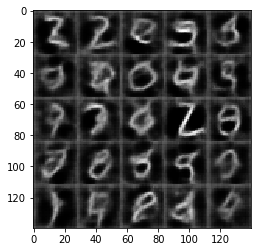

Epoch 2/2, batch 800... Discriminator Loss: 1.4831... Generator Loss: 0.3530


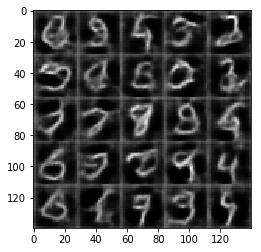

Epoch 2/2, batch 900... Discriminator Loss: 1.2319... Generator Loss: 0.6628
batch_size is 128, beta1 is 0.4, alpha is 0.1,learning_rate is 0.0015


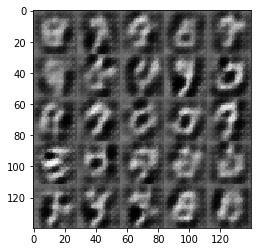

Epoch 1/2, batch 100... Discriminator Loss: 1.3480... Generator Loss: 1.7000


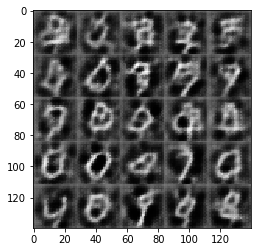

Epoch 1/2, batch 200... Discriminator Loss: 1.4685... Generator Loss: 0.3646


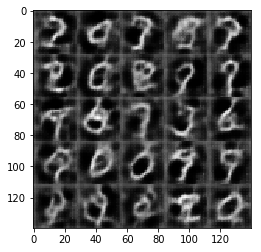

Epoch 1/2, batch 300... Discriminator Loss: 1.2015... Generator Loss: 1.0308


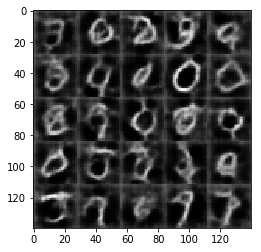

Epoch 1/2, batch 400... Discriminator Loss: 1.3352... Generator Loss: 0.8920


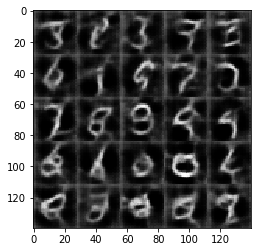

Epoch 2/2, batch 500... Discriminator Loss: 1.2362... Generator Loss: 0.6355


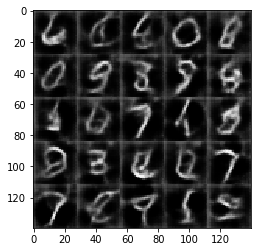

Epoch 2/2, batch 600... Discriminator Loss: 1.4138... Generator Loss: 1.3153


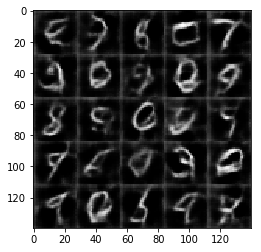

Epoch 2/2, batch 700... Discriminator Loss: 1.2826... Generator Loss: 1.0378


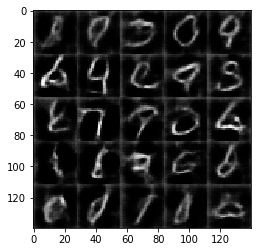

Epoch 2/2, batch 800... Discriminator Loss: 1.3320... Generator Loss: 0.4096


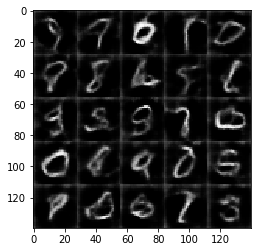

Epoch 2/2, batch 900... Discriminator Loss: 1.1573... Generator Loss: 1.1292
batch_size is 128, beta1 is 0.4, alpha is 0.1,learning_rate is 0.002


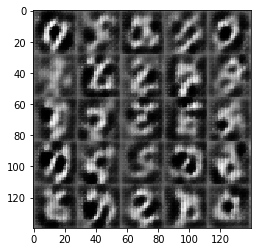

Epoch 1/2, batch 100... Discriminator Loss: 1.5514... Generator Loss: 1.7876


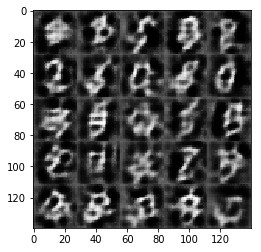

Epoch 1/2, batch 200... Discriminator Loss: 1.3455... Generator Loss: 0.4420


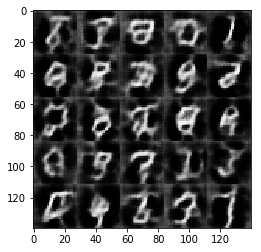

Epoch 1/2, batch 300... Discriminator Loss: 1.4009... Generator Loss: 0.4552


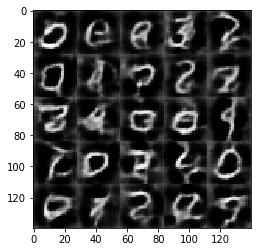

Epoch 1/2, batch 400... Discriminator Loss: 1.2835... Generator Loss: 1.0143


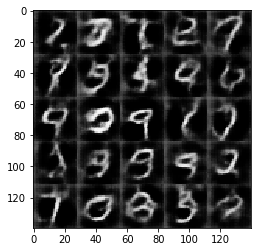

Epoch 2/2, batch 500... Discriminator Loss: 1.3023... Generator Loss: 0.7289


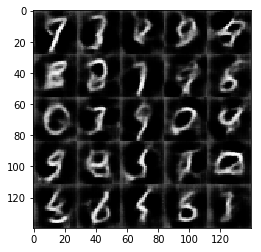

Epoch 2/2, batch 600... Discriminator Loss: 1.3386... Generator Loss: 1.2710


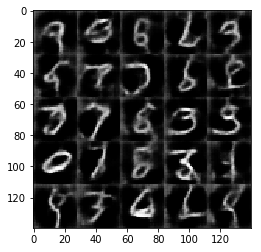

Epoch 2/2, batch 700... Discriminator Loss: 1.2953... Generator Loss: 0.6669


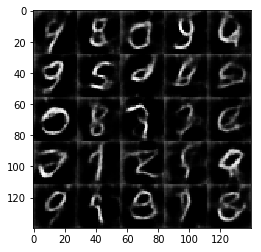

Epoch 2/2, batch 800... Discriminator Loss: 1.3342... Generator Loss: 1.1068


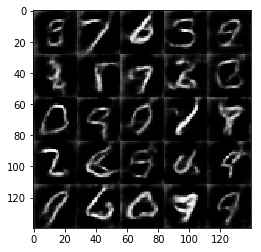

Epoch 2/2, batch 900... Discriminator Loss: 1.1765... Generator Loss: 1.2268
batch_size is 128, beta1 is 0.4, alpha is 0.2,learning_rate is 0.0001


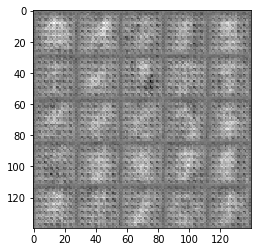

Epoch 1/2, batch 100... Discriminator Loss: 0.8736... Generator Loss: 0.9675


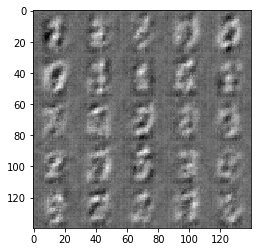

Epoch 1/2, batch 200... Discriminator Loss: 1.0472... Generator Loss: 0.9007


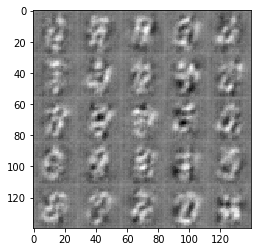

Epoch 1/2, batch 300... Discriminator Loss: 1.0941... Generator Loss: 0.6807


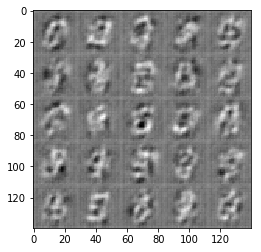

Epoch 1/2, batch 400... Discriminator Loss: 1.1164... Generator Loss: 0.6687


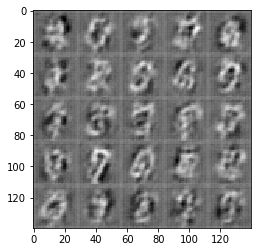

Epoch 2/2, batch 500... Discriminator Loss: 1.0068... Generator Loss: 0.8332


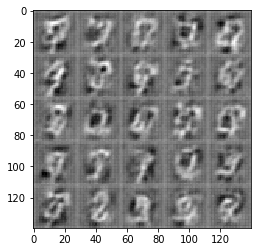

Epoch 2/2, batch 600... Discriminator Loss: 1.0210... Generator Loss: 0.7603


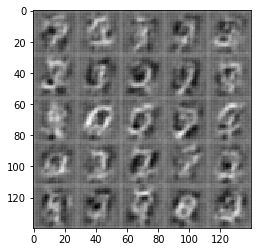

Epoch 2/2, batch 700... Discriminator Loss: 0.9930... Generator Loss: 0.8586


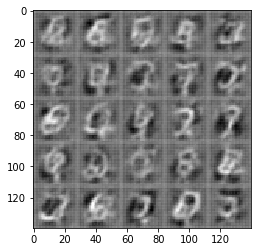

Epoch 2/2, batch 800... Discriminator Loss: 1.0234... Generator Loss: 1.1661


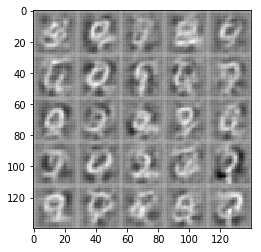

Epoch 2/2, batch 900... Discriminator Loss: 0.9769... Generator Loss: 0.7335
batch_size is 128, beta1 is 0.4, alpha is 0.2,learning_rate is 0.0005


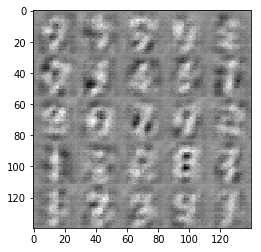

Epoch 1/2, batch 100... Discriminator Loss: 1.2729... Generator Loss: 1.4199


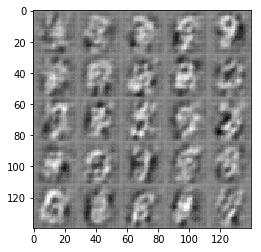

Epoch 1/2, batch 200... Discriminator Loss: 1.2551... Generator Loss: 1.2394


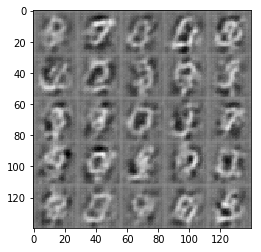

Epoch 1/2, batch 300... Discriminator Loss: 1.2028... Generator Loss: 1.0317


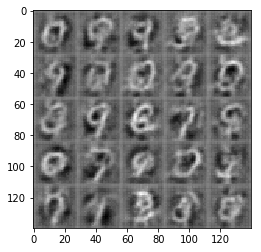

Epoch 1/2, batch 400... Discriminator Loss: 1.3323... Generator Loss: 0.4144


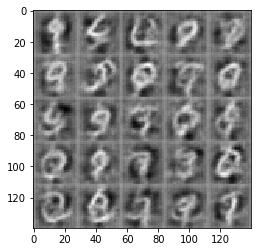

Epoch 2/2, batch 500... Discriminator Loss: 1.1841... Generator Loss: 0.5412


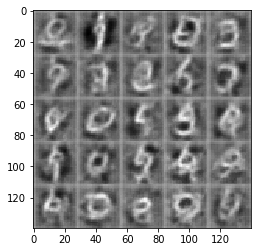

Epoch 2/2, batch 600... Discriminator Loss: 1.1846... Generator Loss: 1.2744


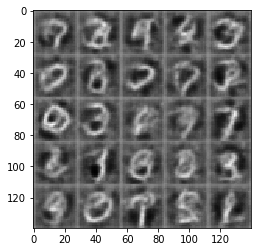

Epoch 2/2, batch 700... Discriminator Loss: 1.3222... Generator Loss: 1.3804


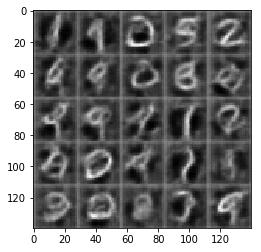

Epoch 2/2, batch 800... Discriminator Loss: 1.2605... Generator Loss: 0.7979


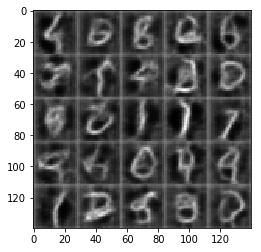

Epoch 2/2, batch 900... Discriminator Loss: 1.0538... Generator Loss: 0.7050
batch_size is 128, beta1 is 0.4, alpha is 0.2,learning_rate is 0.001


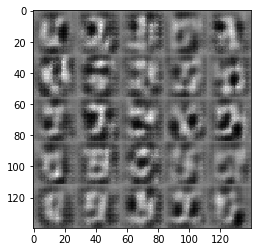

Epoch 1/2, batch 100... Discriminator Loss: 1.2308... Generator Loss: 1.1961


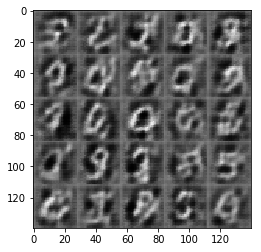

Epoch 1/2, batch 200... Discriminator Loss: 1.2933... Generator Loss: 0.5961


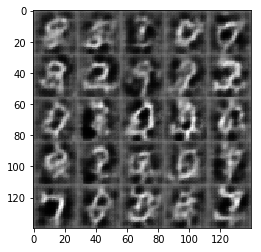

Epoch 1/2, batch 300... Discriminator Loss: 1.2702... Generator Loss: 0.8959


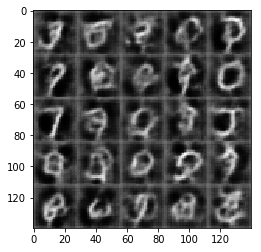

Epoch 1/2, batch 400... Discriminator Loss: 1.2113... Generator Loss: 0.6074


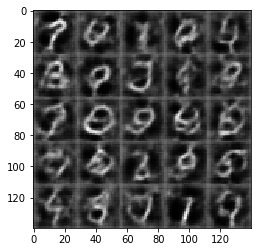

Epoch 2/2, batch 500... Discriminator Loss: 1.2546... Generator Loss: 0.9144


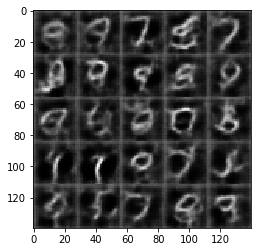

Epoch 2/2, batch 600... Discriminator Loss: 1.2274... Generator Loss: 0.6495


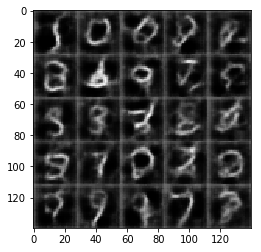

Epoch 2/2, batch 700... Discriminator Loss: 1.2449... Generator Loss: 0.7184


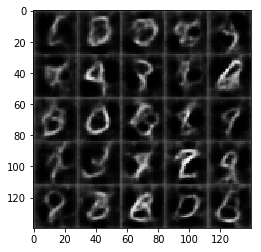

Epoch 2/2, batch 800... Discriminator Loss: 1.3017... Generator Loss: 0.6320


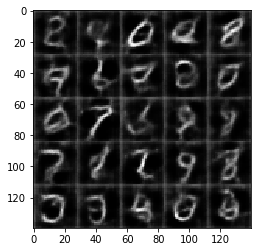

Epoch 2/2, batch 900... Discriminator Loss: 1.2216... Generator Loss: 1.0261
batch_size is 128, beta1 is 0.4, alpha is 0.2,learning_rate is 0.0015


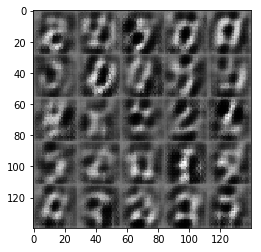

Epoch 1/2, batch 100... Discriminator Loss: 1.3681... Generator Loss: 2.2413


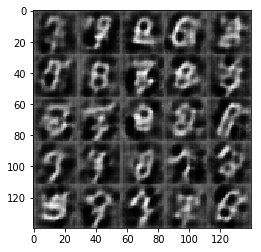

Epoch 1/2, batch 200... Discriminator Loss: 1.3806... Generator Loss: 1.3161


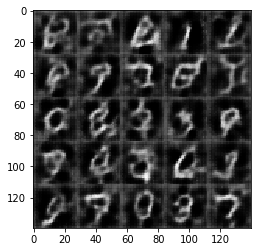

Epoch 1/2, batch 300... Discriminator Loss: 1.5858... Generator Loss: 1.6819


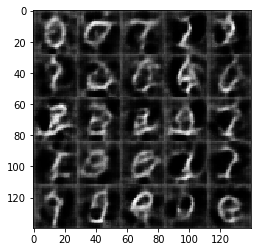

Epoch 1/2, batch 400... Discriminator Loss: 1.3082... Generator Loss: 0.5261


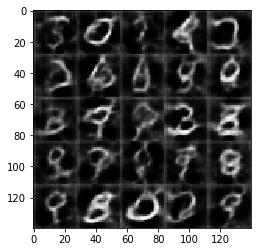

Epoch 2/2, batch 500... Discriminator Loss: 1.2564... Generator Loss: 0.9806


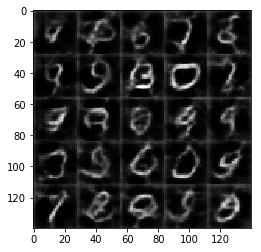

Epoch 2/2, batch 600... Discriminator Loss: 1.4021... Generator Loss: 1.1838


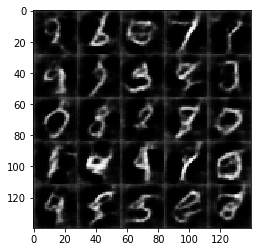

Epoch 2/2, batch 700... Discriminator Loss: 1.2579... Generator Loss: 0.5922


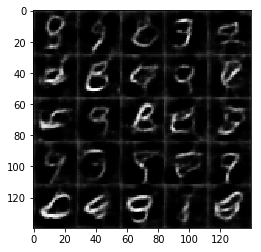

Epoch 2/2, batch 800... Discriminator Loss: 1.4387... Generator Loss: 1.4654


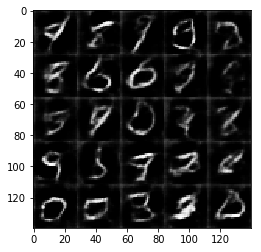

Epoch 2/2, batch 900... Discriminator Loss: 1.1173... Generator Loss: 0.8165
batch_size is 128, beta1 is 0.4, alpha is 0.2,learning_rate is 0.002


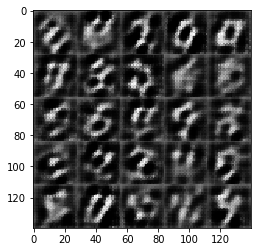

Epoch 1/2, batch 100... Discriminator Loss: 1.1745... Generator Loss: 1.1574


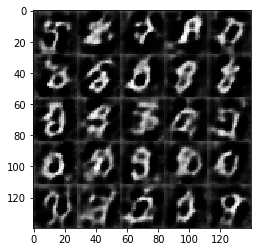

Epoch 1/2, batch 200... Discriminator Loss: 1.1234... Generator Loss: 0.8394


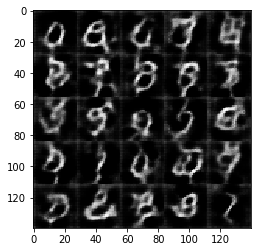

Epoch 1/2, batch 300... Discriminator Loss: 1.3846... Generator Loss: 0.4925


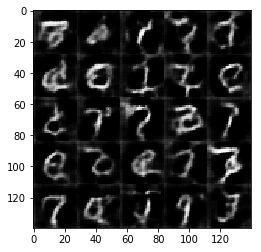

Epoch 1/2, batch 400... Discriminator Loss: 1.5299... Generator Loss: 0.3355


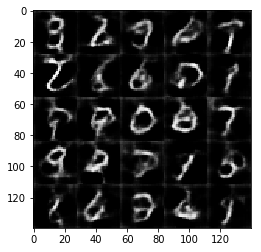

Epoch 2/2, batch 500... Discriminator Loss: 1.2145... Generator Loss: 0.9349


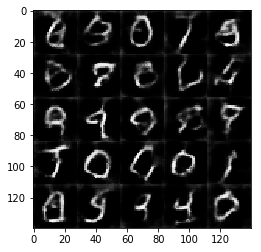

Epoch 2/2, batch 600... Discriminator Loss: 1.2050... Generator Loss: 0.7969


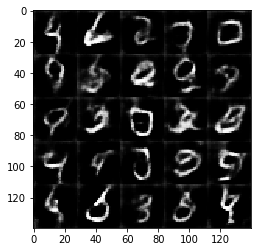

Epoch 2/2, batch 700... Discriminator Loss: 1.4848... Generator Loss: 0.3659


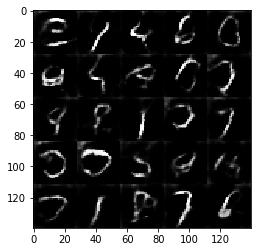

Epoch 2/2, batch 800... Discriminator Loss: 1.4255... Generator Loss: 0.8850


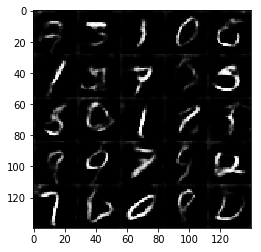

Epoch 2/2, batch 900... Discriminator Loss: 1.1283... Generator Loss: 0.8998


In [51]:
batches = [64,128]
z_dim = 104
learning_rates = [0.0001,0.0005, 0.001,0.0015, 0.002]
betas1 = [0.1,0.2,0.4]
alphas = [0.1,0.2]


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

for batch_size in batches:
    for beta1 in betas1:
        for alpha in alphas:
            for learning_rate in learning_rates:
                print("batch_size is {}, beta1 is {}, alpha is {},learning_rate is {}".format(batch_size,beta1,alpha,learning_rate))
                mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
                with tf.Graph().as_default():
                    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
                          mnist_dataset.shape, mnist_dataset.image_mode)

### Conclusions

**The best combinations are:**
- batch_size is 64, learning_rate is 0.0005, beta1 and alpha are 0.1-0.2,
- batch_size is 128, alpha is 0.1, learning_rate is 0.002, beta1 is 0.1-0.2

From this results we can conclude: 
- With batch =64 we have to prefer low lr (<=0.0005). 
- In the same time for the batch 128 we have to try lr>=0.002.
- For alpha and beta it would be good policy to keep them equal to 0.1

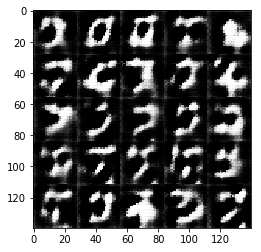

Epoch 1/2, batch 100... Discriminator Loss: 1.8266... Generator Loss: 2.3177


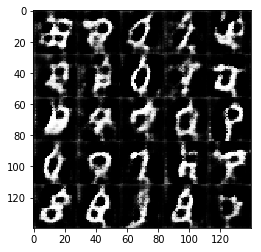

Epoch 1/2, batch 200... Discriminator Loss: 1.3096... Generator Loss: 1.1262


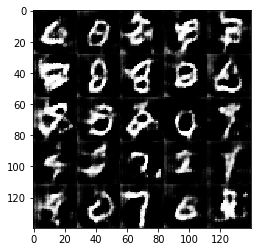

Epoch 1/2, batch 300... Discriminator Loss: 1.4354... Generator Loss: 0.3887


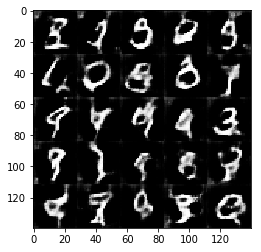

Epoch 1/2, batch 400... Discriminator Loss: 1.3928... Generator Loss: 1.1881


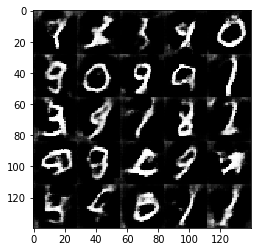

Epoch 2/2, batch 500... Discriminator Loss: 1.3474... Generator Loss: 0.5694


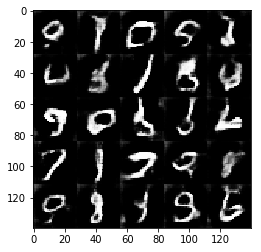

Epoch 2/2, batch 600... Discriminator Loss: 1.6387... Generator Loss: 0.2766


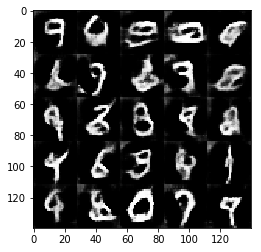

Epoch 2/2, batch 700... Discriminator Loss: 2.2636... Generator Loss: 0.1312


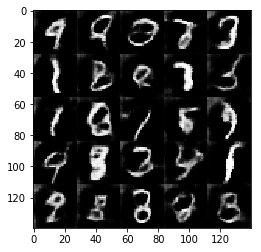

Epoch 2/2, batch 800... Discriminator Loss: 1.2300... Generator Loss: 1.2805


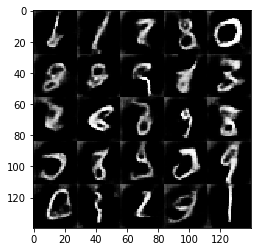

Epoch 2/2, batch 900... Discriminator Loss: 1.1583... Generator Loss: 0.8978


In [27]:
batch_size = 128
z_dim = 108
learning_rate = 0.003
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

### Try to obtain good results with batch 64 and small lr

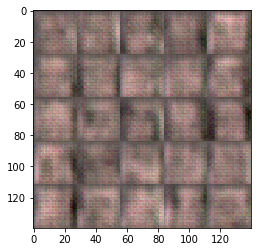

Epoch 1/1, batch 100... Discriminator Loss: 2.1540... Generator Loss: 0.1583


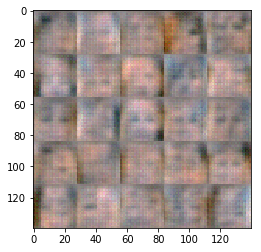

Epoch 1/1, batch 200... Discriminator Loss: 1.9475... Generator Loss: 0.1898


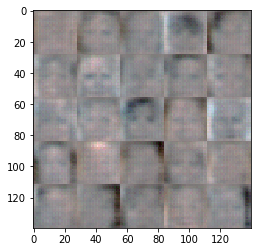

Epoch 1/1, batch 300... Discriminator Loss: 1.5105... Generator Loss: 0.3111


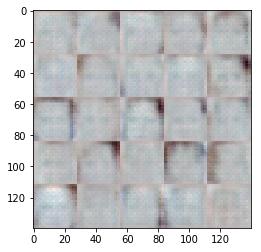

Epoch 1/1, batch 400... Discriminator Loss: 1.5796... Generator Loss: 0.3053


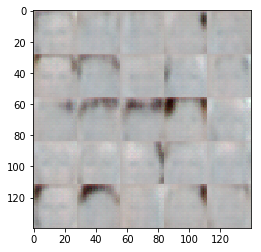

Epoch 1/1, batch 500... Discriminator Loss: 0.9978... Generator Loss: 0.5883


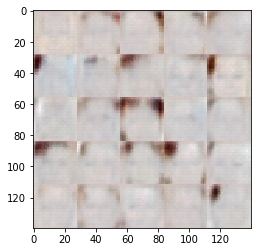

Epoch 1/1, batch 600... Discriminator Loss: 1.5757... Generator Loss: 2.2437


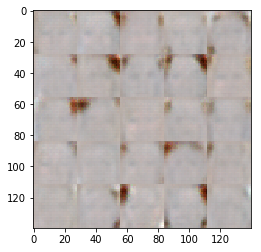

Epoch 1/1, batch 700... Discriminator Loss: 1.4906... Generator Loss: 0.8297


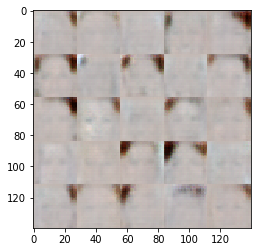

Epoch 1/1, batch 800... Discriminator Loss: 1.5908... Generator Loss: 1.3320


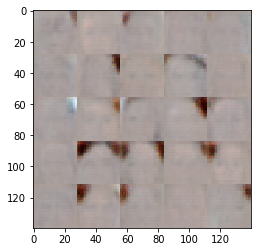

Epoch 1/1, batch 900... Discriminator Loss: 1.1566... Generator Loss: 0.8050


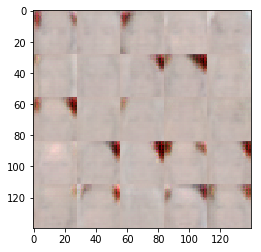

Epoch 1/1, batch 1000... Discriminator Loss: 0.5157... Generator Loss: 1.7942


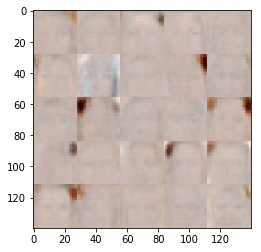

Epoch 1/1, batch 1100... Discriminator Loss: 1.8633... Generator Loss: 0.5631


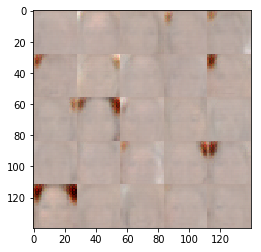

Epoch 1/1, batch 1200... Discriminator Loss: 1.3511... Generator Loss: 0.4349


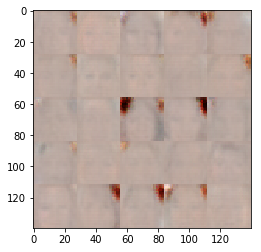

Epoch 1/1, batch 1300... Discriminator Loss: 1.7254... Generator Loss: 0.2711


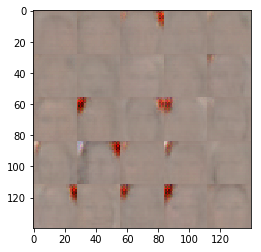

Epoch 1/1, batch 1400... Discriminator Loss: 0.6561... Generator Loss: 1.6299


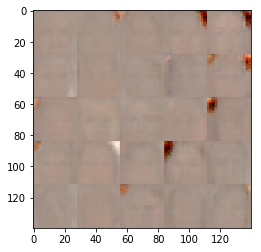

Epoch 1/1, batch 1500... Discriminator Loss: 1.7434... Generator Loss: 1.2805


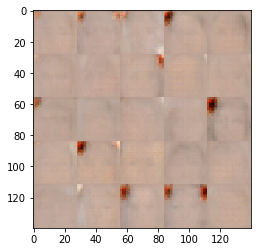

Epoch 1/1, batch 1600... Discriminator Loss: 1.2107... Generator Loss: 0.5430


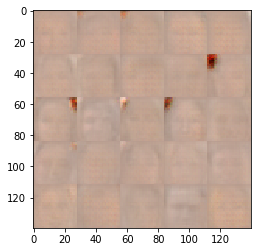

Epoch 1/1, batch 1700... Discriminator Loss: 1.6519... Generator Loss: 0.6411


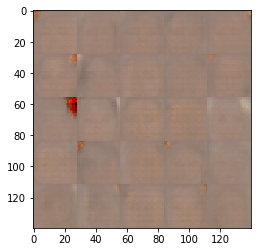

Epoch 1/1, batch 1800... Discriminator Loss: 1.5032... Generator Loss: 0.4312


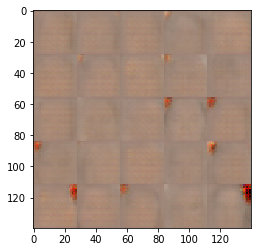

Epoch 1/1, batch 1900... Discriminator Loss: 1.4096... Generator Loss: 2.0505


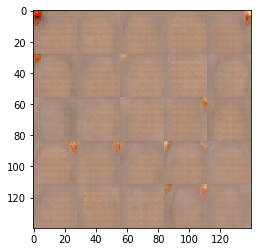

Epoch 1/1, batch 2000... Discriminator Loss: 1.7118... Generator Loss: 0.2769


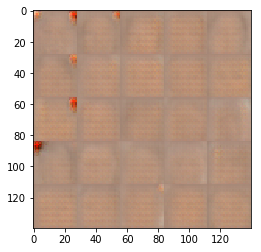

Epoch 1/1, batch 2100... Discriminator Loss: 1.1871... Generator Loss: 0.6359


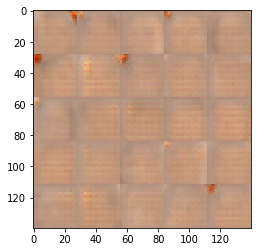

Epoch 1/1, batch 2200... Discriminator Loss: 1.4843... Generator Loss: 0.8362


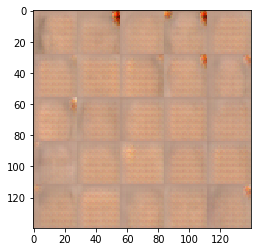

Epoch 1/1, batch 2300... Discriminator Loss: 1.4080... Generator Loss: 0.4076


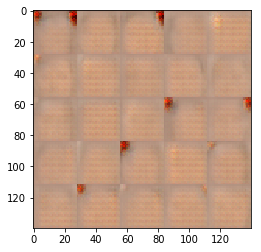

Epoch 1/1, batch 2400... Discriminator Loss: 1.1983... Generator Loss: 0.6276


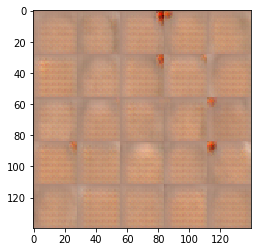

Epoch 1/1, batch 2500... Discriminator Loss: 1.2096... Generator Loss: 0.6205


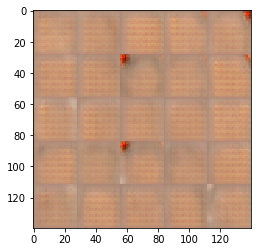

Epoch 1/1, batch 2600... Discriminator Loss: 1.6618... Generator Loss: 0.4306


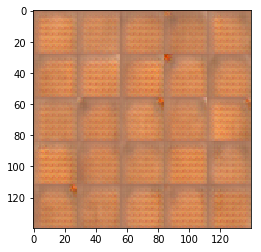

Epoch 1/1, batch 2700... Discriminator Loss: 1.7699... Generator Loss: 0.3221


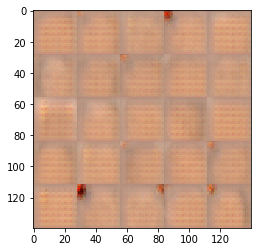

Epoch 1/1, batch 2800... Discriminator Loss: 1.7421... Generator Loss: 0.2736


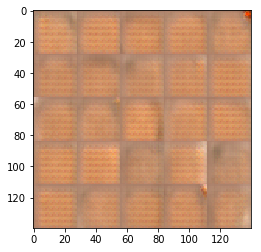

Epoch 1/1, batch 2900... Discriminator Loss: 1.5180... Generator Loss: 0.4152


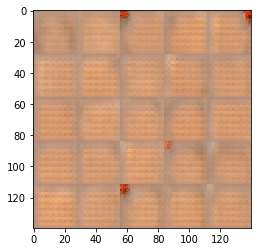

Epoch 1/1, batch 3000... Discriminator Loss: 1.5360... Generator Loss: 0.6381


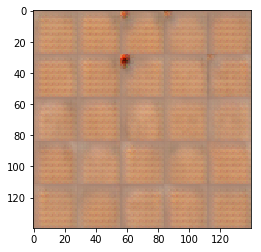

Epoch 1/1, batch 3100... Discriminator Loss: 1.5910... Generator Loss: 0.3605


In [ ]:
batch_size = 64
z_dim = 216 #increase z_dim to get more realistic faces
learning_rate = 5e-4

alpha = 0.1
beta1 = 0.1


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

**Not good result: Generator loss > Discriminator loss and not realistic image (it is possible that due to low lr we need to train GAN more than one epoch **

### Try to obtain good results with batch 128 and big lr

z_dims is 128, lr is 0.001


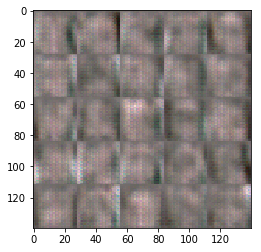

Epoch 1/1, batch 100... Discriminator Loss: 1.6311... Generator Loss: 0.3356


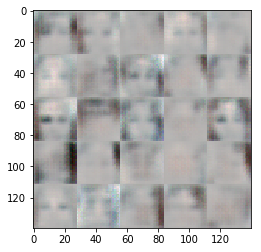

Epoch 1/1, batch 200... Discriminator Loss: 1.1546... Generator Loss: 0.5148


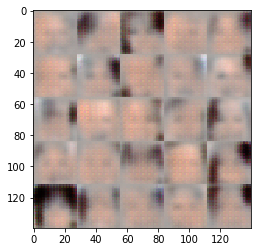

Epoch 1/1, batch 300... Discriminator Loss: 0.7568... Generator Loss: 2.9750


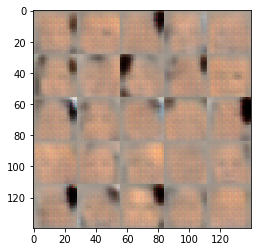

Epoch 1/1, batch 400... Discriminator Loss: 1.9573... Generator Loss: 0.2035


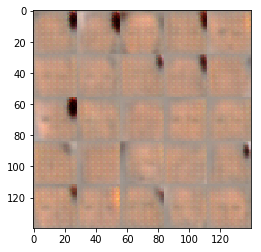

Epoch 1/1, batch 500... Discriminator Loss: 1.1401... Generator Loss: 0.6550


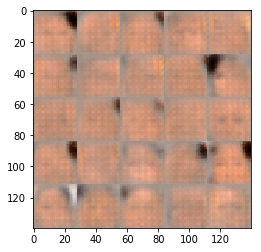

Epoch 1/1, batch 600... Discriminator Loss: 1.5535... Generator Loss: 0.3538


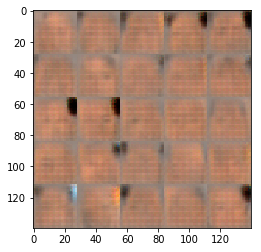

Epoch 1/1, batch 700... Discriminator Loss: 1.2862... Generator Loss: 1.0051


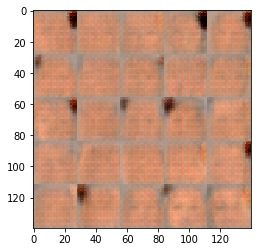

Epoch 1/1, batch 800... Discriminator Loss: 1.6268... Generator Loss: 0.4817


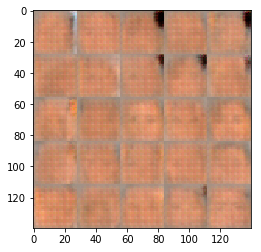

Epoch 1/1, batch 900... Discriminator Loss: 1.1094... Generator Loss: 0.9578


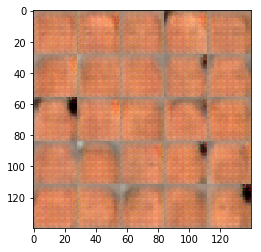

Epoch 1/1, batch 1000... Discriminator Loss: 1.1659... Generator Loss: 0.6647


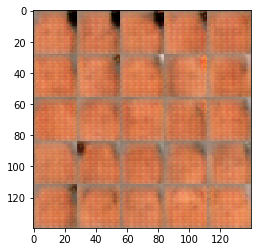

Epoch 1/1, batch 1100... Discriminator Loss: 0.6620... Generator Loss: 1.4104


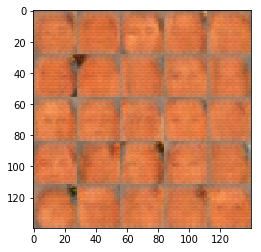

Epoch 1/1, batch 1200... Discriminator Loss: 1.9244... Generator Loss: 0.7190


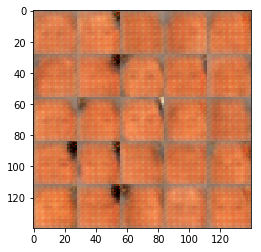

Epoch 1/1, batch 1300... Discriminator Loss: 1.2334... Generator Loss: 0.5410


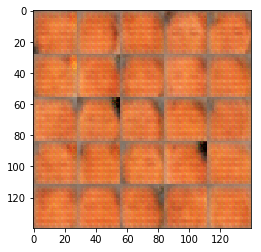

Epoch 1/1, batch 1400... Discriminator Loss: 1.0730... Generator Loss: 1.1040


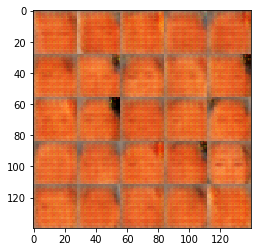

Epoch 1/1, batch 1500... Discriminator Loss: 1.4749... Generator Loss: 0.3930
z_dims is 128, lr is 0.002


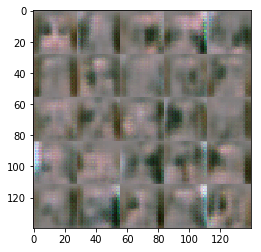

Epoch 1/1, batch 100... Discriminator Loss: 1.6497... Generator Loss: 0.2856


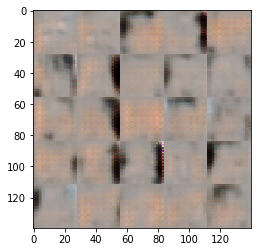

Epoch 1/1, batch 200... Discriminator Loss: 1.2000... Generator Loss: 1.0714


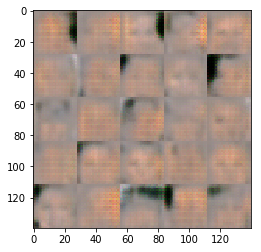

Epoch 1/1, batch 300... Discriminator Loss: 1.1634... Generator Loss: 0.6986


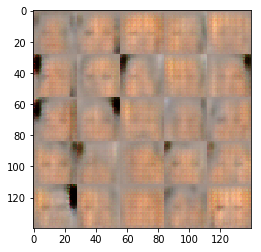

Epoch 1/1, batch 400... Discriminator Loss: 1.5261... Generator Loss: 0.3661


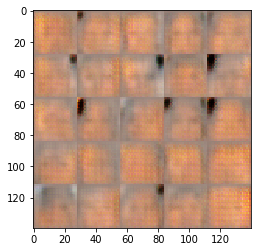

Epoch 1/1, batch 500... Discriminator Loss: 1.1669... Generator Loss: 1.0028


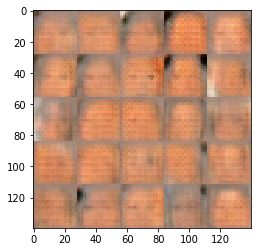

Epoch 1/1, batch 600... Discriminator Loss: 1.6541... Generator Loss: 1.0440


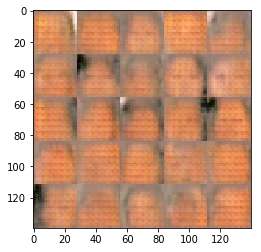

Epoch 1/1, batch 700... Discriminator Loss: 1.5359... Generator Loss: 0.4001


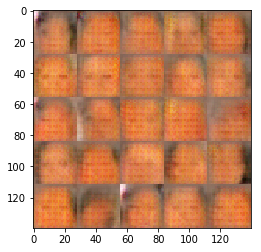

Epoch 1/1, batch 800... Discriminator Loss: 1.4979... Generator Loss: 0.4946


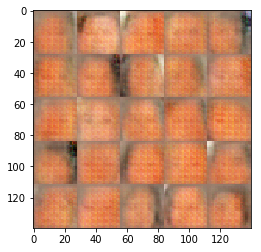

Epoch 1/1, batch 900... Discriminator Loss: 1.3687... Generator Loss: 0.6194


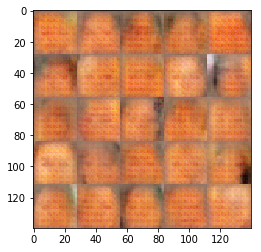

Epoch 1/1, batch 1000... Discriminator Loss: 1.3679... Generator Loss: 0.8448


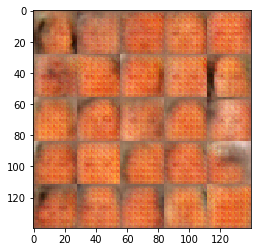

Epoch 1/1, batch 1100... Discriminator Loss: 1.5882... Generator Loss: 0.5473


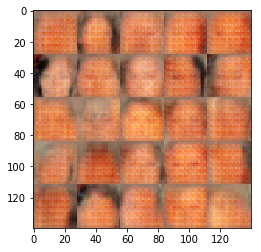

Epoch 1/1, batch 1200... Discriminator Loss: 1.4427... Generator Loss: 0.5683


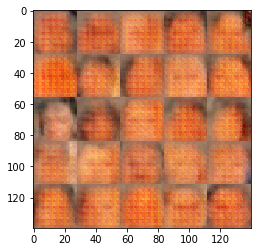

Epoch 1/1, batch 1300... Discriminator Loss: 1.3826... Generator Loss: 0.5182


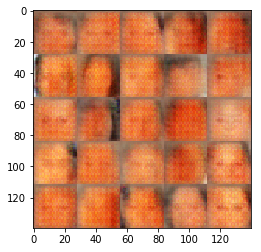

Epoch 1/1, batch 1400... Discriminator Loss: 1.4102... Generator Loss: 0.5432


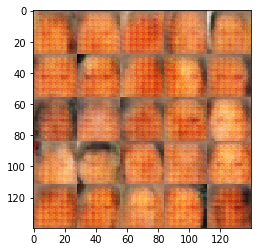

Epoch 1/1, batch 1500... Discriminator Loss: 1.5367... Generator Loss: 0.6367
z_dims is 128, lr is 0.003


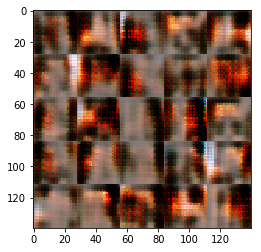

Epoch 1/1, batch 100... Discriminator Loss: 1.2661... Generator Loss: 0.9443


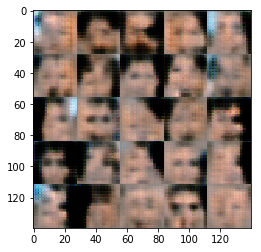

Epoch 1/1, batch 200... Discriminator Loss: 2.2262... Generator Loss: 0.1446


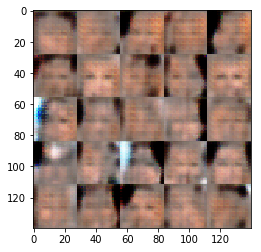

Epoch 1/1, batch 300... Discriminator Loss: 2.0593... Generator Loss: 0.1767


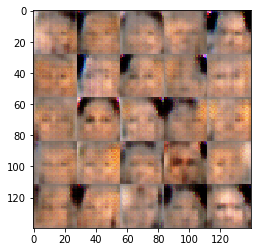

Epoch 1/1, batch 400... Discriminator Loss: 1.4465... Generator Loss: 0.6607


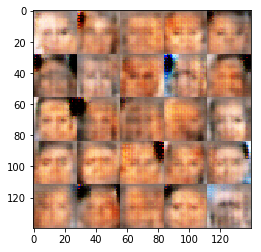

Epoch 1/1, batch 500... Discriminator Loss: 1.4374... Generator Loss: 0.5078


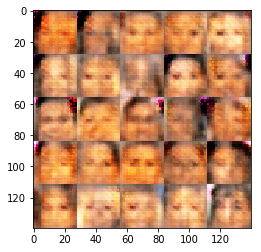

Epoch 1/1, batch 600... Discriminator Loss: 1.3970... Generator Loss: 0.7915


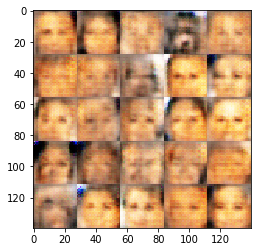

Epoch 1/1, batch 700... Discriminator Loss: 1.3547... Generator Loss: 0.8315


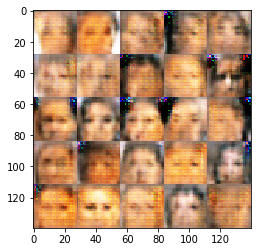

Epoch 1/1, batch 800... Discriminator Loss: 1.3194... Generator Loss: 0.6887


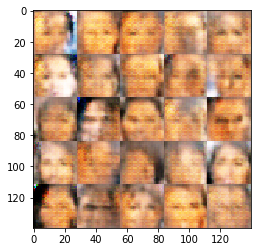

Epoch 1/1, batch 900... Discriminator Loss: 1.3357... Generator Loss: 0.5852


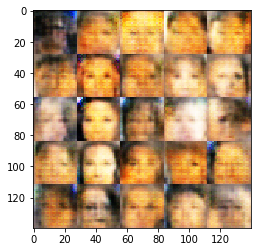

Epoch 1/1, batch 1000... Discriminator Loss: 1.3839... Generator Loss: 0.7570


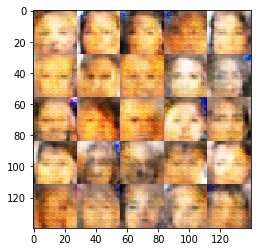

Epoch 1/1, batch 1100... Discriminator Loss: 1.3932... Generator Loss: 0.8408


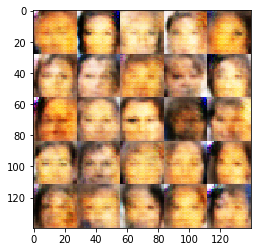

Epoch 1/1, batch 1200... Discriminator Loss: 1.3800... Generator Loss: 0.6134


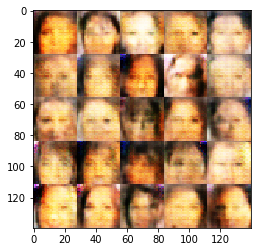

Epoch 1/1, batch 1300... Discriminator Loss: 1.3877... Generator Loss: 0.5837


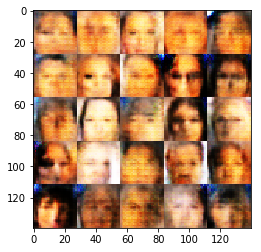

Epoch 1/1, batch 1400... Discriminator Loss: 1.3779... Generator Loss: 0.7224


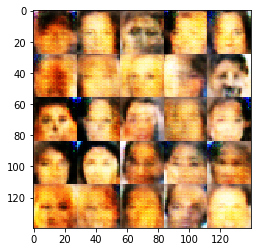

Epoch 1/1, batch 1500... Discriminator Loss: 1.3570... Generator Loss: 0.6124
z_dims is 128, lr is 0.005


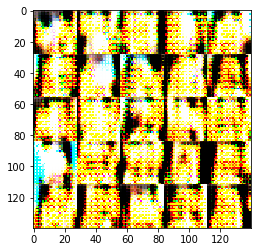

Epoch 1/1, batch 100... Discriminator Loss: 1.8876... Generator Loss: 4.1114


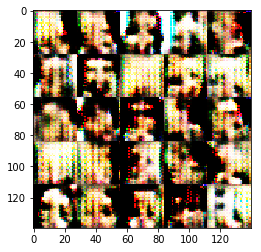

Epoch 1/1, batch 200... Discriminator Loss: 1.2775... Generator Loss: 0.5343


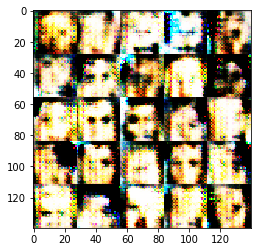

Epoch 1/1, batch 300... Discriminator Loss: 1.3507... Generator Loss: 0.6268


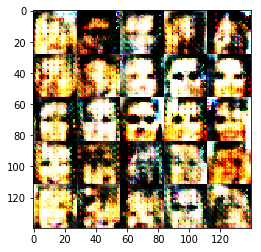

Epoch 1/1, batch 400... Discriminator Loss: 1.4443... Generator Loss: 0.6138


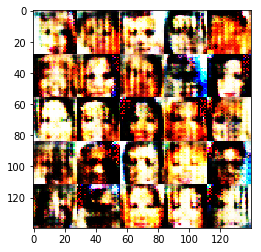

Epoch 1/1, batch 500... Discriminator Loss: 1.3671... Generator Loss: 0.7184


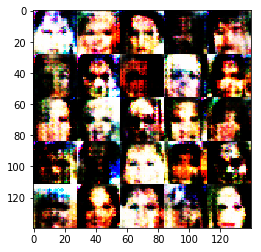

Epoch 1/1, batch 600... Discriminator Loss: 1.2660... Generator Loss: 0.7353


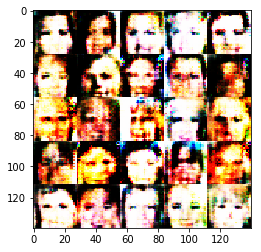

Epoch 1/1, batch 700... Discriminator Loss: 1.4763... Generator Loss: 0.6538


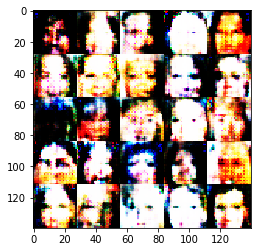

Epoch 1/1, batch 800... Discriminator Loss: 1.1836... Generator Loss: 0.7232


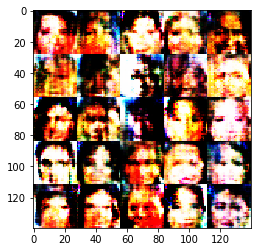

Epoch 1/1, batch 900... Discriminator Loss: 1.3899... Generator Loss: 0.5546


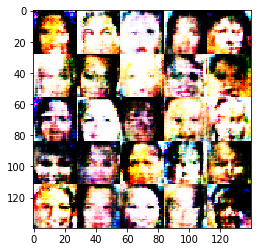

Epoch 1/1, batch 1000... Discriminator Loss: 1.3888... Generator Loss: 0.7025


In [ ]:
batch_size = 128
z_dims = [128,256] #increase z_dim to get more realistic faces
learning_rates = [0.001, 0.002,0.003,0.005]

alpha = 0.1
beta1 = 0.1


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

for z_dim in z_dims:
    for learning_rate in learning_rates:
        print("z_dims is {}, lr is {}".format(z_dim,learning_rate))
        celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
        with tf.Graph().as_default():
            train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
                  celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.